In [97]:
from collections import deque
from datetime import timedelta
from rtree.index import Index as RTreeIndex
from shapely.geometry import LineString
from shapely.geometry import MultiLineString
from shapely.geometry import Point
from tqdm import tqdm
import datetime
import geopandas as gpd
import matplotlib
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import osmnx as ox
import pandas as pd
import time

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
CRS_PLOT = 'EPSG:4326'
DATA_DIR = '../data'
EXPORTS_DIR = f'{DATA_DIR}/exports'

In [60]:
class RouteNode:
    def __init__(self, i=0, id=0, node=None):
        self.i = i
        self.id = id
        self.node = node
        self.next_node = None
        self.x = node['x']
        self.y = node['y']
        self.t = 0
        self.st = 0
        
    def set_next_node(self, next_node):
        self.next_node = next_node
        self.distance_to_next =ox.distance.euclidean_dist_vec(self.y, self.x, next_node.y, next_node.x)

class Stop:
    def __init__(self, id=0, x=0, y=0, t=0):
        self.id = id
        self.x = x
        self.y = y
        self.t = t
        self.st = 0
        
        self.edge = nearest_edges(analysis.rg_rtree, analysis.rg_geoms, [self.x], [self.y])[0]
        
        self.prev_node_id = self.edge[0]
        self.next_node_id = self.edge[1]
        self.prev_node_index = analysis.route_node_ids.index(self.prev_node_id)
        try:
            self.next_node_index = analysis.route_node_ids.index(self.next_node_id, self.prev_node_index)
        except ValueError:
            self.next_node_index = analysis.route_node_ids.index(self.next_node_id)
        
        self.prev_node = analysis.route_graph.nodes[self.prev_node_id]
        self.next_node = analysis.route_graph.nodes[self.next_node_id]
        
        route_point = snap_to_edge([x, y], [[self.prev_node['x'], self.prev_node['y']], [self.next_node['x'], self.next_node['y']]])
        self.rx = route_point[0]
        self.ry = route_point[1]
        
        self.prev_node_dist = ox.distance.euclidean_dist_vec(self.ry, self.rx, self.prev_node['y'], self.prev_node['x'])
        self.next_node_dist = ox.distance.euclidean_dist_vec(self.ry, self.rx, self.next_node['y'], self.next_node['x'])
        
    def get_nearest_edge(self):
        edge = nearest_edges(analysis.rg_rtree, analysis.rg_geoms, analysis.route_gdf['stop_lon'], analysis.route_gdf['stop_lat'])
        
class TrajectoryPoint(Stop):
    def __init__(self, i=0, x=0, y=0, t=0):
        super().__init__(i, x, y, t)
        
        next_node_t = analysis.route_nodes[self.next_node_index].t
        prev_node_t = analysis.route_nodes[self.prev_node_index].t
        
        if next_node_t == 0:
            self.t_expected = None
        elif prev_node_t == 0:
            self.t_expected = None
        else:
            next_node_t -= datetime.timedelta(days=51)
            prev_node_t -= datetime.timedelta(days=51)
            self.t_expected = (self.prev_node_dist / (self.prev_node_dist + self.next_node_dist)) * (next_node_t - prev_node_t) + prev_node_t

In [61]:
def get_trajectories_dict(b_gdf, d0, d1):
    trajectories = []
    curr_bus_id = None
    curr_x = None
    curr_trajectory = []
    LENGTH_THRESHOLD = 10
    trajectories_dict = {}
    
    for i in range(0, len(b_gdf)):
        row = b_gdf.iloc[i]
        lat = row['latitude']
        lon = row['longitude']
        time = row['datetime']
        bus_id = row['bus_id']

        if curr_x == None and curr_bus_id == None:
            curr_x = row['x']
            curr_bus_id = row['bus_id']
            if curr_x == d0:
                curr_trajectory.append((lon, lat, time))
        elif row['bus_id'] == curr_bus_id:
            if row['x'] == curr_x:
                if row['x'] == d0:
                    curr_trajectory.append((lon, lat, time))
            else:
                # Ignore accidental swap x=0, x=1
                if row['x'] == d1 and i + 1 < len(b_gdf) and b_gdf.iloc[i + 1]['x'] == d1:
                    if len(curr_trajectory) > LENGTH_THRESHOLD:
                        if bus_id not in trajectories_dict:
                            trajectories_dict[bus_id] = []
                        trajectories_dict[bus_id].append(curr_trajectory)
                    curr_trajectory = []
                # Ignore accidental swap x=0, x=1
                if not (row['x'] == d1 and i + 1 < len(b_gdf) and b_gdf.iloc[i + 1]['x'] == d1):
                    curr_x = row['x']
        else:
            if len(curr_trajectory) > LENGTH_THRESHOLD:
                if bus_id not in trajectories_dict:
                    trajectories_dict[bus_id] = []
                trajectories_dict[bus_id].append(curr_trajectory)
            curr_trajectory = []
            curr_bus_id = row['bus_id']
            curr_x = row['x']
            if curr_x == d0:
                curr_trajectory.append((lon, lat, time))
    if len(curr_trajectory) > LENGTH_THRESHOLD:
        if bus_id not in trajectories_dict:
            trajectories_dict[bus_id] = []
        trajectories_dict[bus_id].append(curr_trajectory)
    return trajectories_dict

In [62]:
def k_nearest_edges(rtree, geoms, x, y, k=3):
    # use r-tree to find possible nearest neighbors, one point at a time,
    # then minimize euclidean distance from point to the possible matches
    xy = (x, y)
    dists = geoms.iloc[list(rtree.nearest(xy))].distance(Point(xy))
    dists_df = pd.DataFrame([a[0][0:2] + (a[1],) for a in zip(dists.index, dists)], columns=['u', 'v', 'dist'])
    return dists_df.nsmallest(k, 'dist', keep='first').reset_index(drop=True)

def nearest_edges(rtree, geoms, X, Y):
    is_scalar = False
    if not (hasattr(X, "__iter__") and hasattr(Y, "__iter__")):
        # make coordinates arrays if user passed non-iterable values
        is_scalar = True
        X = np.array([X])
        Y = np.array([Y])

    if np.isnan(X).any() or np.isnan(Y).any():  # pragma: no cover
        raise ValueError("`X` and `Y` cannot contain nulls")

    # use r-tree to find possible nearest neighbors, one point at a time,
    # then minimize euclidean distance from point to the possible matches
    ne_dist = list()
    for xy in zip(X, Y):
        dists = geoms.iloc[list(rtree.nearest(xy))].distance(Point(xy))
        ne_dist.append((dists.idxmin(), dists.min()))
    ne, dist = zip(*ne_dist)

    # convert results to correct types for return
    ne = list(ne)
    dist = list(dist)
    if is_scalar:
        ne = ne[0]
        dist = dist[0]

    return ne
    
def snap_to_edge(point, edge):
    u = edge[0]
    v = edge[1]
    ux = float(u[0])
    uy = float(u[1])
    vx = float(v[0])
    vy = float(v[1])
    px = point[0]
    py = point[1]
    
    m1 = (vy - uy) / (vx - ux)
    m3 = -1.0 / m1
    x = (m1 * ux - m3 * px - uy + py) / (m1 - m3)
    y = m1 * (x - ux) + uy
    return [x, y]

In [187]:
timedt = datetime.datetime.date(datetime.datetime(2021, 7, 12)) - datetime.datetime.date(datetime.datetime(1900, 1, 1))
fd = datetime.datetime(1900, 1, 1)

In [142]:
def calculate_time_diff(matched_df, start, end):
    # Returns the actual time row minus the expected time row using diff(1).
    # Positive values are late arrivals.
    # Negative value are early arrivals.
    return matched_df.applymap(dt_string_to_seconds).diff(1).iloc[1, :]

def dt_string_to_seconds(dt_string):
    if dt_string is None:
        return np.nan
    hours = int(dt_string[0:2])
    minutes = int(dt_string[3:5])
    seconds = int(dt_string[6:8])
    return hours * 24 * 60 + minutes * 60 + seconds

def to_datetime(dt):
    if dt is None:
        return None
    if type(dt) is not str:
        return None
    if dt[0:2] == '24':
        dt2 = pd.to_datetime('00' + dt[2:], format='%H:%M:%S') + timedelta(days=1)
    else:
        dt2 = pd.to_datetime(dt, format='%H:%M:%S')
    return dt2

In [146]:
def calculate_route_node_expected_times(stops):
    for route_node in analysis.route_nodes:
        route_node.t = 0
        
    for k in range(0, len(stops) - 1):
        stop = stops[k] 
        stop.next_node_index
        next_stop = stops[k + 1]
        next_stop.prev_node_index

        total_dist = stop.next_node_dist
        for i in range(stop.next_node_index, next_stop.prev_node_index + 1):
            total_dist += analysis.route_nodes[i].distance_to_next
        total_dist += next_stop.prev_node_dist
        t0 = stop.t
        t1 = next_stop.t

        for i in range(stop.next_node_index, next_stop.prev_node_index + 1):
            node_dist = 0
            for j in range(i, next_stop.prev_node_index + 1):
                node_dist += analysis.route_nodes[j].distance_to_next
            node_dist += next_stop.prev_node_dist

            ratio = (total_dist - node_dist) / total_dist
            analysis.route_nodes[i].t = (t1 - t0) * ratio + t0
            
def calculate_stop_actual_times(trajectory_points):
    # Calculate the actual time at each stop based on the trajectory times.
    for stop in analysis.stops:
        stop.st = 0
    for k in range(0, len(analysis.stops) - 1):
        stop = analysis.stops[k]
        stop_prev_node = analysis.route_nodes[stop.prev_node_index]
        stop_next_node = analysis.route_nodes[stop.next_node_index]
        if stop_prev_node.st != 0 and stop_next_node.st != 0:
            ratio = stop.prev_node_dist / (stop.prev_node_dist + stop.next_node_dist)
            t0 = stop_prev_node.st
            t1 = stop_next_node.st
            stop.st = (t1 - t0) * ratio + t0
            
def calculate_route_node_actual_times(trajectory_points):
    # Calculate the actual time at each route node based on the trajectory times.
    for route_node in analysis.route_nodes:
        route_node.st = 0
        
    for k in range(0, len(trajectory_points) - 1):
        trajectory_point = trajectory_points[k] 
        trajectory_point.next_node_index
        next_trajectory_point = trajectory_points[k + 1]
        next_trajectory_point.prev_node_index

        total_dist = trajectory_point.next_node_dist
        for i in range(trajectory_point.next_node_index, next_trajectory_point.prev_node_index + 1):
            total_dist += analysis.route_nodes[i].distance_to_next
        total_dist += next_trajectory_point.prev_node_dist
        t0 = trajectory_point.t
        t1 = next_trajectory_point.t

        for i in range(trajectory_point.next_node_index, next_trajectory_point.prev_node_index + 1):
            node_dist = 0
            for j in range(i, next_trajectory_point.prev_node_index + 1):
                node_dist += analysis.route_nodes[j].distance_to_next
            node_dist += next_trajectory_point.prev_node_dist

            ratio = (total_dist - node_dist) / total_dist
            analysis.route_nodes[i].st = (t1 - t0) * ratio + t0
            
def find_closest_schedule():
    columns = list(analysis.stops_gdf['stop_id'])
    route_actual_times = pd.DataFrame(
        {
            column: [stop.st.strftime('%H:%M:%S') if stop.st != 0 else None]
            for (column, stop) in zip(columns, analysis.stops)
        },
        columns=columns)
    
    first_non_null_col = route_actual_times.iloc[0].first_valid_index()
    last_non_null_col = route_actual_times.iloc[0].last_valid_index()
    if first_non_null_col is None or last_non_null_col is None:
        return ((0, 0), None)
    start_index = list(route_actual_times.columns).index(first_non_null_col)
    end_index = list(route_actual_times.columns).index(last_non_null_col)
    if start_index == end_index:
        return ((start_index, end_index), None)
    
    # 0 column is trip_id
    if start_index == 0:
        start_index = 1
    start_col = route_actual_times.columns[start_index]
    actual_start_time = to_datetime(route_actual_times[start_col].iloc[0])
    
    if actual_start_time == None:
        return ((start_index, end_index), None)

    end_col = route_actual_times.columns[end_index]
    actual_end_time = to_datetime(route_actual_times[end_col].iloc[0])
    
    if actual_end_time == None:
        return ((start_index, end_index), None)
    
    stop_diffs_df = analysis.stop_times_df.copy()[['trip_id', str(start_col)]]
    stop_diffs_df[str(start_col)] = stop_diffs_df[str(start_col)].apply(to_datetime)
    stop_diffs_df['diff'] = stop_diffs_df[str(start_col)] - actual_start_time
    threshold = 5
    matching_df = stop_diffs_df[
        (stop_diffs_df['diff'] < timedelta(minutes=5)) &
        (stop_diffs_df['diff'] > timedelta(minutes=-20))]
    matching_trips = list(matching_df['trip_id'])
    
    matching_dfs = [analysis.stop_times_df[analysis.stop_times_df['trip_id'] == t] for t in matching_trips]

    return ((start_index, end_index), matching_dfs)

In [65]:
def dedup_consecutive(a):
    b = []
    last = None
    for i in range(0, len(a)):
        c = a[i]
        if c != last:
            last = c
            b.append(c)
    return b

In [66]:
def get_geoms(G):
    return ox.utils_graph.graph_to_gdfs(G, nodes=False)['geometry']

def get_rtree(G, geoms):
    # build the r-tree spatial index by position for subsequent iloc
    rtree = RTreeIndex()
    for pos, bounds in enumerate(geoms.bounds.values):
        rtree.insert(pos, bounds)
    return rtree

In [67]:
def plot(trajectory_points):
    fig, ax = plt.subplots(figsize=(40, 30))
    ox.plot_graph(analysis.route_graph, ax=ax, bgcolor=None, node_size=10, node_color='black', show=False, close=False)

    X = [analysis.route_graph.nodes[n]['x'] for n in analysis.route_node_ids]
    Y = [analysis.route_graph.nodes[n]['y'] for n in analysis.route_node_ids]
    ax.scatter(X, Y, color='black')
    
    for i in range(0, len(analysis.route_nodes)):
        x = X[i]
        y = Y[i]
        k = 1 if i % 2 == 0 else -4
        route_node = analysis.route_nodes[i]
        if route_node.st != None and route_node.st != 0:
            ax.annotate(route_node.st.strftime('%H:%M'), (x, y),
                       xytext=(0, 20 * k), textcoords='offset pixels', rotation=45, ha='center', color='black')

    X = [t.rx for t in analysis.stops]
    Y = [t.ry for t in analysis.stops]
    ax.scatter(X, Y, color='red')

    for i in range(0, len(analysis.stops)):
        x = X[i]
        y = Y[i]
        k = 1 if i % 2 == 0 else -4
        stop = analysis.stops[i]
        if stop.st != None and stop.st != 0:
            ax.annotate(stop.st.strftime('%H:%M'), (x, y),
                       xytext=(0, 20 * k), textcoords='offset pixels', rotation=45, ha='center', color='red')

    X = [t.rx for t in trajectory_points]
    Y = [t.ry for t in trajectory_points]
    ax.scatter(X, Y, color='blue')

    for i in range(0, len(trajectory_points)):
        x = X[i]
        y = Y[i]
        k = 1 if i % 2 == 0 else -4
        tp = trajectory_points[i]
        if tp.t != 0:
            ax.annotate(tp.t.strftime('%H:%M'), (x, y),
                       xytext=(0, 20 * k), textcoords='offset pixels', rotation=45, ha='center', color='blue')

    plt.show()

In [68]:
bk = ox.io.load_graphml('bk.graphml')
bk_geoms = get_geoms(bk)
bk_rtree = get_rtree(bk, bk_geoms)

In [93]:
def load_data(route):
    analysis.trajectories_df = pd.read_csv(f'{EXPORTS_DIR}/trajectories/{route}_20210712_trajectories.csv')
    analysis.route_graph = ox.io.load_graphml(f'{EXPORTS_DIR}/graphml/{route}.graphml')
    analysis.rg_geoms = get_geoms(analysis.route_graph)
    analysis.rg_rtree = get_rtree(analysis.route_graph, analysis.rg_geoms)
    analysis.stops_gdf = gpd.read_file(f'{EXPORTS_DIR}/stops/{route}_stops.shp').iloc[0:]
    display(analysis.stops_gdf.head())
    display(analysis.stops_gdf.tail())
    analysis.stop_times_df = pd.read_csv(f'{EXPORTS_DIR}/stop_times/{route}_weekday_stop_times.csv')
    display(analysis.stop_times_df.head())
    route_node_ids_df = pd.read_csv(f'{EXPORTS_DIR}/route_nodes/{route}_route_nodes.csv')
    analysis.route_node_ids = route_node_ids_df.iloc[:, 0].tolist()

In [70]:
def plot_stops():
    fig, ax = plt.subplots(figsize=(40, 30))
    ox.plot_graph(bk, ax=ax, bgcolor='#444', node_size=0, show=False, close=False, edge_color='#333')
    ox.plot_graph(analysis.route_graph, ax=ax, bgcolor='#444', node_size=0, show=False, close=False, edge_color='#ccc', edge_linewidth=5)
    analysis.stops_gdf.plot(ax=ax)
    ax.set_facecolor('#444')

In [71]:
def create_route_nodes():
    route_nodes = []

    for i in range(0, len(analysis.route_node_ids)):
        id = analysis.route_node_ids[i]
        route_nodes.append(RouteNode(i, id, analysis.route_graph.nodes[id]))

    for i in range(0, len(analysis.route_node_ids) - 1):
        route_nodes[i].set_next_node(route_nodes[i + 1])
        
    analysis.route_nodes = route_nodes

In [72]:
def create_stops():
    stops = []
    stop_dict = {}
    for i in range(0, len(analysis.stops_gdf)):
        row = analysis.stops_gdf.iloc[i]
        stop = Stop(id=int(row['stop_id']), x=row['stop_lon'], y=row['stop_lat'], t=0)#row['departure_'])
        stops.append(stop)
        stop_dict[stop.id] = stop
    analysis.stops = stops
    analysis.stop_dict = stop_dict

In [73]:
def plot_interpolation():
    tx = list(analysis.trajectories_dict.values())[0][0]
    tps = [
        TrajectoryPoint(i=0,
                        x=x,
                        y=y,
                        t=datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S'))
        for (x, y, t) in tx
    ]
    calculate_route_node_actual_times(tps)
    calculate_stop_actual_times(tps)
    plot(tps)
    analysis.tps = tps

In [208]:
def match_to_timetable():
    diff_rows = []
    ij = 0
    for bus_id, trajectories in tqdm(list(analysis.trajectories_dict.items())):
        if ij > 10 and len(diff_rows) == 0:
            print('fail')
            return None
        ij += 1
        for trajectory in trajectories:
            if len(trajectory) < 10:
                continue
            trajectory_points = [
                TrajectoryPoint(i=0,
                                x=x,
                                y=y,
                                t=datetime.datetime.strptime(
                                    t, '%Y-%m-%d %H:%M:%S'))
                for (x, y, t) in trajectory
            ]
            calculate_route_node_actual_times(trajectory_points)
            calculate_stop_actual_times(trajectory_points)
            (index_range, matched_dfs) = find_closest_schedule()
            (start_index, end_index) = index_range

            if matched_dfs is not None:
                min_diff_df = None
                min_stop_diff_df = None
                min_diff_sum = 2**16
                min_trip_id = None
                invalid = False
                for matched_df in matched_dfs:
                    expected_stops = []

                    for i in range(start_index, end_index):
                        if matched_df.columns[i] == 'trip_id':
                            invalid = True
                            break
                        matching_stop = analysis.stop_dict[int(matched_df.columns[i])]
                        x = matching_stop.x
                        y = matching_stop.y
                        matched_df.iloc[0, i] = to_datetime(matched_df.iloc[0, i])
                        t = pd.to_datetime(matched_df.iloc[0, i])
                        expected_stop = Stop(id=matching_stop.id, x=x, y=y, t=t)
                        expected_stops.append(expected_stop)
                        
                    expected_stop_ids = set([s.id for s in expected_stops])
                        
                    if invalid:
                        print(f'No Match Error at {bus_id}')
                        continue

                    try:
                        calculate_route_node_expected_times(expected_stops)
                    except TypeError:
                        print(f'Error at {bus_id}')
                        continue
                        
                    stop_expected_times_df = matched_df.copy()
                    a = [str(s.id) for s in analysis.stops if s.id in expected_stop_ids]
                    b = [s.st for s in analysis.stops if s.id in expected_stop_ids]
                    stop_actual_times_df = pd.DataFrame(b, index=a).transpose()
                    stop_actual_times_df = stop_actual_times_df.select_dtypes('datetime64')
                    stop_actual_times_df = stop_actual_times_df - timedt
                    stop_expected_times_df = stop_expected_times_df[list(stop_actual_times_df.columns)]
                    stop_diff_df = pd.concat([stop_expected_times_df, stop_actual_times_df])
                    stop_diff_df = stop_diff_df.diff(1).iloc[1, :]
                    stop_diff_df = stop_diff_df.apply(lambda x: x.total_seconds())

                    df_dict = {n.id: n.t for n in analysis.route_nodes if n.t != 0 and n.st != 0}
                    expected_df = pd.DataFrame([df_dict], columns=df_dict.keys())
                    df_dict = {
                        n.id: n.st for n in analysis.route_nodes if n.t != 0 and n.st != 0
                    }
                    actual_df = pd.DataFrame([df_dict], columns=df_dict.keys())

                    expected_df = expected_df.applymap(lambda x: x.strftime('%H:%M:%S'))
                    actual_df = actual_df.applymap(lambda x: x.strftime('%H:%M:%S'))
                    diff_df = calculate_time_diff(pd.concat([expected_df, actual_df]), start_index, end_index)
                    diff_sum = diff_df.abs().sum()
                    trip_id = matched_df.iloc[0, 0]
                    if diff_sum < min_diff_sum:
                        diff_sum = min_diff_sum
                        min_diff_df = diff_df
                        min_trip_id = trip_id
                        min_stop_diff_df = stop_diff_df
                if min_diff_df is not None and len(min_diff_df) > 0:
                    diff_rows.append([min_trip_id, min_diff_df, min_stop_diff_df])
    return diff_rows

In [220]:
def save_diff(route):
    analysis.diff_df = pd.DataFrame([x[1] for x in analysis.diff_rows])
    analysis.diff_df.insert(0, 'trip_id', 'h')
    analysis.diff_df['trip_id'] = [x[0] for x in analysis.diff_rows]
    analysis.diff_df.to_csv(f'{EXPORTS_DIR}/diffs/{route}_diff.csv', index=False)
    
    analysis.diff_stop_df = pd.DataFrame(x[2] for x in analysis.diff_rows)
    analysis.diff_stop_df.insert(0, 'trip_id', 'h')
    analysis.diff_stop_df['trip_id'] = [x[0] for x in analysis.diff_rows]
    analysis.diff_stop_df.to_csv(f'{EXPORTS_DIR}/stop_diffs/{route}_stop_diff.csv', index=False)
    display(analysis.diff_stop_df)


----------------------------------------
b61
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,306328,00:20:00,SMITH ST/FULTON ST,None,40.691209,-73.987376,None,None,0,None,POINT (-73.98738 40.69121)
1,307408,00:21:13,BOERUM PL/JORALEMON ST,None,40.692022,-73.989228,None,None,0,None,POINT (-73.98923 40.69202)
2,305396,00:23:28,ATLANTIC AV/BOERUM PL,None,40.689271,-73.991016,None,None,0,None,POINT (-73.99102 40.68927)
3,305397,00:24:18,ATLANTIC AV/COURT ST,None,40.689806,-73.992532,None,None,0,None,POINT (-73.99253 40.68981)
4,305216,00:25:28,ATLANTIC AV/CLINTON ST,None,40.690391,-73.994744,None,None,0,None,POINT (-73.99474 40.69039)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
36,306890,00:50:55,PROSPECT PK W/PROSPECT AV,None,40.658570,-73.982065,None,None,0,None,POINT (-73.98207 40.65857)
37,307227,00:51:17,PROSPECT PK W/18 ST,None,40.657486,-73.983208,None,None,0,None,POINT (-73.98321 40.65749)
38,305858,00:51:28,PROSPECT PK W/19 ST,None,40.656940,-73.983781,None,None,0,None,POINT (-73.98378 40.65694)
39,307521,00:52:23,19 ST/8 AV,None,40.658211,-73.985302,None,None,0,None,POINT (-73.98530 40.65821)
40,801136,00:53:00,PROSPECT PARK WEST/18 ST,None,40.657574,-73.982948,None,None,0,None,POINT (-73.98295 40.65757)


,trip_id,306328,307408,305396,305397,305216,305217,308647,308049,308564,...,306072,305852,305853,306075,305855,306890,307227,305858,307521,801136
0,JG_C1-Weekday-SDon-002000_B61_801,00:20:00,00:21:13,00:23:28,00:24:18,00:25:28,00:26:12,00:27:00,00:28:14,00:28:37,...,00:48:08,00:48:51,00:49:31,00:50:00,00:50:26,00:50:55,00:51:17,00:51:28,00:52:23,00:53:00
1,JG_C1-Weekday-SDon-006000_B61_802,01:00:00,01:01:13,01:03:28,01:04:18,01:05:28,01:06:12,01:07:00,01:08:14,01:08:37,...,01:28:08,01:28:51,01:29:31,01:30:00,01:30:26,01:30:55,01:31:17,01:31:28,01:32:23,01:33:00
2,JG_C1-Weekday-SDon-010000_B61_801,01:40:00,01:41:13,01:43:28,01:44:18,01:45:28,01:46:12,01:47:00,01:48:14,01:48:37,...,02:08:08,02:08:51,02:09:31,02:10:00,02:10:26,02:10:55,02:11:17,02:11:28,02:12:23,02:13:00
3,JG_C1-Weekday-SDon-014000_B61_802,02:20:00,02:21:13,02:23:28,02:24:18,02:25:28,02:26:12,02:27:00,02:28:14,02:28:37,...,02:48:08,02:48:51,02:49:31,02:50:00,02:50:26,02:50:55,02:51:17,02:51:28,02:52:23,02:53:00
4,JG_C1-Weekday-SDon-018000_B61_801,03:00:00,03:01:13,03:03:28,03:04:18,03:05:28,03:06:12,03:07:00,03:08:14,03:08:37,...,03:28:08,03:28:51,03:29:31,03:30:00,03:30:34,03:31:14,03:31:42,03:31:57,03:33:11,03:34:00


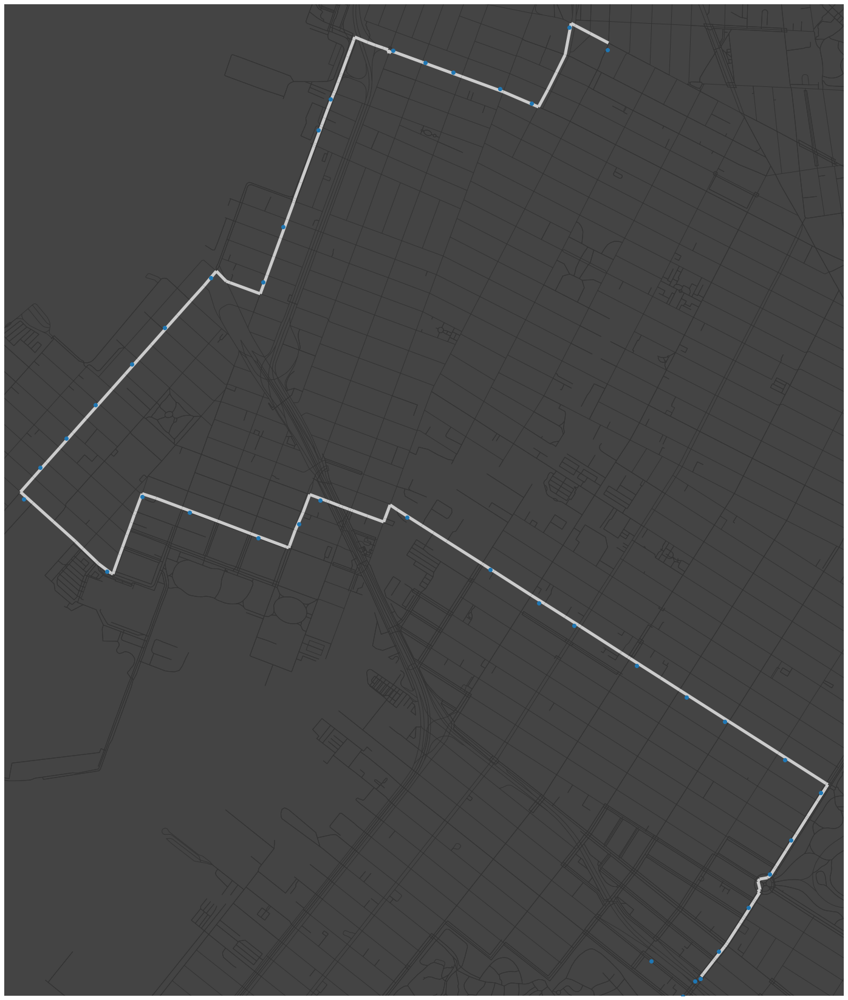

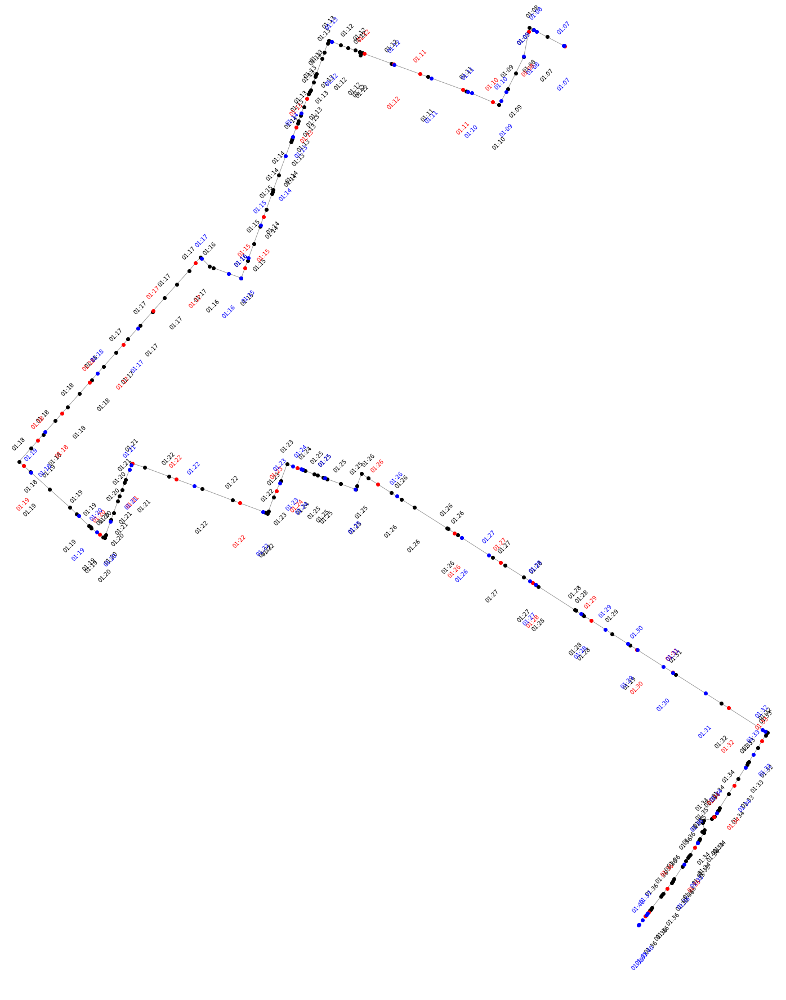

100%|██████████| 23/23 [05:16<00:00, 13.78s/it]


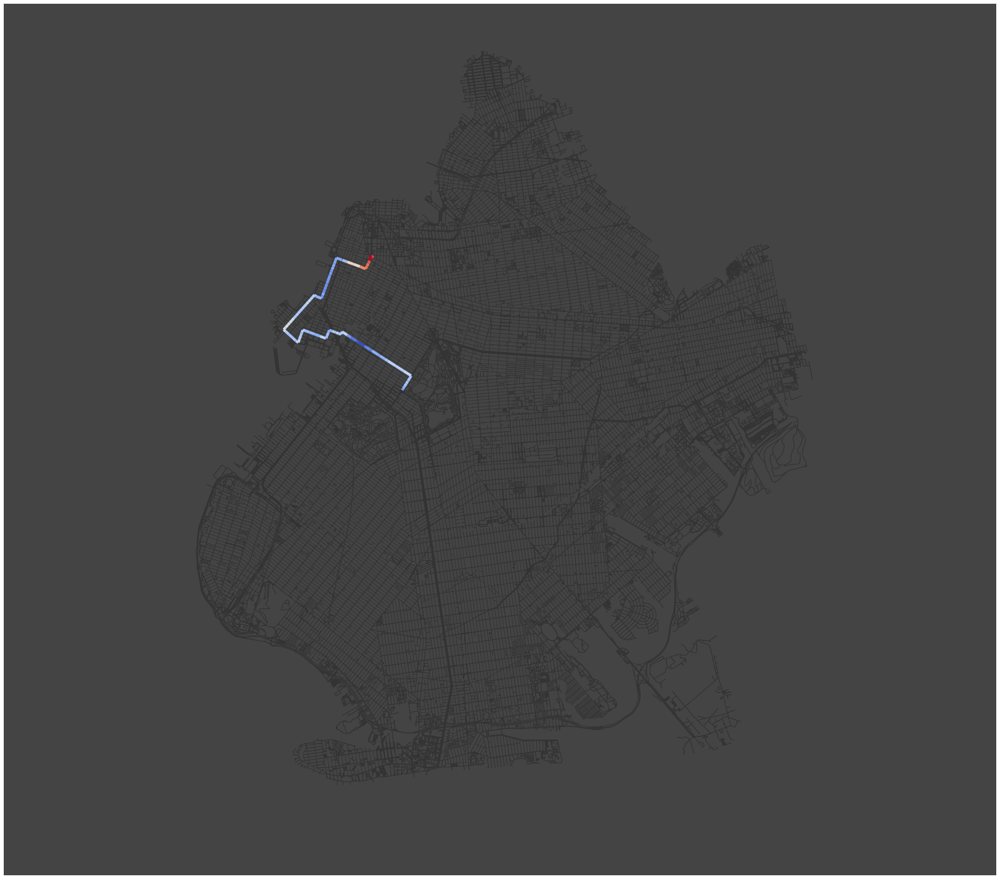

In [209]:
ROUTES_WITH_ERRORS = [
    'b61',
]
analysis = Analysis(ROUTES_WITH_ERRORS)
analysis.d0 = 1
analysis.d1 = 0
analysis.run_for_route('b61')

In [88]:
def create_route_subgraph(node_ids):
    graph = nx.MultiDiGraph()
    for node_id in node_ids:
        node = bk.nodes[node_id]
        graph.add_node(node_id, **node)
    for i in range(0, len(node_ids) - 1):
        graph.add_edge(node_ids[i], node_ids[i + 1])
    graph.graph['crs'] = CRS_PLOT
    return graph

def average_diff():
    diff_avg_df = analysis.diff_df.median()
    diff_avg_df = diff_avg_df.apply(lambda x: min(x, 600))
    diff_avg_df = diff_avg_df.apply(lambda x: max(x, -600))
    route_subgraph = create_route_subgraph([n for n in analysis.route_node_ids if n in set(diff_avg_df.index)])

    for edge in route_subgraph.edges:
        route_subgraph.add_edge(edge[0], edge[1], edge[2], weight=0)

    for i in range(0, len(analysis.route_nodes) - 1):
        route_node = analysis.route_nodes[i]
        next_node = analysis.route_nodes[i + 1]
        if route_node.id not in diff_avg_df.index:
            continue
        if next_node.id not in diff_avg_df.index:
            continue
        time_delta = diff_avg_df.loc[route_node.id]
        route_subgraph.add_edge(route_node.id, next_node.id, 0, weight=time_delta)
    
    analysis.diff_avg_df = diff_avg_df
    analysis.route_subgraph = route_subgraph
    
def plot_diff(route_subgraph):
    bbox=(40.75, 40.55, -73.80, -74.10)
    fig, ax = plt.subplots(figsize=(40, 30))
    ox.plot_graph(bk, ax=ax, bgcolor='#444', node_size=0, bbox=bbox, show=False, close=False, edge_color='#333')

    edge_colors = ox.plot.get_edge_colors_by_attr(route_subgraph, attr='weight', cmap='coolwarm')
    ox.plot_graph(route_subgraph, ax=ax, bgcolor='#444', node_size=0, bbox=bbox, show=False, close=False, edge_color=edge_colors, edge_linewidth=5)
    ax.set_facecolor('#444')
    plt.show()

In [222]:
class Analysis():
    def __init__(self, routes, plot=True):
        self.routes = routes
        self.plot = plot
        
    def reset(self):
        self.d0 = 0
        self.d1 = 1
        self.route_graph = None
        self.route_subgraph = None
        self.trajectories_df = None
        self.trajectories_dict = None
        self.rg_geoms = None
        self.rg_rtree = None
        self.stops_gdf = None
        self.stop_times_df = None
        self.route_node_ides = None
        self.diff_rows = None
        self.diff_df = None
        self.tps = None
        self.stops = None
        self.stop_dict = None
        self.route_nodes = None
        self.route_node_ids = None
        
    def run(self):
        for route in self.routes:
            start_time = time.time()
            
            self.reset()
            self.run_for_route(route)
            
            end_time = time.time()
            execution_time = end_time - start_time
            print(f'Completed {route} in {execution_time:.4f}s')
        
    def run_for_route(self, route):
        self.route = route
        print()
        print('----------------------------------------')
        print(self.route)
        print('----------------------------------------')
        print()
        print()
        load_data(self.route)
        if self.plot:
            plot_stops()

        self.trajectories_dict = get_trajectories_dict(self.trajectories_df, self.d0, self.d1)
        create_route_nodes()
        create_stops()
        
        if self.plot:
            plot_interpolation()

        self.diff_rows = match_to_timetable()
        if self.diff_rows is None or len(self.diff_rows) == 0:
            self.d0 = 1
            self.d1 = 0
            self.trajectories_dict = get_trajectories_dict(self.trajectories_df, self.d0, self.d1)
            create_route_nodes()
            create_stops()
            if self.plot:
                plot_interpolation()

            self.diff_rows = match_to_timetable()
        if self.diff_rows is None or len(self.diff_rows) == 0:
            print(f'Could not match {self.route.upper()} to timetable')
        else:
            save_diff(self.route)
            average_diff()
            if self.plot:
                plot_diff(self.route_subgraph)



----------------------------------------
b3
----------------------------------------




,stop_id,UP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,300184,01:10:00,25 AV/HARWAY AV,None,40.593023,-73.992179,None,None,0,None,POINT (-73.99218 40.59302)
1,300185,01:10:49,25 AV/BATH AV,None,40.594519,-73.990627,None,None,0,None,POINT (-73.99063 40.59452)
2,300186,01:11:52,25 AV/BENSON AV,None,40.596462,-73.988603,None,None,0,None,POINT (-73.98860 40.59646)
3,300188,01:12:49,25 AV/86 ST,None,40.598202,-73.986799,None,None,0,None,POINT (-73.98680 40.59820)
4,300187,01:13:14,25 AV/84 ST,None,40.598978,-73.985989,None,None,0,None,POINT (-73.98599 40.59898)


,stop_id,UP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
41,300225,01:35:00,AV U/MILL AV,None,40.615353,-73.913968,None,None,0,None,POINT (-73.91397 40.61535)
42,300226,01:35:33,AV U/E 64 ST,None,40.616520,-73.912034,None,None,0,None,POINT (-73.91203 40.61652)
43,300227,01:35:51,AV U/E 66 ST,None,40.617184,-73.911013,None,None,0,None,POINT (-73.91101 40.61718)
44,300228,01:36:38,AV U/E 69 ST,None,40.619048,-73.908507,None,None,0,None,POINT (-73.90851 40.61905)
45,300229,01:37:00,AV U/E 71 ST,None,40.619880,-73.907262,None,None,0,None,POINT (-73.90726 40.61988)


,trip_id,300184,300185,300186,300188,300187,300189,300190,300191,300192,...,300220,306144,300222,300223,300224,300225,300226,300227,300228,300229
0,UP_C1-Weekday-SDon-007000_B3_101,01:10:00,01:10:49,01:11:52,01:12:49,01:13:14,01:14:00,01:14:54,01:15:17,01:15:46,...,01:33:00,01:33:21,01:33:49,01:34:11,01:34:32,01:35:00,01:35:33,01:35:51,01:36:38,01:37:00
1,UP_C1-Weekday-SDon-013500_B3_101,02:15:00,02:15:49,02:16:52,02:17:49,02:18:14,02:19:00,02:19:54,02:20:17,02:20:46,...,02:38:00,02:38:21,02:38:49,02:39:11,02:39:32,02:40:00,02:40:33,02:40:51,02:41:38,02:42:00
2,UP_C1-Weekday-SDon-020000_B3_101,03:20:00,03:20:49,03:21:52,03:22:49,03:23:14,03:24:00,03:24:54,03:25:17,03:25:46,...,03:43:00,03:43:21,03:43:49,03:44:11,03:44:32,03:45:00,03:45:33,03:45:51,03:46:38,03:47:00
3,UP_C1-Weekday-SDon-024500_B3_102,04:05:00,04:05:49,04:06:52,04:07:49,04:08:14,04:09:00,04:09:54,04:10:17,04:10:46,...,04:30:00,04:30:32,04:31:13,04:31:46,04:32:19,04:33:00,04:33:33,04:33:51,04:34:38,04:35:00
4,UP_C1-Weekday-SDon-026500_B3_104,04:25:00,04:25:49,04:26:52,04:27:49,04:28:14,04:29:00,04:29:54,04:30:17,04:30:46,...,04:50:00,04:50:32,04:51:13,04:51:46,04:52:19,04:53:00,04:53:33,04:53:51,04:54:38,04:55:00


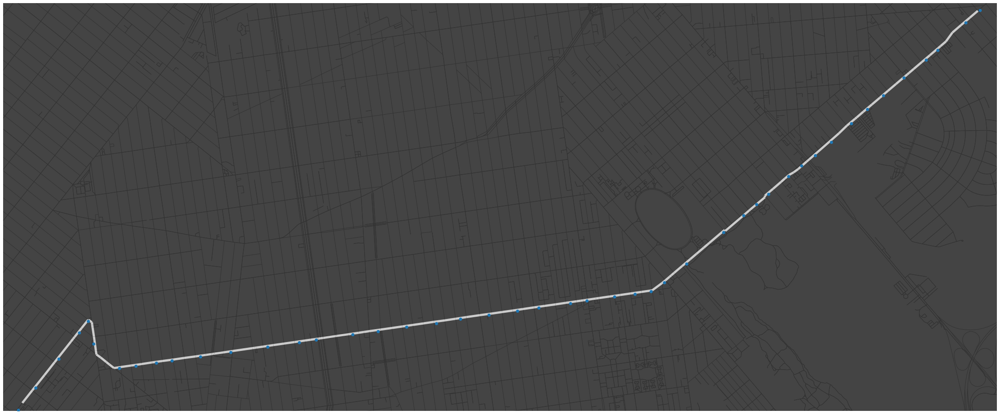

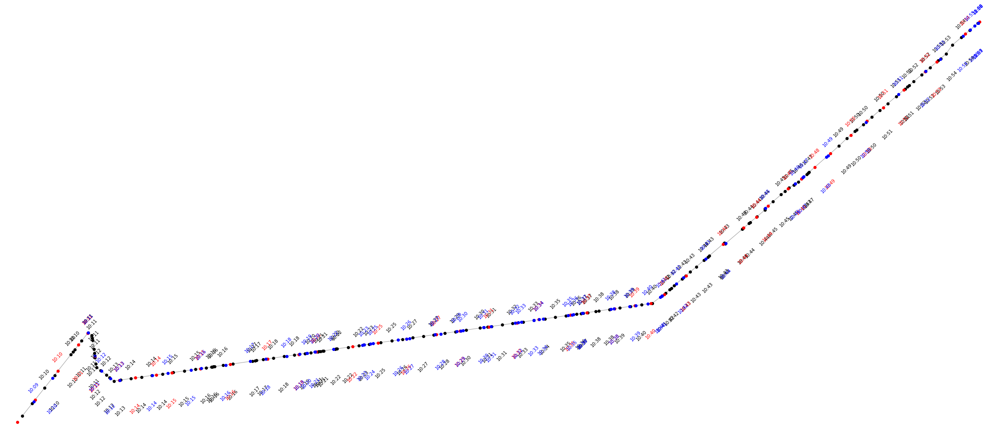

100%|██████████| 46/46 [06:16<00:00,  8.19s/it]


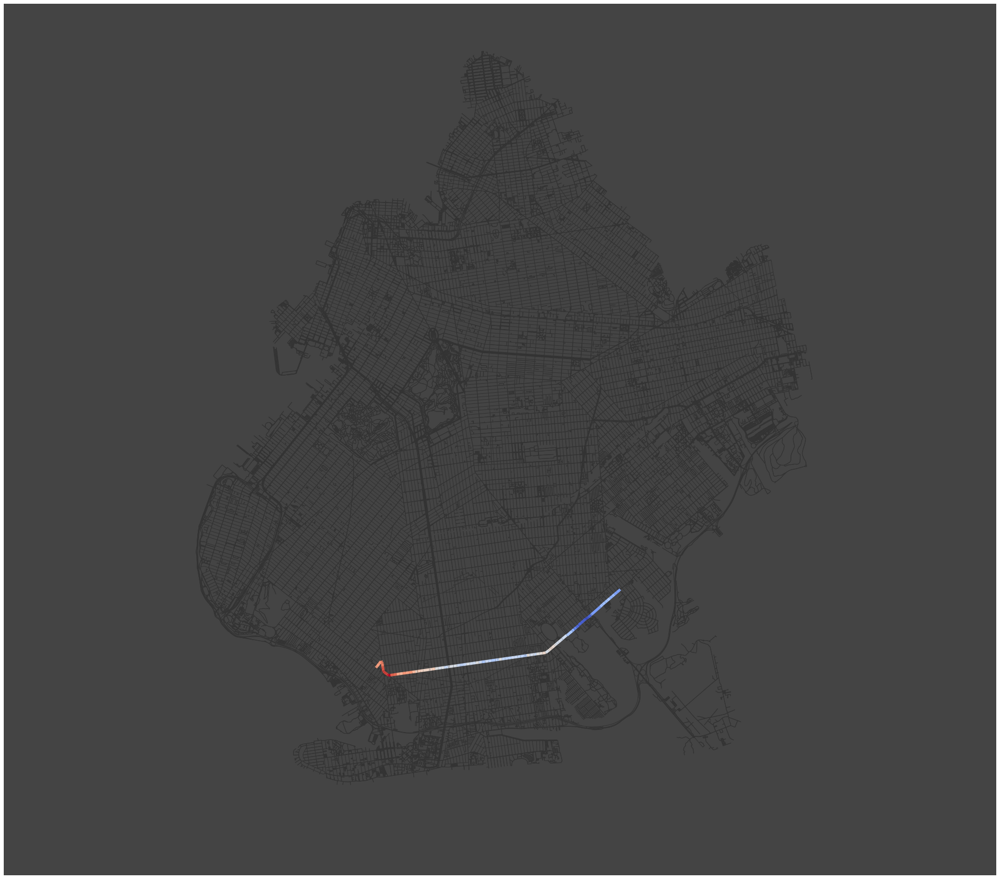

Completed b3 in 404.5333s

----------------------------------------
b6
----------------------------------------




,stop_id,UP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,300505,00:30:00,CROPSEY AV AV/BAY 37 ST,None,40.593473,-73.993985,None,None,0,None,POINT (-73.99398 40.59347)
1,300424,00:31:09,CROPSEY AV/23 AV,None,40.595960,-73.996910,None,None,0,None,POINT (-73.99691 40.59596)
2,308595,00:31:40,CROPSEY AV/BAY 31 ST,None,40.597032,-73.998301,None,None,0,None,POINT (-73.99830 40.59703)
3,300427,00:32:17,BAY PY/BATH AV,None,40.598406,-73.997389,None,None,0,None,POINT (-73.99739 40.59841)
4,300428,00:33:11,BAY PY/BENSON AV,None,40.600434,-73.995232,None,None,0,None,POINT (-73.99523 40.60043)


,stop_id,UP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
69,306854,01:20:00,ASHFORD ST/COZINE AV,None,40.658951,-73.877926,None,None,0,None,POINT (-73.87793 40.65895)
70,306881,01:20:23,ASHFORD ST/WORTMAN AV,None,40.659995,-73.878701,None,None,0,None,POINT (-73.87870 40.66000)
71,307600,01:20:53,ASHFORD ST/STANLEY AV,None,40.661418,-73.879809,None,None,0,None,POINT (-73.87981 40.66142)
72,306855,01:21:18,ASHFORD ST/LINDEN BL,None,40.662583,-73.880618,None,None,0,None,POINT (-73.88062 40.66258)
73,306857,01:23:00,LIVONIA AV/ASHFORD ST,None,40.666420,-73.883387,None,None,0,None,POINT (-73.88339 40.66642)


,trip_id,300505,300424,308595,300427,300428,300429,308365,300431,300432,...,300582,306850,306851,306852,306853,306854,306881,307600,306855,306857
0,UP_C1-Weekday-SDon-003000_B6_201,00:30:00,00:31:09,00:31:40,00:32:17,00:33:11,00:34:00,00:34:45,00:35:34,00:35:58,...,01:16:38,01:17:18,01:17:44,01:18:26,01:19:28,01:20:00,01:20:23,01:20:53,01:21:18,01:23:00
1,UP_C1-Weekday-SDon-009000_B6_202,01:30:00,01:31:09,01:31:40,01:32:17,01:33:11,01:34:00,01:34:39,01:35:21,01:35:41,...,02:13:38,02:14:18,02:14:44,02:15:26,02:16:28,02:17:00,02:17:23,02:17:53,02:18:18,02:20:00
2,UP_C1-Weekday-SDon-015000_B6_201,02:30:00,02:31:09,02:31:40,02:32:17,02:33:11,02:34:00,02:34:39,02:35:21,02:35:41,...,03:13:38,03:14:18,03:14:44,03:15:26,03:16:28,03:17:00,03:17:23,03:17:53,03:18:18,03:20:00
3,UP_C1-Weekday-SDon-018000_B6_203,03:00:00,03:01:09,03:01:40,03:02:17,03:03:11,03:04:00,03:04:39,03:05:21,03:05:41,...,03:43:38,03:44:18,03:44:44,03:45:26,03:46:28,03:47:00,03:47:23,03:47:53,03:48:18,03:50:00
4,UP_C1-Weekday-SDon-021000_B6_202,03:30:00,03:31:09,03:31:40,03:32:17,03:33:11,03:34:00,03:34:39,03:35:21,03:35:41,...,04:13:38,04:14:18,04:14:44,04:15:26,04:16:28,04:17:00,04:17:23,04:17:53,04:18:18,04:20:00


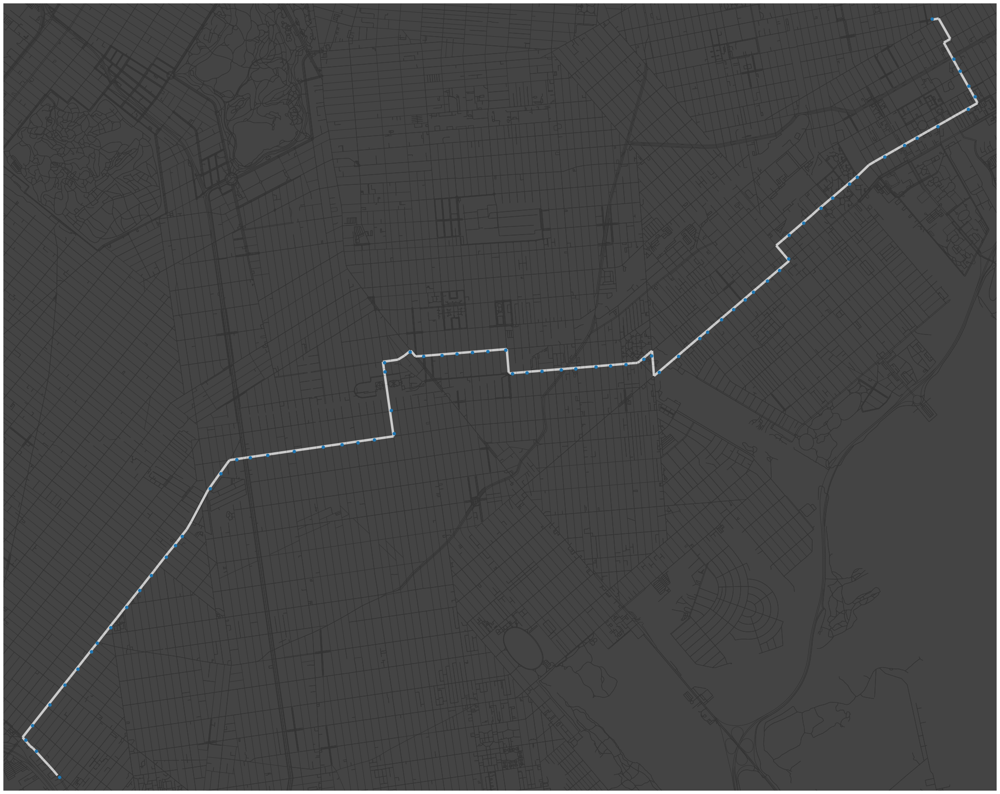

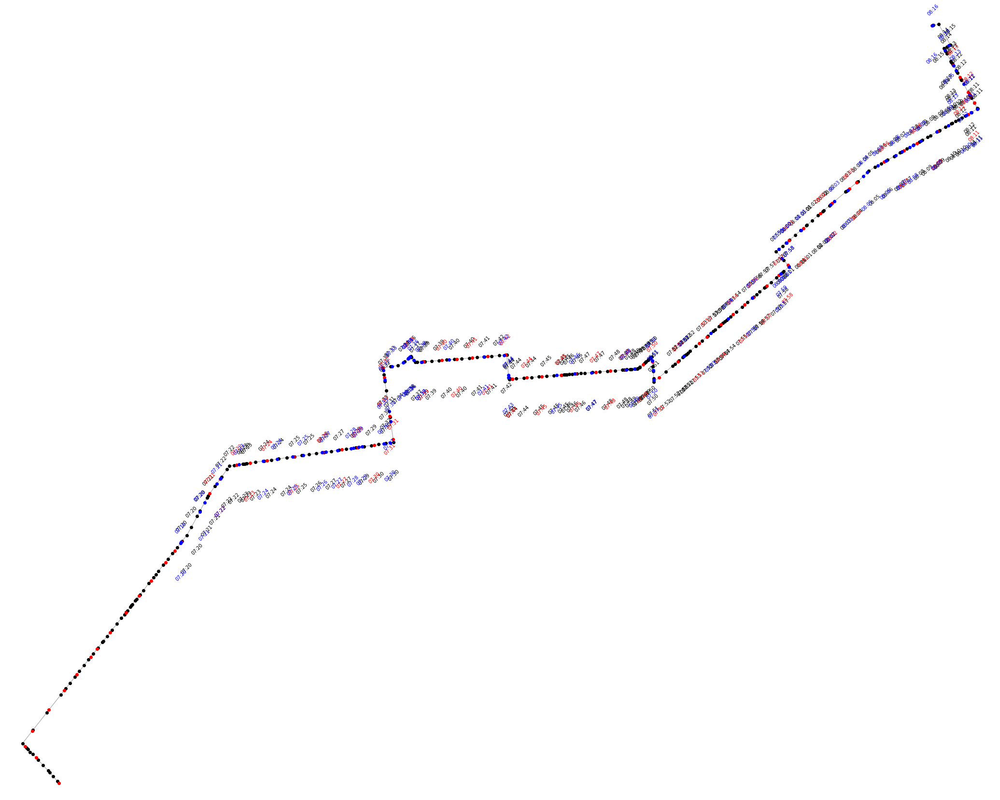

100%|██████████| 84/84 [11:55<00:00,  8.52s/it]


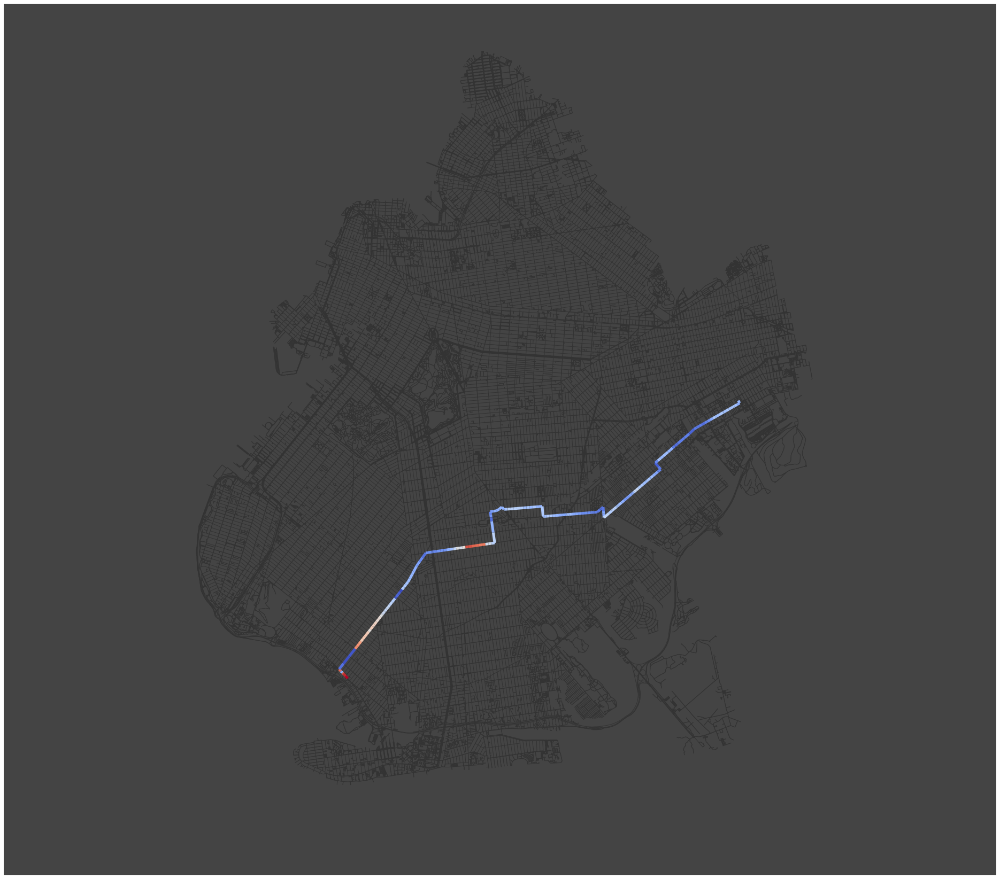

Completed b6 in 752.9312s

----------------------------------------
b8
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307582,01:00:00,4 AV/95 ST,None,40.616105,-74.031146,None,None,0,None,POINT (-74.03115 40.61610)
1,306945,01:00:28,4 AV/97 ST,None,40.614527,-74.032330,None,None,0,None,POINT (-74.03233 40.61453)
2,308038,01:01:06,FT HAMILTON PKWY/MARINE AV,None,40.613323,-74.030616,None,None,0,None,POINT (-74.03062 40.61332)
3,308039,01:01:39,FT HAMILTON PKY/95 ST,None,40.615101,-74.029071,None,None,0,None,POINT (-74.02907 40.61510)
4,306959,01:02:18,92 ST/FT HAMILTON PY,None,40.616714,-74.027208,None,None,0,None,POINT (-74.02721 40.61671)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
75,302723,01:50:43,CHURCH AV/E 96 ST,None,40.655855,-73.915074,None,None,0,None,POINT (-73.91507 40.65586)
76,302724,01:51:00,CHURCH AV/ROCKAWAY PY,None,40.656401,-73.914223,None,None,0,None,POINT (-73.91422 40.65640)
77,307954,01:51:26,E 98 ST/CHURCH AV,None,40.656080,-73.913135,None,None,0,None,POINT (-73.91313 40.65608)
78,307115,01:52:24,HEGEMAN AV/THOMAS S BOYLAND ST,None,40.655881,-73.909480,None,None,0,None,POINT (-73.90948 40.65588)
79,901029,01:53:00,ROCKAWAY AV/HEGEMAN AV,None,40.656047,-73.907383,None,None,0,None,POINT (-73.90738 40.65605)


,trip_id,307582,306945,308038,308039,306959,305951,305952,308357,308358,...,306870,301746,306838,302721,302722,302723,302724,307954,307115,901029
0,JG_C1-Weekday-SDon-006000_B8_102,01:00:00,01:00:28,01:01:06,01:01:39,01:02:18,01:03:25,01:04:01,01:05:00,01:05:16,...,01:47:54,01:48:34,01:49:17,01:49:51,01:50:12,01:50:43,01:51:00,01:51:26,01:52:24,01:53:00
1,JG_C1-Weekday-012000_B8_101,02:00:00,02:00:28,02:01:06,02:01:39,02:02:18,02:03:25,02:04:01,02:05:00,02:05:16,...,02:47:54,02:48:34,02:49:17,02:49:51,02:50:12,02:50:43,02:51:00,02:51:26,02:52:24,02:53:00
2,JG_C1-Weekday-SDon-018000_B8_102,03:00:00,03:00:28,03:01:06,03:01:39,03:02:18,03:03:25,03:04:01,03:05:00,03:05:16,...,03:47:54,03:48:34,03:49:17,03:49:51,03:50:12,03:50:43,03:51:00,03:51:26,03:52:24,03:53:00
3,JG_C1-Weekday-SDon-024000_B8_104,04:00:00,04:00:28,04:01:06,04:01:39,04:02:18,04:03:25,04:04:01,04:05:00,04:05:16,...,04:50:54,04:51:34,04:52:17,04:52:51,04:53:12,04:53:43,04:54:00,04:54:26,04:55:24,04:56:00
4,JG_C1-Weekday-028500_B8_108,04:45:00,04:45:28,04:46:06,04:46:39,04:47:18,04:48:25,04:49:01,04:50:00,04:50:16,...,05:39:12,05:40:06,05:41:03,05:41:48,05:42:17,05:42:58,05:43:20,05:43:54,05:45:11,05:46:00


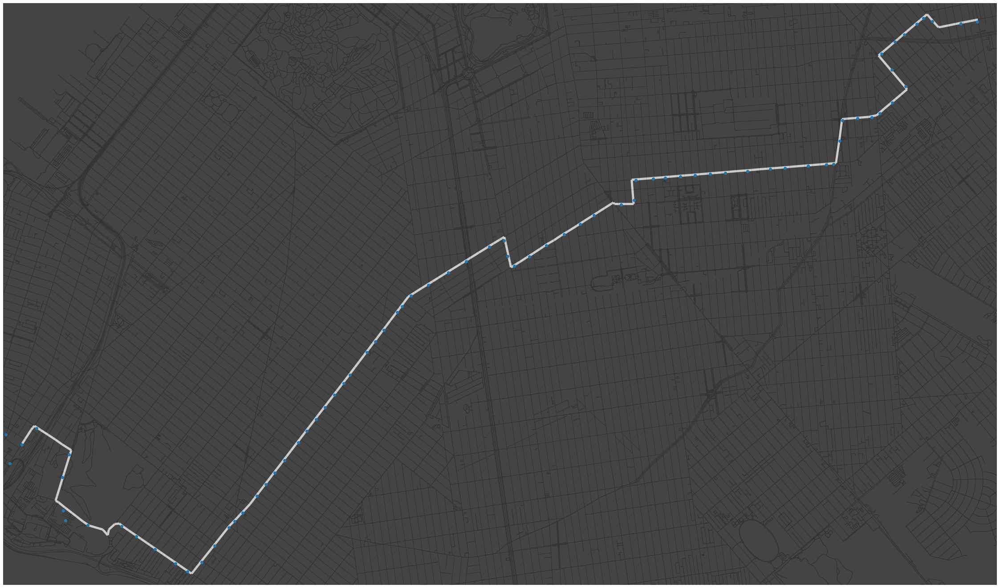

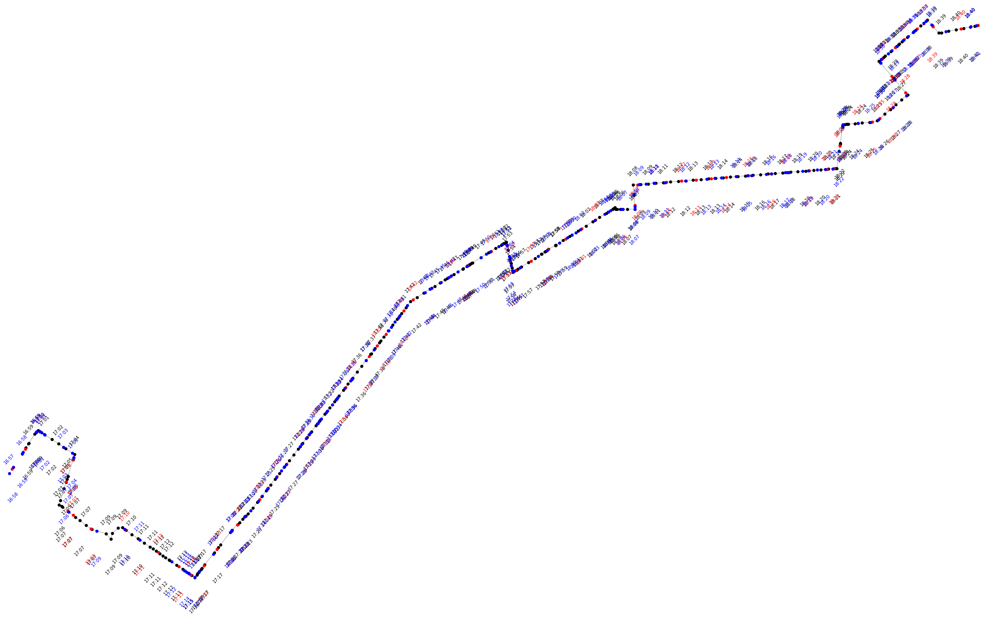

100%|██████████| 43/43 [08:36<00:00, 12.01s/it]


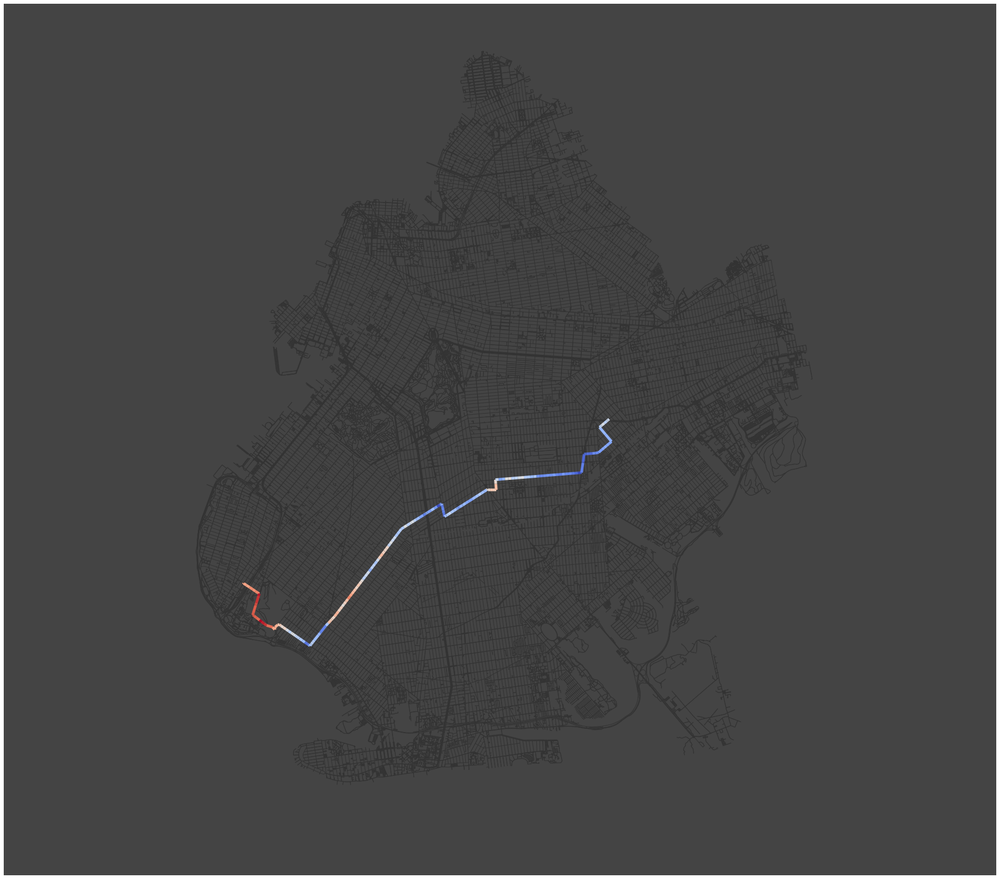

Completed b8 in 550.3201s

----------------------------------------
b9
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307941,04:45:00,SHORE RD/71 ST,None,40.636852,-74.036257,None,None,0,None,POINT (-74.03626 40.63685)
1,300071,04:45:56,BAY RIDGE AV/SHORE RD,None,40.638570,-74.035368,None,None,0,None,POINT (-74.03537 40.63857)
2,307200,04:46:30,BAY RIDGE AV/NARROWS AV,None,40.638000,-74.033530,None,None,0,None,POINT (-74.03353 40.63800)
3,300073,04:47:19,BAY RIDGE AV/COLONIAL RD,None,40.637191,-74.030921,None,None,0,None,POINT (-74.03092 40.63719)
4,300074,04:48:07,BAY RIDGE AV/RIDGE BL,None,40.636379,-74.028312,None,None,0,None,POINT (-74.02831 40.63638)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
51,303339,None,FLATBUSH AV/AV R,None,40.615975,-73.929712,None,None,0,None,POINT (-73.92971 40.61597)
52,303340,None,FLATBUSH AV/FILLMORE AV,None,40.614695,-73.928280,None,None,0,None,POINT (-73.92828 40.61469)
53,303341,None,FLATBUSH AV/AV S,None,40.613075,-73.926474,None,None,0,None,POINT (-73.92647 40.61308)
54,307636,None,FLATBUSH AV/AV T,None,40.611273,-73.924426,None,None,0,None,POINT (-73.92443 40.61127)
55,801039,None,Kings Plaza (B9 term),None,40.608306,-73.920622,None,None,0,None,POINT (-73.92062 40.60831)


,trip_id,307941,300071,307200,300073,300074,300075,308239,308240,308650,...,300966,307199,303323,303324,303338,303339,303340,303341,307636,801039
0,JG_C1-Weekday-SDon-028500_B9_201,04:45:00,04:45:56,04:46:30,04:47:19,04:48:07,04:49:00,04:49:47,04:50:29,04:51:27,...,05:18:24,05:19:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,JG_C1-Weekday-SDon-030000_B9_202,05:00:00,05:00:56,05:01:30,05:02:19,05:03:07,05:04:00,05:04:47,05:05:29,05:06:27,...,05:33:24,05:34:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,JG_C1-Weekday-SDon-031200_B9_203,05:12:00,05:12:56,05:13:30,05:14:19,05:15:07,05:16:00,05:16:47,05:17:29,05:18:27,...,05:48:12,05:49:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,JG_C1-Weekday-SDon-032400_B9_204,05:24:00,05:24:56,05:25:30,05:26:19,05:27:07,05:28:00,05:28:47,05:29:29,05:30:27,...,06:01:12,06:02:00,06:02:59,06:04:00,06:04:52,06:06:04,06:07:00,06:08:11,06:09:32,06:12:00
4,JG_C1-Weekday-SDon-033600_B9_205,05:36:00,05:37:10,05:37:53,05:38:54,05:39:54,05:41:00,05:41:56,05:42:46,05:43:56,...,06:19:00,06:20:00,06:20:59,06:22:00,06:22:52,06:24:04,06:25:00,06:26:11,06:27:32,06:30:00


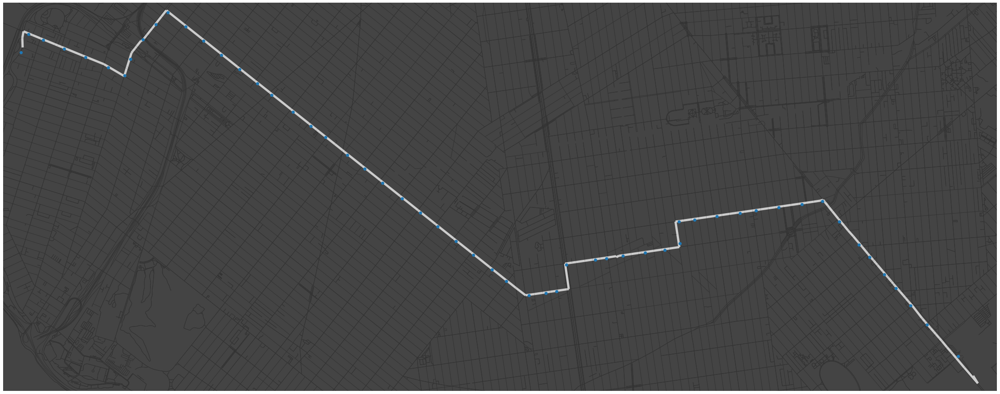

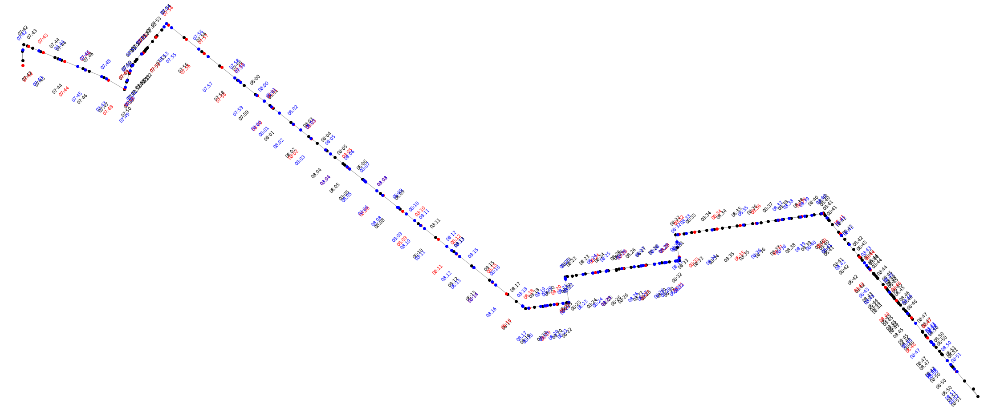

 12%|█▏        | 3/25 [01:13<08:58, 24.47s/it]

Experienced error
Completed b9 in 95.0981s

----------------------------------------
b11
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307484,04:08:00,58 ST/1 Av,None,40.645419,-74.023199,None,None,0,None,POINT (-74.02320 40.64542)
1,307485,04:09:24,2 AV/56 ST,None,40.645954,-74.020082,None,None,0,None,POINT (-74.02008 40.64595)
2,301162,04:10:37,52 ST/2 AV,None,40.647742,-74.017809,None,None,0,None,POINT (-74.01781 40.64774)
3,308052,04:11:40,52 ST/3 AV,None,40.646227,-74.015297,None,None,0,None,POINT (-74.01530 40.64623)
4,306579,04:12:13,52 ST/4 AV,None,40.645434,-74.013992,None,None,0,None,POINT (-74.01399 40.64543)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
35,300535,04:36:27,BEDFORD AV/AV I,None,40.628783,-73.951952,None,None,0,None,POINT (-73.95195 40.62878)
36,300536,04:38:07,BEDFORD AV/CAMPUS RD,None,40.632483,-73.952713,None,None,0,None,POINT (-73.95271 40.63248)
37,300538,04:38:35,GLENWOOD RD/BEDFORD AV,None,40.633378,-73.952817,None,None,0,None,POINT (-73.95282 40.63338)
38,300540,04:39:48,GLENWOOD RD/FLATBUSH AV,None,40.634365,-73.949541,None,None,0,None,POINT (-73.94954 40.63437)
39,306468,04:41:00,NOSTRAND AV/FLATBUSH AV,None,40.632419,-73.947699,None,None,0,None,POINT (-73.94770 40.63242)


,trip_id,307484,307485,301162,308052,306579,306580,306581,301168,307618,...,300529,300530,307706,300532,300534,300535,300536,300538,300540,306468
0,JG_C1-Weekday-SDon-024800_B11_301,04:08:00,04:09:24,04:10:37,04:11:40,04:12:13,04:13:05,04:14:00,04:15:00,04:16:01,...,04:32:15,04:33:05,04:33:45,04:34:29,04:35:27,04:36:27,04:38:07,04:38:35,04:39:48,04:41:00
1,JG_C1-Weekday-SDon-027000_B11_302,04:30:00,04:31:24,04:32:37,04:33:40,04:34:13,04:35:05,04:36:00,04:37:00,04:38:01,...,04:54:15,04:55:05,04:55:45,04:56:29,04:57:27,04:58:27,05:00:07,05:00:35,05:01:48,05:03:00
2,JG_C1-Weekday-SDon-029000_B11_303,04:50:00,04:51:24,04:52:37,04:53:40,04:54:13,04:55:05,04:56:00,04:57:00,04:58:01,...,05:14:15,05:15:05,05:15:45,05:16:29,05:17:27,05:18:27,05:20:07,05:20:35,05:21:48,05:23:00
3,JG_C1-Weekday-SDon-030500_B11_304,05:05:00,05:06:24,05:07:37,05:08:40,05:09:13,05:10:05,05:11:00,05:12:00,05:13:01,...,05:29:15,05:30:05,05:30:45,05:31:29,05:32:27,05:33:27,05:35:07,05:35:35,05:36:48,05:38:00
4,JG_C1-Weekday-SDon-032000_B11_305,05:20:00,05:21:24,05:22:37,05:23:40,05:24:13,05:25:05,05:26:00,05:27:00,05:28:01,...,05:48:15,05:49:05,05:49:45,05:50:29,05:51:27,05:52:27,05:54:07,05:54:35,05:55:48,05:57:00


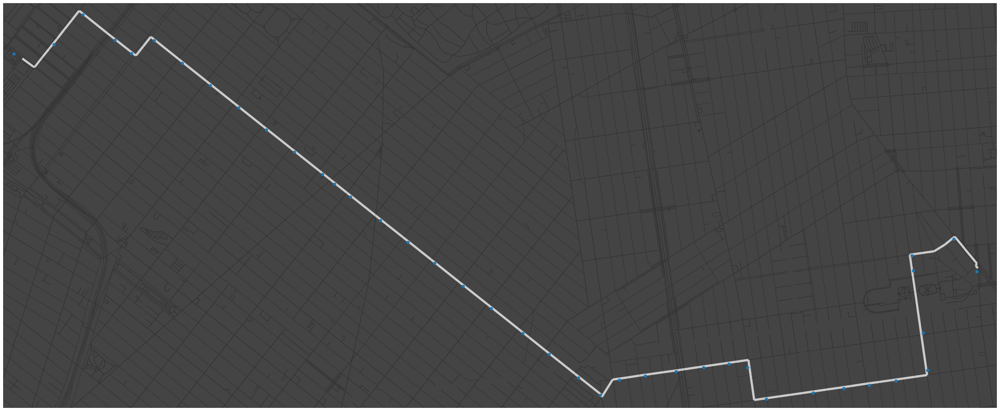

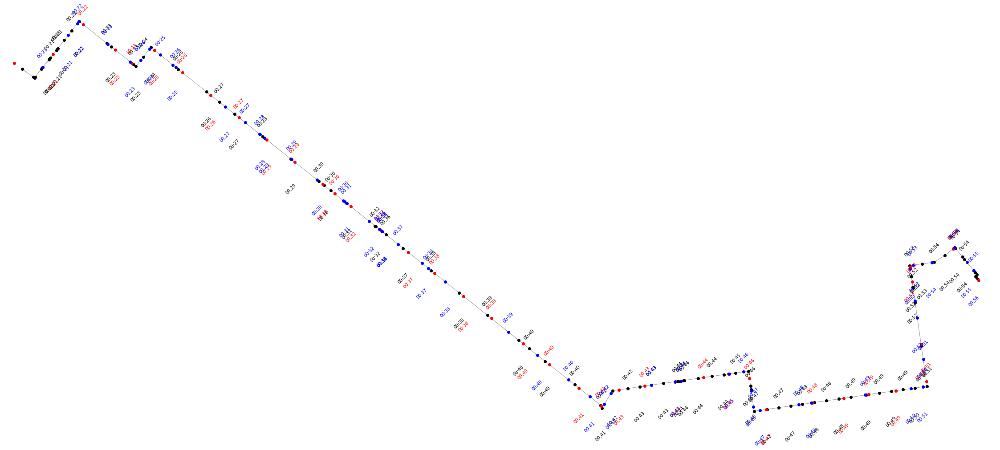

100%|██████████| 29/29 [05:39<00:00, 11.72s/it]


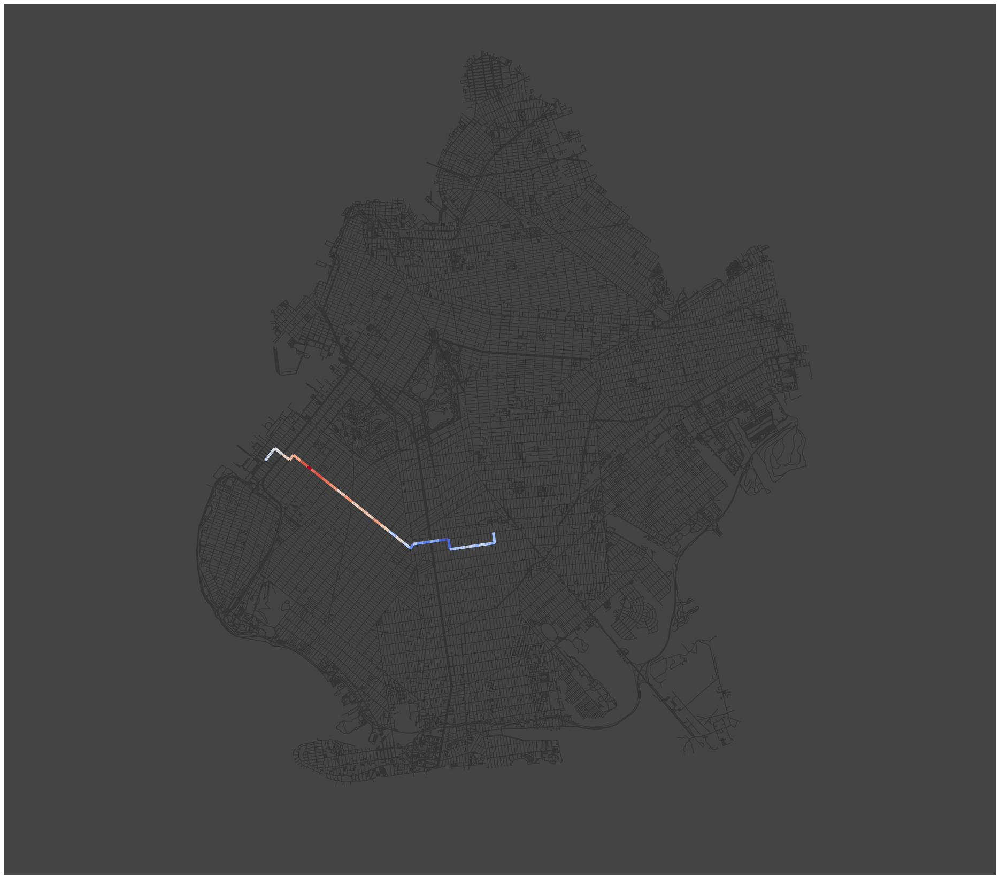

Completed b11 in 367.4190s

----------------------------------------
b12
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,301386,01:17:37,PACIFIC ST/EAST NEW YORK AV,None,40.675270,-73.905186,None,None,0,None,POINT (-73.90519 40.67527)
1,301387,01:18:08,SACKMAN ST/DEAN ST,None,40.674606,-73.906329,None,None,0,None,POINT (-73.90633 40.67461)
2,301388,01:19:01,EAST NEW YORK AV/MOTHER GASTON BL,None,40.673244,-73.908786,None,None,0,None,POINT (-73.90879 40.67324)
3,301389,01:19:19,EAST NEW YORK AV/ST MARKS AV,None,40.672850,-73.909703,None,None,0,None,POINT (-73.90970 40.67285)
4,301390,01:19:57,EAST NEW YORK AV/ROCKAWAY AV,None,40.671959,-73.911737,None,None,0,None,POINT (-73.91174 40.67196)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
26,307120,01:20:53,EAST NEW YORK AV/STERLING PL,None,40.670669,-73.914698,None,None,0,None,POINT (-73.91470 40.67067)
27,307309,01:24:49,EAST NEW YORK AV/PORTAL ST,None,40.666331,-73.924710,None,None,0,None,POINT (-73.92471 40.66633)
28,308274,01:22:26,NEW YORK AV/LINCOLN PL,None,40.668604,-73.919270,None,None,0,None,POINT (-73.91927 40.66860)
29,801177,01:16:00,ALABAMA AV / FULTON ST,None,40.676746,-73.899944,None,None,0,None,POINT (-73.89994 40.67675)
30,901089,01:41:00,PARKSIDE AV/OCEAN AV,None,40.654848,-73.961754,None,None,0,None,POINT (-73.96175 40.65485)


,trip_id,301386,301387,301388,301389,301390,301392,301395,301397,301398,...,301413,301414,306348,306349,306438,307120,307309,308274,801177,901089
0,EN_C1-Weekday-SDon-007600_B12_1,01:17:37,01:18:08,01:19:01,01:19:19,01:19:57,01:22:00,01:25:38,01:26:03,01:27:01,...,01:39:49,01:40:33,01:24:08,01:34:58,01:28:00,01:20:53,01:24:49,01:22:26,01:16:00,01:41:00
1,EN_C1-Weekday-011600_B12_2,01:57:21,01:57:47,01:58:31,01:58:46,01:59:17,02:01:00,02:04:02,02:04:22,02:05:11,...,02:17:49,02:18:33,02:02:47,02:12:58,02:06:00,02:00:04,02:03:21,02:01:22,01:56:00,02:19:00
2,EN_C1-Weekday-SDon-015600_B12_1,02:37:21,02:37:47,02:38:31,02:38:46,02:39:17,02:41:00,02:44:02,02:44:22,02:45:11,...,02:57:49,02:58:33,02:42:47,02:52:58,02:46:00,02:40:04,02:43:21,02:41:22,02:36:00,02:59:00
3,EN_C1-Weekday-SDon-019600_B12_2,03:17:21,03:17:47,03:18:31,03:18:46,03:19:17,03:21:00,03:24:02,03:24:22,03:25:11,...,03:37:49,03:38:33,03:22:47,03:32:58,03:26:00,03:20:04,03:23:21,03:21:22,03:16:00,03:39:00
4,EN_C1-Weekday-SDon-023100_B12_3,03:52:21,03:52:47,03:53:31,03:53:46,03:54:17,03:56:00,03:59:02,03:59:22,04:00:11,...,04:12:49,04:13:33,03:57:47,04:07:58,04:01:00,03:55:04,03:58:21,03:56:22,03:51:00,04:14:00


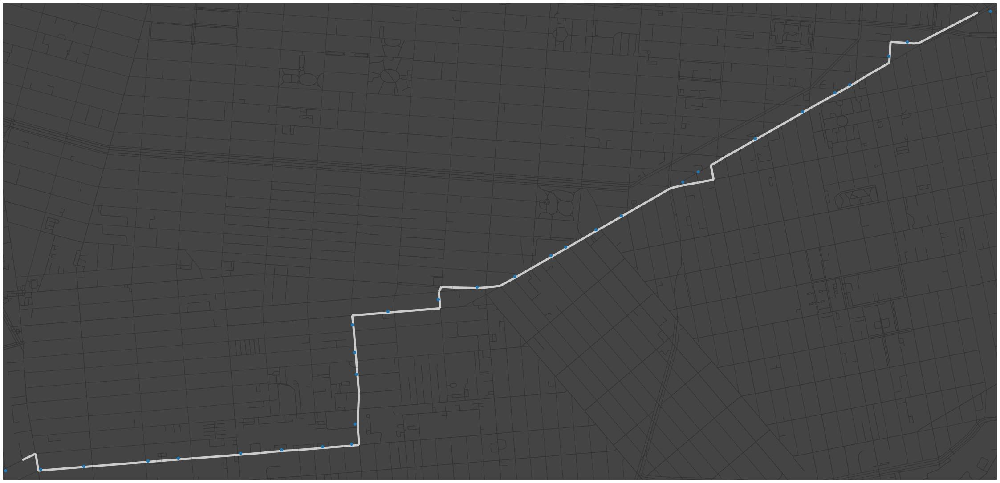

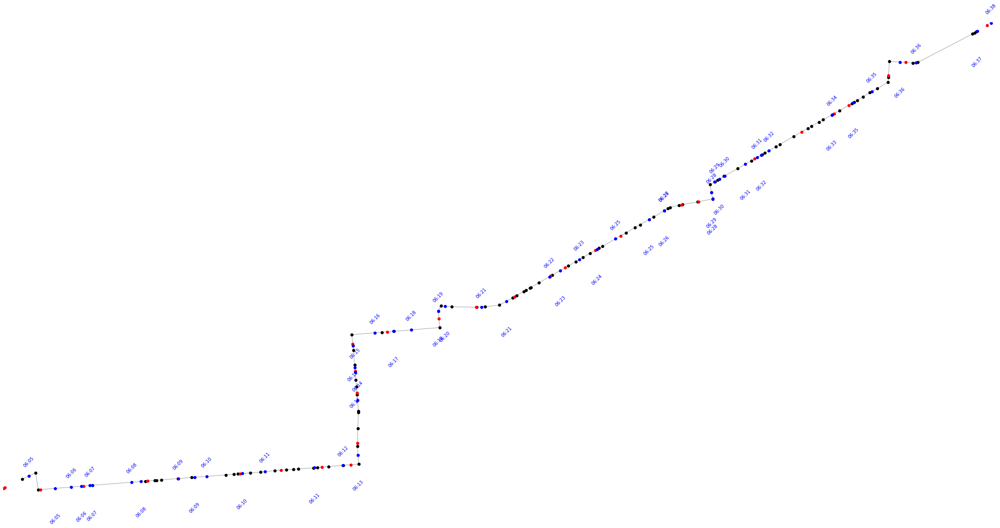

 22%|██▏       | 11/49 [00:50<02:55,  4.61s/it]

fail
Experienced error
Completed b12 in 68.0500s

----------------------------------------
b16
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,301602,06:33:00,SHORE RD/4 AV,None,40.611761,-74.035120,None,None,0,None,POINT (-74.03512 40.61176)
1,301603,06:33:23,SHORE RD/3 AV,None,40.612824,-74.036255,None,None,0,None,POINT (-74.03625 40.61282)
2,301604,06:33:46,SHORE RD/99 ST,None,40.614081,-74.037102,None,None,0,None,POINT (-74.03710 40.61408)
3,301605,06:34:11,SHORE RD/97 ST,None,40.615508,-74.037701,None,None,0,None,POINT (-74.03770 40.61551)
4,301606,06:34:47,SHORE RD/RIDGE BL,None,40.617525,-74.038876,None,None,0,None,POINT (-74.03888 40.61753)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
56,308349,07:28:00,OCEAN AV/PARKSIDE AV,None,40.655139,-73.961837,None,None,0,None,POINT (-73.96184 40.65514)
57,307641,07:28:59,OCEAN AV/231 OCEAN AVENUE,None,40.657322,-73.962200,None,None,0,None,POINT (-73.96220 40.65732)
58,307642,07:30:36,OCEAN AV/LINCOLN RD,None,40.660874,-73.962778,None,None,0,None,POINT (-73.96278 40.66087)
59,307646,07:31:56,FLATBUSH AV/OCEAN AV,None,40.662643,-73.962143,None,None,0,None,POINT (-73.96214 40.66264)
60,801030,07:33:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,301602,301603,301604,301605,301606,301607,301608,301609,301610,...,301657,301658,301659,307638,307639,308349,307641,307642,307646,801030
0,JG_C1-Weekday-SDon-039300_B16_401,06:33:00,06:33:23,06:33:46,06:34:11,06:34:47,06:35:21,06:36:05,06:36:25,06:37:00,...,07:22:01,07:23:01,07:24:02,07:25:18,07:26:15,07:28:00,07:28:59,07:30:36,07:31:56,07:33:00
1,JG_C1-Weekday-043000_B16_403,07:10:00,07:10:23,07:10:46,07:11:11,07:11:47,07:12:21,07:13:05,07:13:25,07:14:00,...,08:02:01,08:03:01,08:04:02,08:05:18,08:06:15,08:08:00,08:08:36,08:09:33,08:10:22,08:11:00
2,JG_C1-Weekday-SDon-044500_B16_404,07:25:00,07:25:23,07:25:46,07:26:11,07:26:47,07:27:21,07:28:05,07:28:25,07:29:00,...,08:18:32,08:19:47,08:21:03,08:22:38,08:23:49,08:26:00,08:26:36,08:27:33,08:28:22,08:29:00
3,JG_C1-Weekday-SDon-045700_B16_414,07:37:00,07:37:23,07:37:46,07:38:11,07:38:47,07:39:21,07:40:05,07:40:25,07:41:00,...,08:32:32,08:33:47,08:35:03,08:36:38,08:37:49,08:40:00,08:40:36,08:41:33,08:42:22,08:43:00
4,JG_C1-Weekday-046900_B16_406,07:49:00,07:49:23,07:49:46,07:50:11,07:50:47,07:51:21,07:52:05,07:52:25,07:53:00,...,08:45:32,08:46:47,08:48:03,08:49:38,08:50:49,08:53:00,08:53:36,08:54:33,08:55:22,08:56:00


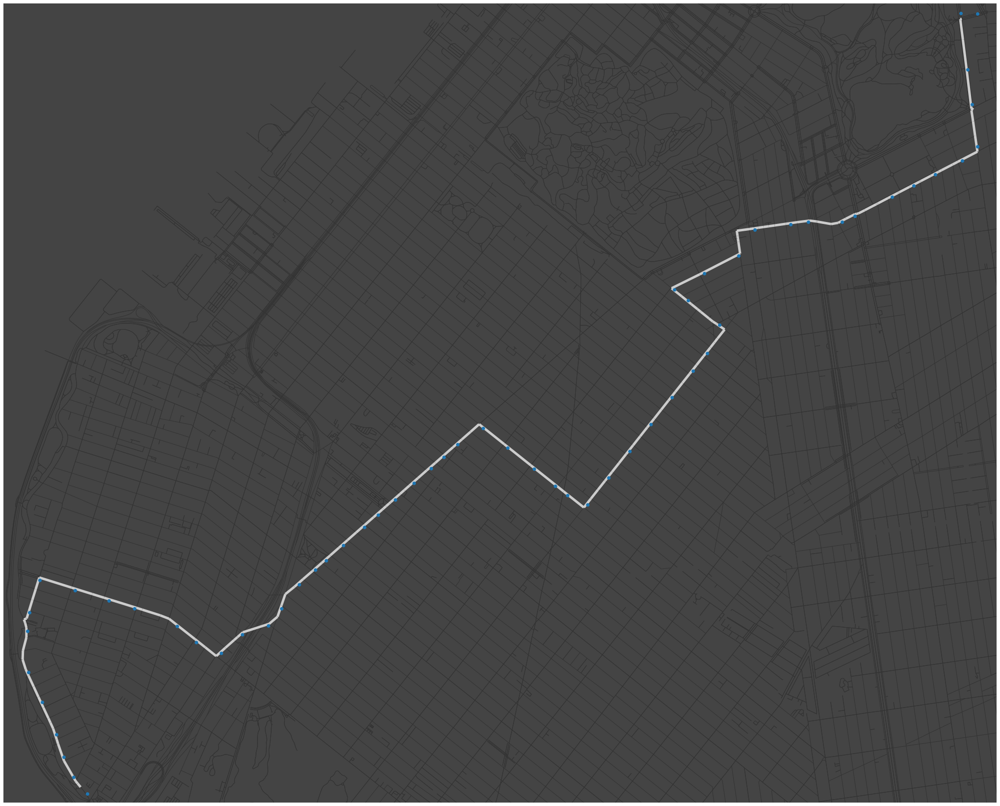

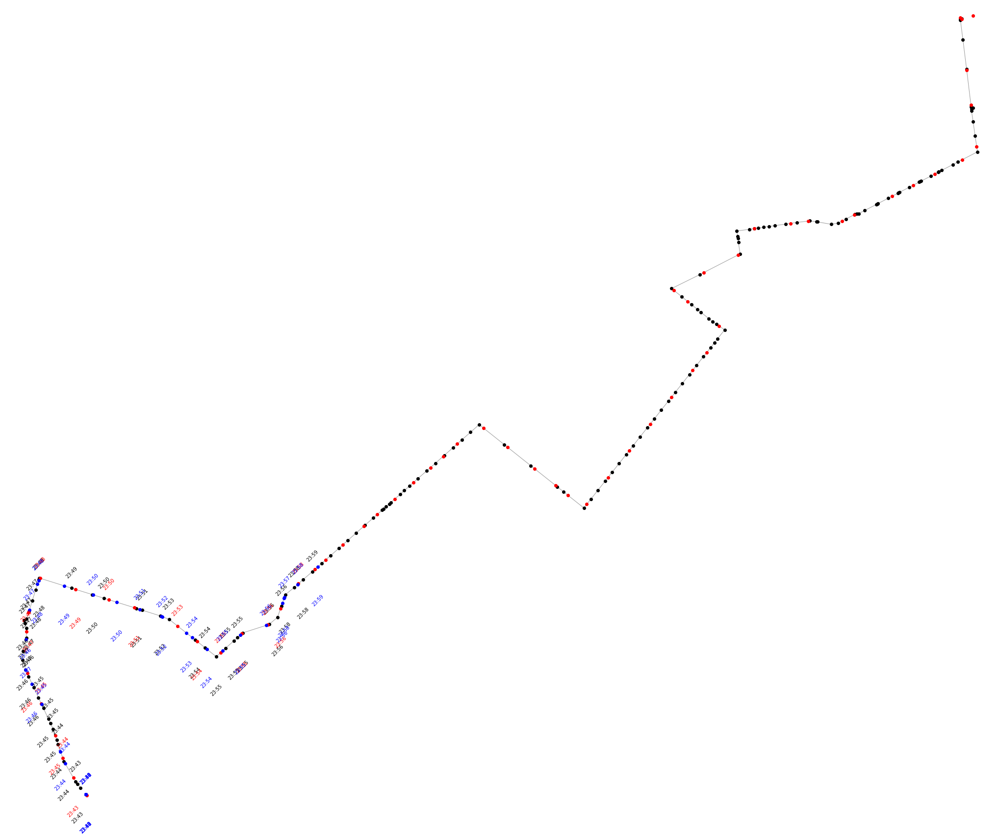

100%|██████████| 28/28 [03:16<00:00,  7.02s/it]


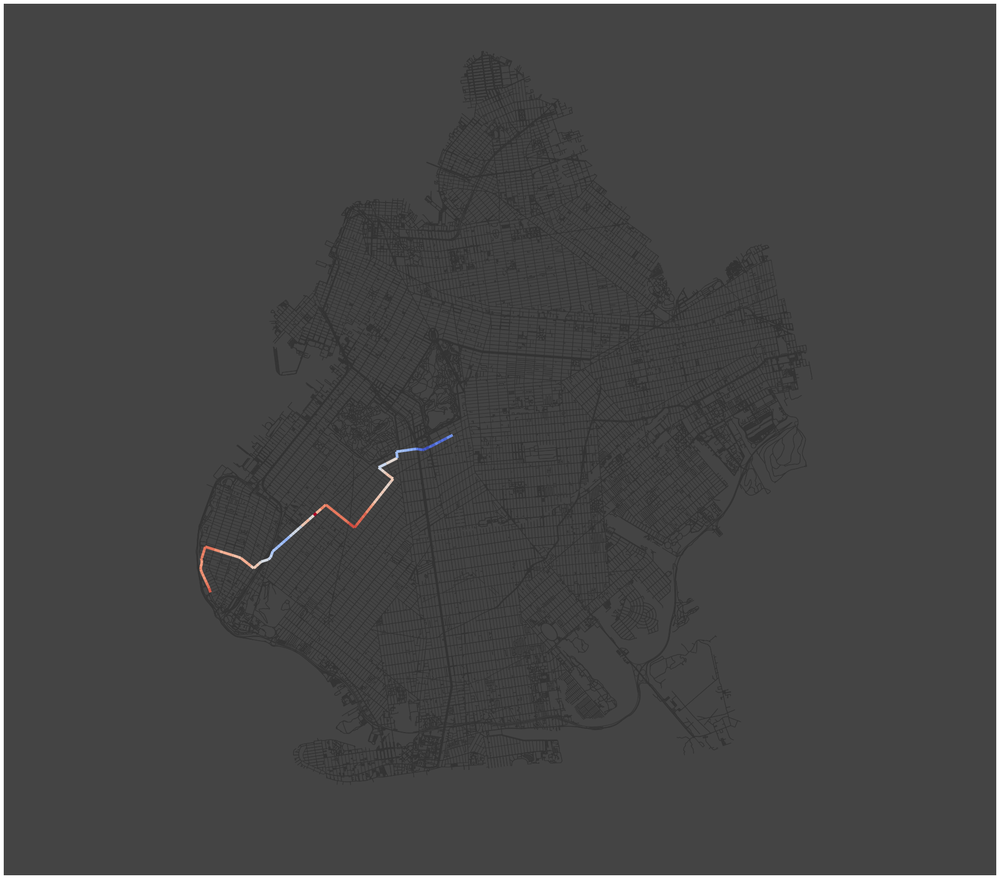

Completed b16 in 221.9299s

----------------------------------------
b25
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308626,00:58:00,FRONT ST / YORK ST,None,40.702514,-73.991915,None,None,0,None,POINT (-73.99192 40.70251)
1,308025,00:58:55,WATER ST/MAIN ST,None,40.703318,-73.991102,None,None,0,None,POINT (-73.99110 40.70332)
2,302355,01:00:19,OLD FULTON ST/ELIZABETH PL,None,40.702666,-73.993952,None,None,0,None,POINT (-73.99395 40.70267)
3,306437,01:00:49,OLD FULTON ST/HICKS ST,None,40.702029,-73.992747,None,None,0,None,POINT (-73.99275 40.70203)
4,302356,01:01:28,OLD FULTON ST/HENRY ST,None,40.701021,-73.991449,None,None,0,None,POINT (-73.99145 40.70102)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
37,307259,01:33:42,FULTON ST/THOMAS S BOYLAND ST,None,40.678336,-73.913138,None,None,0,None,POINT (-73.91314 40.67834)
38,307260,01:34:58,FULTON ST/ROCKAWAY AV,None,40.678189,-73.910359,None,None,0,None,POINT (-73.91036 40.67819)
39,307631,01:35:57,FULTON ST/EASTERN PY,None,40.678066,-73.908188,None,None,0,None,POINT (-73.90819 40.67807)
40,307263,01:38:04,FULTON ST/VAN SINDEREN AV,None,40.677816,-73.903542,None,None,0,None,POINT (-73.90354 40.67782)
41,901211,01:40:00,EAST NEW YORK AV/ALABAMA AV,None,40.676719,-73.900118,None,None,0,None,POINT (-73.90012 40.67672)


,trip_id,308626,308025,302355,306437,302356,302357,302359,302358,303011,...,307253,307254,307255,307256,307257,307259,307260,307631,307263,901211
0,EN_C1-Weekday-SDon-005800_B25_201,00:58:00,00:58:55,01:00:19,01:00:49,01:01:28,01:02:13,01:02:46,01:03:30,01:04:00,...,01:27:53,01:29:11,01:30:00,01:31:13,01:32:26,01:33:42,01:34:58,01:35:57,01:38:04,01:40:00
1,EN_C1-Weekday-SDon-014400_B25_201,02:24:00,02:24:46,02:25:56,02:26:21,02:26:53,02:27:31,02:27:58,02:28:35,02:29:00,...,02:49:53,02:51:11,02:52:00,02:52:59,02:53:57,02:54:57,02:55:58,02:56:45,02:58:27,03:00:00
2,EN_C1-Weekday-SDon-021800_B25_201,03:38:00,03:38:46,03:39:56,03:40:21,03:40:53,03:41:31,03:41:58,03:42:35,03:43:00,...,04:03:53,04:05:11,04:06:00,04:06:59,04:07:57,04:08:57,04:09:58,04:10:45,04:12:27,04:14:00
3,EN_C1-Weekday-SDon-029200_B25_201,04:52:00,04:52:46,04:53:56,04:54:21,04:54:53,04:55:31,04:55:58,04:56:35,04:57:00,...,05:17:53,05:19:11,05:20:00,05:20:59,05:21:57,05:22:57,05:23:58,05:24:45,05:26:27,05:28:00
4,EN_C1-Weekday-SDon-033200_Q56_453,05:32:00,05:33:04,05:34:42,05:35:17,05:36:02,05:36:55,05:37:34,05:38:25,05:39:00,...,06:03:37,06:05:05,06:06:00,06:07:13,06:08:26,06:09:42,06:10:58,06:11:57,06:14:04,06:16:00


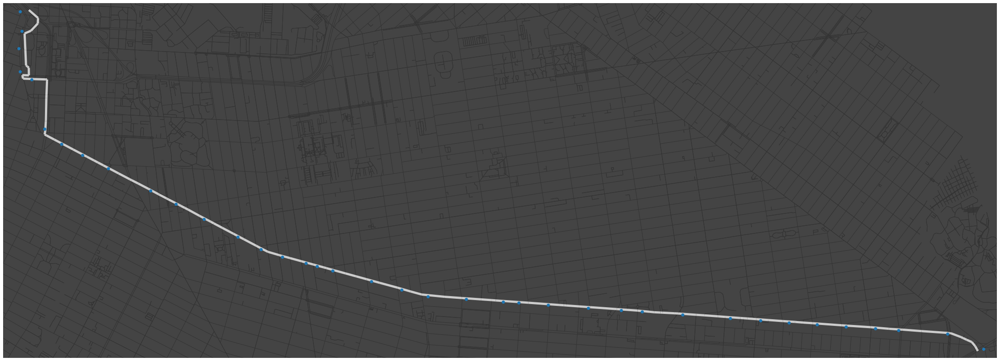

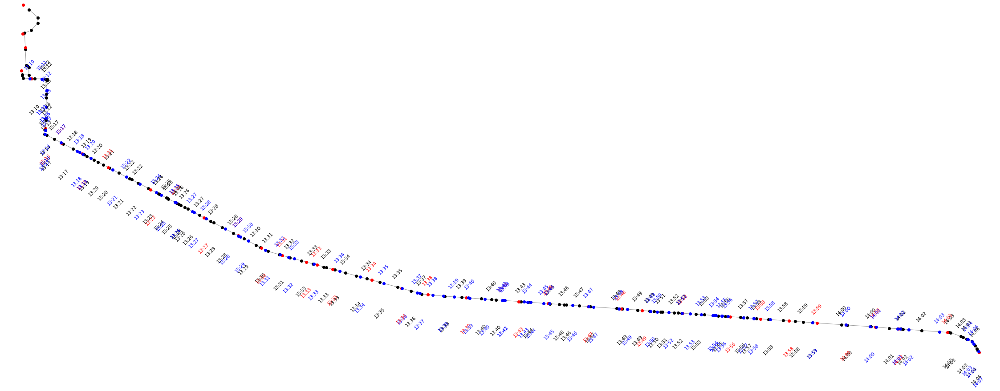

100%|██████████| 42/42 [06:31<00:00,  9.33s/it]


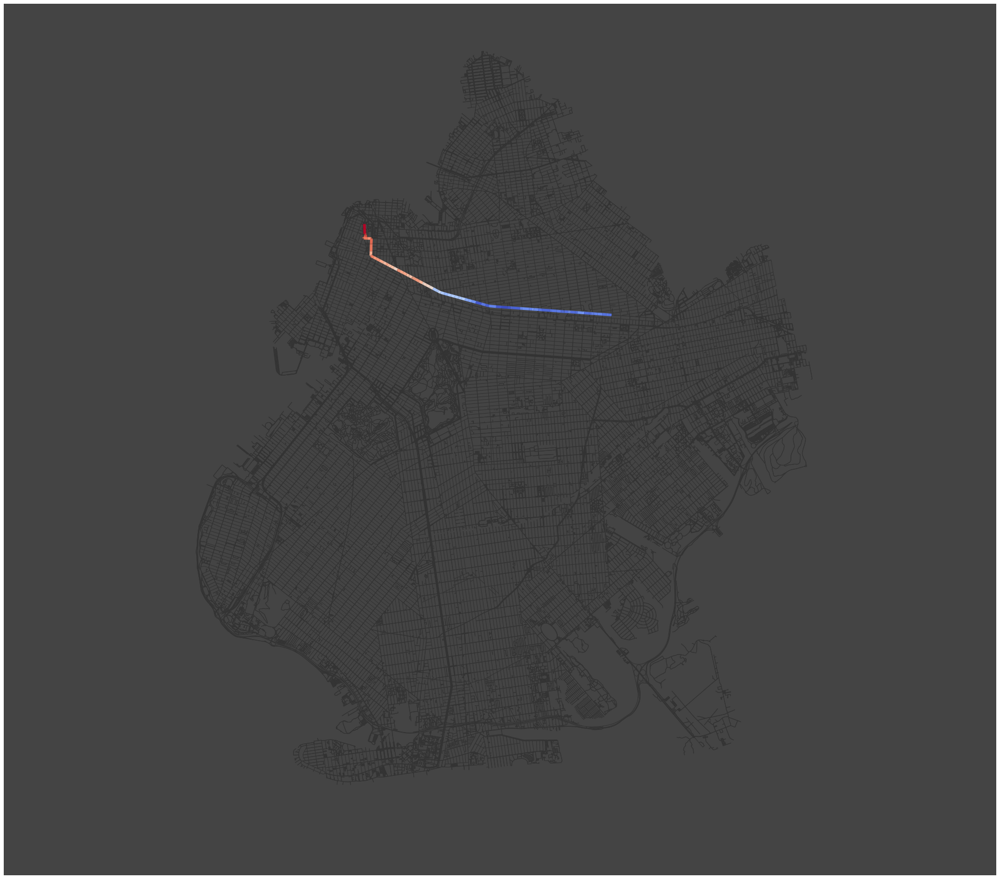

Completed b25 in 419.6618s

----------------------------------------
b26
----------------------------------------




,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307175,03:25:00,CADMAN PZ W/TILLARY ST,None,40.695988,-73.991009,None,None,0,None,POINT (-73.99101 40.69599)
1,307699,03:26:07,TILLARY ST/ADAMS ST,None,40.696035,-73.988147,None,None,0,None,POINT (-73.98815 40.69604)
2,307426,03:26:35,JAY ST/TILLARY ST,None,40.695699,-73.987196,None,None,0,None,POINT (-73.98720 40.69570)
3,302445,03:28:03,JAY ST/WILLOUGHBY ST,None,40.692314,-73.987319,None,None,0,None,POINT (-73.98732 40.69231)
4,307491,03:29:05,FULTON ST/HOYT ST,None,40.690690,-73.985547,None,None,0,None,POINT (-73.98555 40.69069)


,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
38,302483,03:57:00,HALSEY ST/WYCKOFF AV,None,40.696006,-73.905023,None,None,0,None,POINT (-73.90502 40.69601)
39,302484,03:57:27,WYCKOFF AV/WEIRFIELD ST,None,40.696820,-73.906168,None,None,0,None,POINT (-73.90617 40.69682)
40,302485,03:57:58,WYCKOFF AV/JEFFERSON AV,None,40.697633,-73.907628,None,None,0,None,POINT (-73.90763 40.69763)
41,801052,03:58:58,ridgewood pl/madison st,None,40.697906,-73.910173,None,None,0,None,POINT (-73.91017 40.69791)
42,901502,04:00:00,WYCKOFF AV / PALMETTO ST,None,40.699291,-73.910755,None,None,0,None,POINT (-73.91075 40.69929)


,trip_id,307175,307699,307426,302445,307491,302947,303017,302368,302369,...,302478,302479,302480,302481,302482,302483,302484,302485,801052,901502
0,FP_C1-Weekday-SDon-020500_B26_201,03:25:00,03:26:07,03:26:35,03:28:03,03:29:05,03:30:00,03:31:18,03:32:05,03:32:57,...,03:53:37,03:54:18,03:55:01,03:55:40,03:56:25,03:57:00,03:57:27,03:57:58,03:58:58,04:00:00
1,FP_C1-Weekday-SDon-032000_B26_201,05:20:00,05:21:07,05:21:35,05:23:03,05:24:05,05:25:00,05:26:18,05:27:05,05:27:57,...,05:52:13,05:53:10,05:54:09,05:55:03,05:56:04,05:56:52,05:57:29,05:58:12,05:59:35,06:01:00
2,FP_C1-Weekday-SDon-039100_B26_205,06:31:00,06:32:20,06:32:55,06:34:40,06:35:55,06:37:00,06:38:38,06:39:36,06:40:41,...,07:09:13,07:10:10,07:11:09,07:12:03,07:13:04,07:13:52,07:14:29,07:15:12,07:16:35,07:18:00
3,FP_C1-Weekday-SDon-041100_B26_206,06:51:00,06:52:20,06:52:55,06:54:40,06:55:55,06:57:00,06:58:38,06:59:36,07:00:41,...,07:31:13,07:32:10,07:33:09,07:34:03,07:35:04,07:35:52,07:36:29,07:37:12,07:38:35,07:40:00
4,FP_C1-Weekday-SDon-043100_B26_207,07:11:00,07:12:20,07:12:55,07:14:40,07:15:55,07:17:00,07:18:38,07:19:36,07:20:41,...,07:51:25,07:52:27,07:53:32,07:54:31,07:55:37,07:56:29,07:57:10,07:57:57,07:59:27,08:01:00


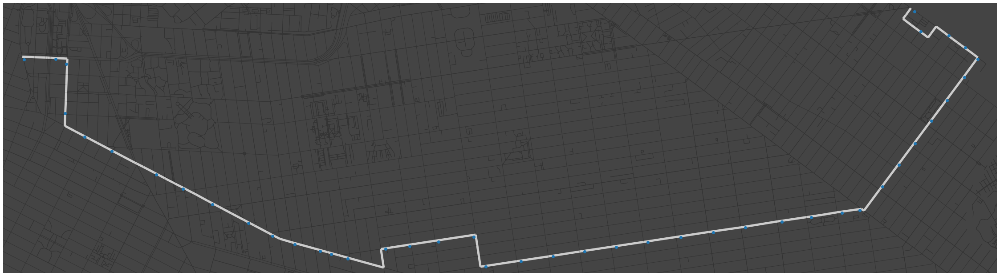

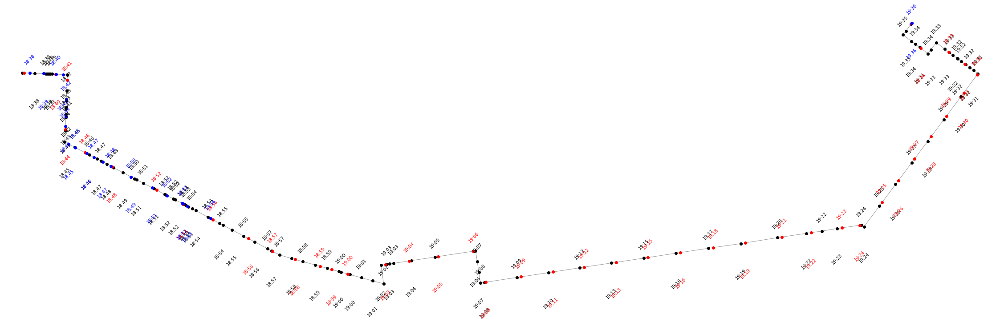

100%|██████████| 33/33 [05:53<00:00, 10.70s/it]


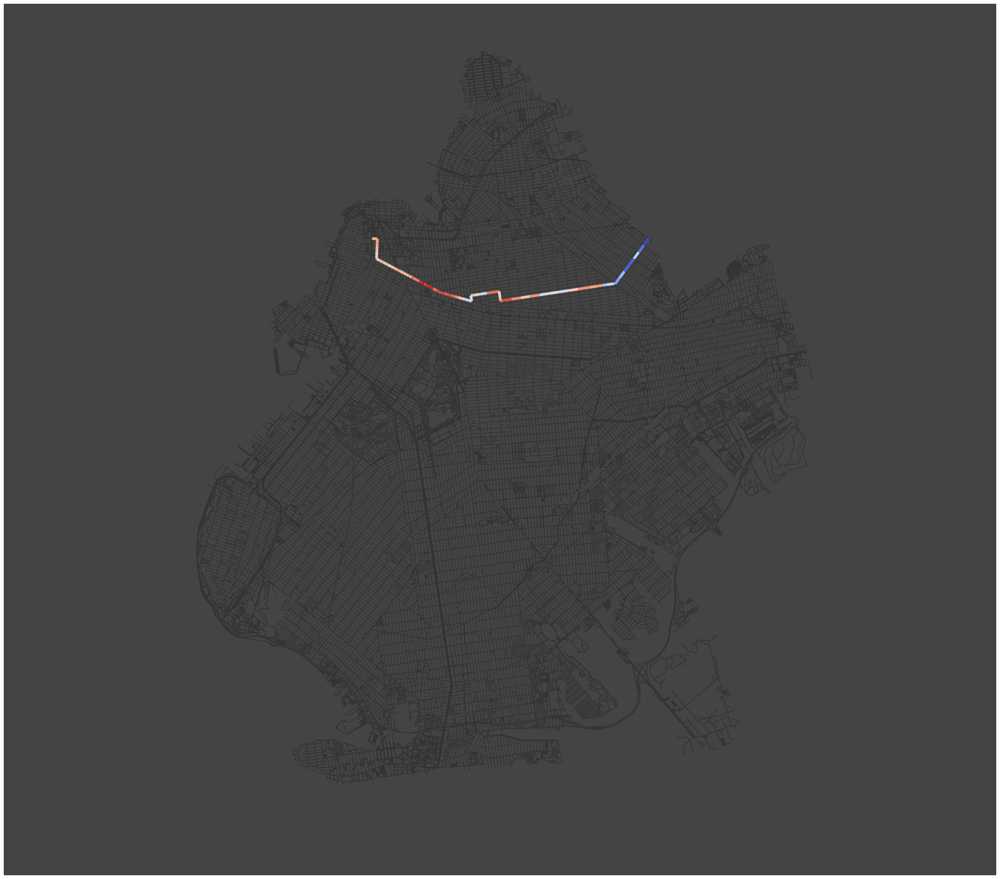

Completed b26 in 379.8229s

----------------------------------------
b35
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308194,00:30:00,39 ST/1 AV,None,40.656155,-74.012027,None,None,0,None,POINT (-74.01203 40.65615)
1,302678,00:30:43,39 ST/2 AV,None,40.654972,-74.010181,None,None,0,None,POINT (-74.01018 40.65497)
2,302679,00:31:21,39 ST/3 AV,None,40.653960,-74.008495,None,None,0,None,POINT (-74.00849 40.65396)
3,302680,00:32:21,39 ST/4 AV,None,40.652335,-74.005795,None,None,0,None,POINT (-74.00580 40.65234)
4,302681,00:33:00,39 ST/5 AV,None,40.651303,-74.004083,None,None,0,None,POINT (-74.00408 40.65130)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
42,308230,01:09:27,E 98 ST/HEGEMAN AV,None,40.655642,-73.912518,None,None,0,None,POINT (-73.91252 40.65564)
43,307115,01:10:34,HEGEMAN AV/THOMAS S BOYLAND ST,None,40.655881,-73.909480,None,None,0,None,POINT (-73.90948 40.65588)
44,301132,01:11:31,HEGEMAN AV/ROCKAWAY AV,None,40.656280,-73.906863,None,None,0,None,POINT (-73.90686 40.65628)
45,301133,01:12:10,HEGEMAN AV/OSBORN ST,None,40.656548,-73.905046,None,None,0,None,POINT (-73.90505 40.65655)
46,901518,01:13:00,HEGEMAN AV/WATKINS ST,None,40.656994,-73.904007,None,None,0,None,POINT (-73.90401 40.65699)


,trip_id,308194,302678,302679,302680,302681,302682,302683,302684,306636,...,302719,306838,302722,302723,302724,308230,307115,301132,301133,901518
0,JG_C1-Weekday-SDon-003000_B35_501,00:30:00,00:30:43,00:31:21,00:32:21,00:33:00,00:33:45,00:34:22,00:35:00,00:35:51,...,01:05:00,01:06:02,01:07:22,01:08:07,01:08:31,01:09:27,01:10:34,01:11:31,01:12:10,01:13:00
1,JG_C1-Weekday-SDon-008000_B35_502,01:20:00,01:20:43,01:21:21,01:22:21,01:23:00,01:23:45,01:24:22,01:25:00,01:25:51,...,01:55:00,01:56:02,01:57:22,01:58:07,01:58:31,01:59:27,02:00:34,02:01:31,02:02:10,02:03:00
2,JG_C1-Weekday-SDon-013000_B35_501,02:10:00,02:10:43,02:11:21,02:12:21,02:13:00,02:13:45,02:14:22,02:15:00,02:15:51,...,02:44:00,02:45:02,02:46:22,02:47:07,02:47:31,02:48:27,02:49:34,02:50:31,02:51:10,02:52:00
3,JG_C1-Weekday-SDon-018000_B35_502,03:00:00,03:00:43,03:01:21,03:02:21,03:03:00,03:03:45,03:04:22,03:05:00,03:05:51,...,03:33:00,03:34:02,03:35:22,03:36:07,03:36:31,03:37:27,03:38:34,03:39:31,03:40:10,03:41:00
4,JG_C1-Weekday-022500_B35_503,03:45:00,03:45:43,03:46:21,03:47:21,03:48:00,03:48:45,03:49:22,03:50:00,03:50:51,...,04:18:00,04:19:02,04:20:22,04:21:07,04:21:31,04:22:27,04:23:34,04:24:31,04:25:10,04:26:00


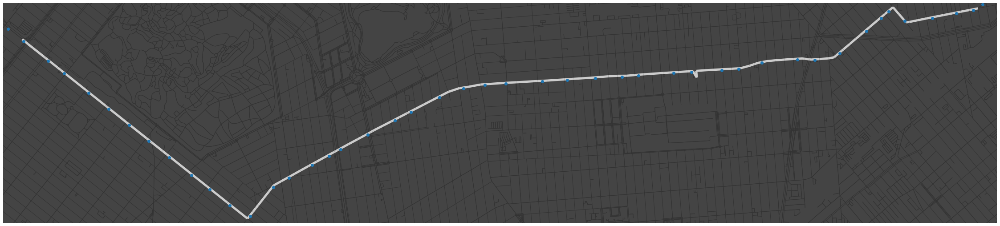

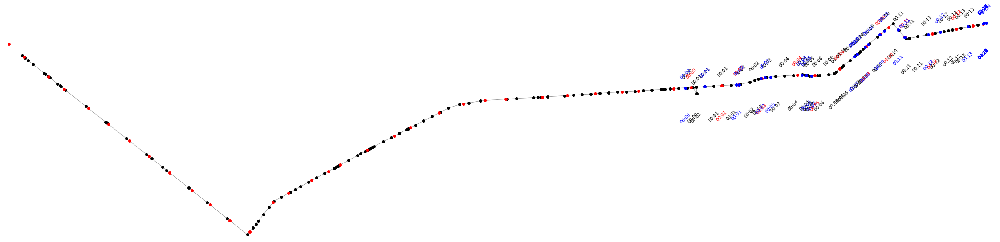

100%|██████████| 34/34 [07:59<00:00, 14.11s/it]


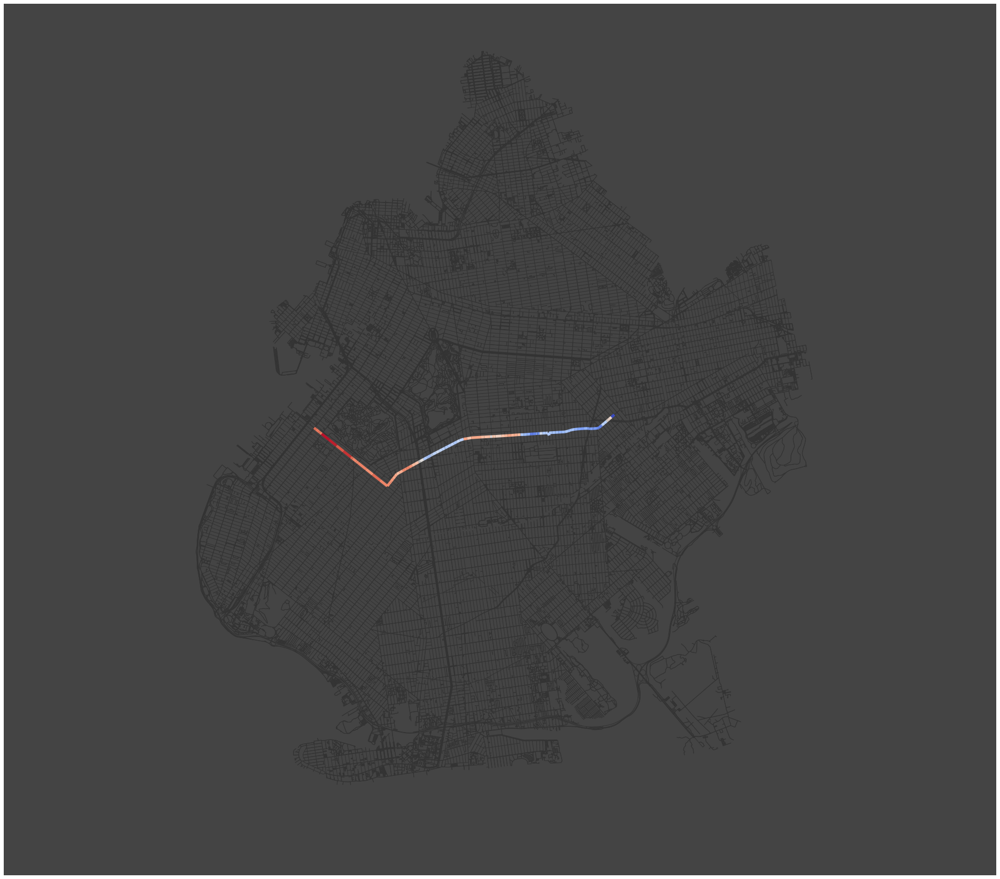

Completed b35 in 509.0610s

----------------------------------------
b37
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308570,05:00:00,4 AV/DEAN ST,None,40.683264,-73.979275,None,None,0,None,POINT (-73.97928 40.68326)
1,901485,05:01:48,3 AV/WARREN ST,None,40.681953,-73.983075,None,None,0,None,POINT (-73.98307 40.68195)
2,302955,05:02:25,3 AV/BUTLER ST,None,40.680635,-73.983974,None,None,0,None,POINT (-73.98397 40.68064)
3,302956,05:03:00,3 AV/DE GRAW ST,None,40.679356,-73.984843,None,None,0,None,POINT (-73.98484 40.67936)
4,302957,05:03:34,3 AV/UNION ST,None,40.678110,-73.985687,None,None,0,None,POINT (-73.98569 40.67811)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
35,308269,05:31:23,3 AV/95 ST,None,40.616997,-74.033765,None,None,0,None,POINT (-74.03377 40.61700)
36,901492,05:31:56,3 AV/97 ST,None,40.615509,-74.034401,None,None,0,None,POINT (-74.03440 40.61551)
37,301724,05:32:59,4 AV/99 ST,None,40.613509,-74.033120,None,None,0,None,POINT (-74.03312 40.61351)
38,301725,05:33:22,4 AV/100 ST,None,40.612591,-74.033902,None,None,0,None,POINT (-74.03390 40.61259)
39,901445,05:34:00,SHORE RD/4 AV,None,40.611716,-74.035076,None,None,0,None,POINT (-74.03508 40.61172)


,trip_id,308570,901485,302955,302956,302957,308263,302960,308746,302962,...,308267,302999,303000,308268,303003,308269,901492,301724,301725,901445
0,JG_C1-Weekday-SDon-030000_B37_602,05:00:00,05:01:48,05:02:25,05:03:00,05:03:34,05:04:57,05:05:50,05:07:00,05:07:40,...,05:27:05,05:27:57,05:29:00,05:29:50,05:30:35,05:31:23,05:31:56,05:32:59,05:33:22,05:34:00
1,JG_C1-Weekday-SDon-033000_B37_604,05:30:00,05:31:48,05:32:25,05:33:00,05:33:34,05:34:57,05:35:50,05:37:00,05:37:40,...,05:57:05,05:57:57,05:59:00,05:59:50,06:00:35,06:01:23,06:01:56,06:02:59,06:03:22,06:04:00
2,JG_C1-Weekday-SDon-036000_B37_601,06:00:00,06:01:48,06:02:25,06:03:00,06:03:34,06:04:57,06:05:50,06:07:00,06:07:45,...,06:31:18,06:32:31,06:34:00,06:34:50,06:35:35,06:36:23,06:36:56,06:37:59,06:38:22,06:39:00
3,JG_C1-Weekday-SDon-038500_B37_603,06:25:00,06:26:48,06:27:25,06:28:00,06:28:34,06:29:57,06:30:50,06:32:00,06:32:45,...,06:56:18,06:57:31,06:59:00,06:59:50,07:00:35,07:01:23,07:01:56,07:02:59,07:03:22,07:04:00
4,JG_C1-Weekday-040500_B37_602,06:45:00,06:46:48,06:47:25,06:48:00,06:48:34,06:49:57,06:50:50,06:52:00,06:52:45,...,07:19:55,07:21:19,07:23:00,07:24:00,07:24:54,07:25:51,07:26:31,07:27:46,07:28:14,07:29:00


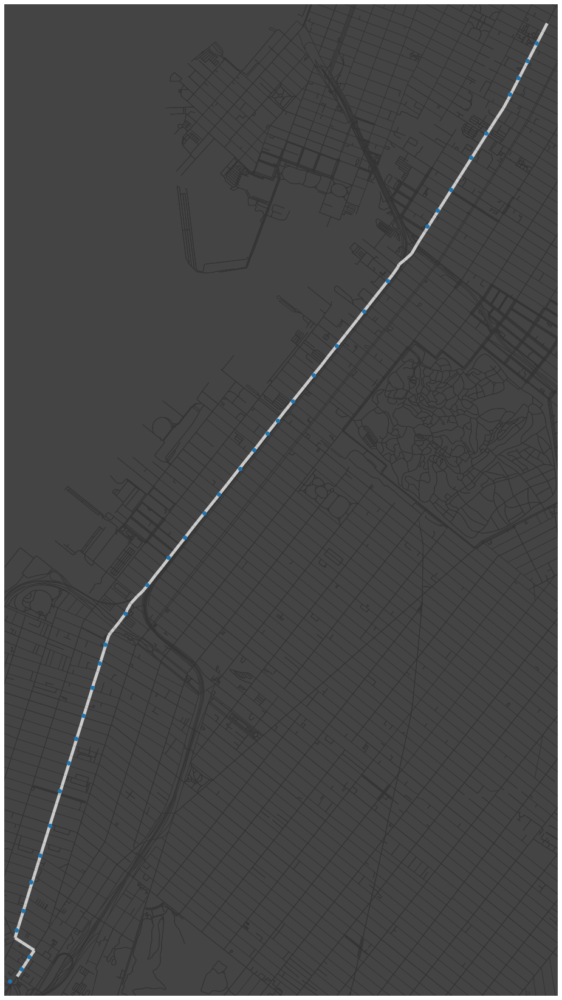

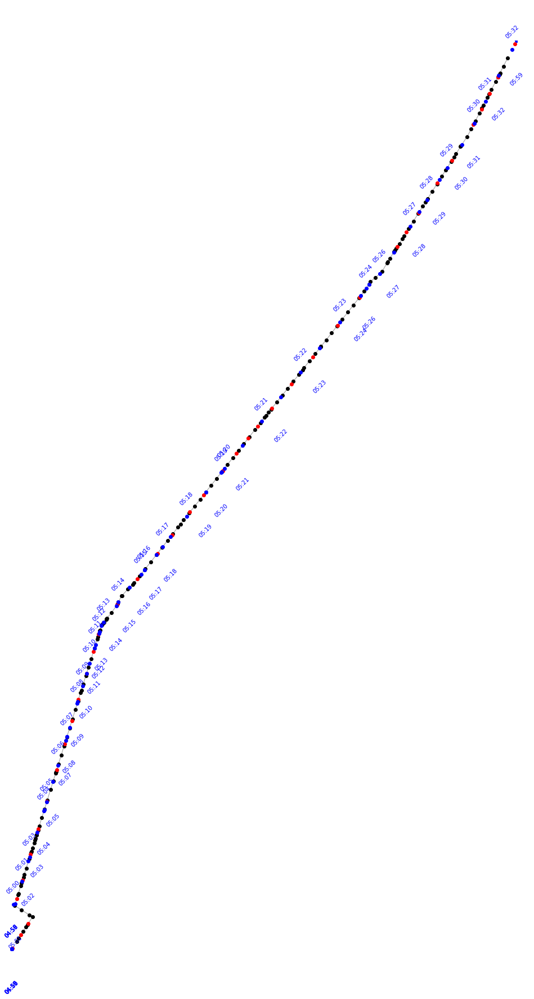

 69%|██████▉   | 11/16 [01:19<00:36,  7.23s/it]

fail
Experienced error
Completed b37 in 96.9590s

----------------------------------------
b43
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305287,01:45:00,BOX ST/MANHATTAN AV,None,40.737195,-73.955670,None,None,0,None,POINT (-73.95567 40.73719)
1,308189,01:45:30,MANHATTAN AV/CLAY ST,None,40.736239,-73.955350,None,None,0,None,POINT (-73.95535 40.73624)
2,305167,01:46:24,MANHATTAN AV/FREEMAN ST,None,40.734065,-73.954997,None,None,0,None,POINT (-73.95500 40.73407)
3,308188,01:47:06,MANHATTAN AV/INDIA ST,None,40.732402,-73.954724,None,None,0,None,POINT (-73.95472 40.73240)
4,305170,01:48:10,MANHATTAN AV/GREENPOINT AV,None,40.729832,-73.954159,None,None,0,None,POINT (-73.95416 40.72983)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
45,303788,02:18:03,EMPIRE BL/NOSTRAND AV,None,40.663963,-73.951411,None,None,0,None,POINT (-73.95141 40.66396)
46,303789,02:18:46,EMPIRE BL/ROGERS AV,None,40.663748,-73.953766,None,None,0,None,POINT (-73.95377 40.66375)
47,303790,02:19:56,EMPIRE BL/BEDFORD AV,None,40.663526,-73.957647,None,None,0,None,POINT (-73.95765 40.66353)
48,303791,02:21:00,WASHINGTON AV/EMPIRE BL,None,40.663103,-73.960971,None,None,0,None,POINT (-73.96097 40.66310)
49,801030,02:22:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,305287,308189,305167,308188,305170,305171,305172,305173,305174,...,303783,303784,303785,303786,303787,303788,303789,303790,303791,801030
0,JG_C1-Weekday-SDon-010500_B43_451,01:45:00,01:45:30,01:46:24,01:47:06,01:48:10,01:49:03,01:49:31,01:50:16,01:51:00,...,02:14:42,02:15:20,02:16:00,02:16:21,02:17:12,02:18:03,02:18:46,02:19:56,02:21:00,02:22:00
1,JG_C1-Weekday-015000_B43_452,02:30:00,02:30:25,02:31:10,02:31:45,02:32:38,02:33:22,02:33:46,02:34:23,02:35:00,...,02:56:42,02:57:20,02:58:00,02:58:21,02:59:12,03:00:03,03:00:46,03:01:56,03:03:00,03:04:00
2,JG_C1-Weekday-SDon-019500_B43_451,03:15:00,03:15:30,03:16:24,03:17:06,03:18:10,03:19:03,03:19:31,03:20:16,03:21:00,...,03:43:42,03:44:20,03:45:00,03:45:21,03:46:12,03:47:03,03:47:46,03:48:56,03:50:00,03:51:00
3,JG_C1-Weekday-SDon-024000_B43_452,04:00:00,04:00:30,04:01:24,04:02:06,04:03:10,04:04:03,04:04:31,04:05:16,04:06:00,...,04:28:42,04:29:20,04:30:00,04:30:21,04:31:12,04:32:03,04:32:46,04:33:56,04:35:00,04:37:00
4,JG_C1-Weekday-028500_B43_453,04:45:00,04:45:30,04:46:24,04:47:06,04:48:10,04:49:03,04:49:31,04:50:16,04:51:00,...,05:20:02,05:21:01,05:22:00,05:22:21,05:23:12,05:24:03,05:24:46,05:25:56,05:27:00,05:29:00


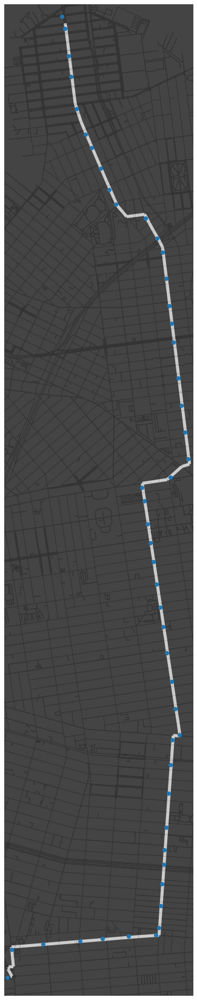

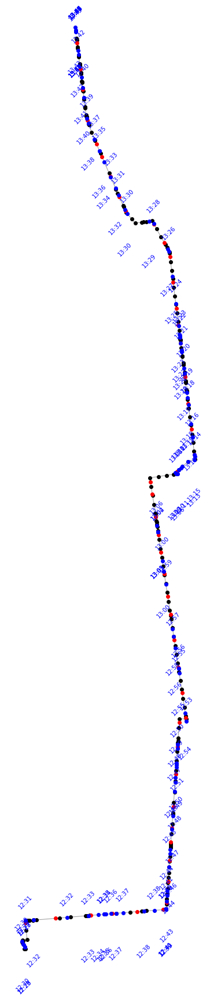

 35%|███▌      | 11/31 [01:18<02:23,  7.16s/it]

fail
Experienced error
Completed b43 in 98.4062s

----------------------------------------
b44
----------------------------------------




,stop_id,FB_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307020,01:02:00,EMMONS AV/NOSTRAND AV,None,40.584026,-73.938440,None,None,0,None,POINT (-73.93844 40.58403)
1,300347,01:02:38,NOSTRAND AV/SHORE PY,None,40.585898,-73.939036,None,None,0,None,POINT (-73.93904 40.58590)
2,303434,01:03:07,NOSTRAND AV/VOORHIES AV,None,40.587608,-73.939283,None,None,0,None,POINT (-73.93928 40.58761)
3,302823,01:03:48,NOSTRAND AV/AV Z,None,40.589929,-73.939713,None,None,0,None,POINT (-73.93971 40.58993)
4,308122,01:04:24,NOSTRAND AV/AV Y,None,40.592022,-73.940115,None,None,0,None,POINT (-73.94012 40.59202)


,stop_id,FB_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
63,303421,01:42:22,BEDFORD AV/PARK AV,None,40.696680,-73.956472,None,None,0,None,POINT (-73.95647 40.69668)
64,303422,01:43:00,BEDFORD AV/FLUSHING AV,None,40.698884,-73.956915,None,None,0,None,POINT (-73.95691 40.69888)
65,303425,01:44:38,BEDFORD AV/HEWES ST,None,40.702845,-73.959584,None,None,0,None,POINT (-73.95958 40.70285)
66,303427,01:46:02,BEDFORD AV/TAYLOR ST,None,40.705825,-73.962904,None,None,0,None,POINT (-73.96290 40.70582)
67,901010,01:48:00,WILLIAMSBURG BR PLZ/LANE 4,None,40.709320,-73.959616,None,None,0,None,POINT (-73.95962 40.70932)


,trip_id,307020,300347,303434,302823,308122,302825,302826,302827,303440,...,303416,303417,303418,303419,303420,303421,303422,303425,303427,901010
0,FB_C1-Weekday-SDon-006200_B44_301,01:02:00,01:02:38,01:03:07,01:03:48,01:04:24,01:05:03,01:05:30,01:06:12,01:07:00,...,01:39:57,01:40:15,01:40:49,01:41:25,01:41:44,01:42:22,01:43:00,01:44:38,01:46:02,01:48:00
1,FB_C1-Weekday-SDon-012200_B44_302,02:02:00,02:02:38,02:03:07,02:03:48,02:04:24,02:05:03,02:05:30,02:06:12,02:07:00,...,02:39:57,02:40:15,02:40:49,02:41:25,02:41:44,02:42:22,02:43:00,02:44:38,02:46:02,02:48:00
2,FB_C1-Weekday-SDon-018200_B44_301,03:02:00,03:02:38,03:03:07,03:03:48,03:04:24,03:05:03,03:05:30,03:06:12,03:07:00,...,03:39:57,03:40:15,03:40:49,03:41:25,03:41:44,03:42:22,03:43:00,03:44:38,03:46:02,03:48:00
3,FB_C1-Weekday-SDon-024200_B44_302,04:02:00,04:02:38,04:03:07,04:03:48,04:04:24,04:05:03,04:05:30,04:06:12,04:07:00,...,04:41:26,04:41:48,04:42:27,04:43:09,04:43:31,04:44:16,04:45:00,04:46:38,04:48:02,04:50:00
4,FB_C1-Weekday-SDon-027000_B44_303,04:30:00,04:30:38,04:31:07,04:31:48,04:32:24,04:33:03,04:33:30,04:34:12,04:35:00,...,05:09:26,05:09:48,05:10:27,05:11:09,05:11:31,05:12:16,05:13:00,05:14:38,05:16:02,05:18:00


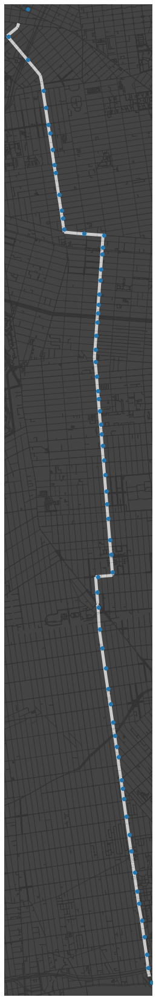

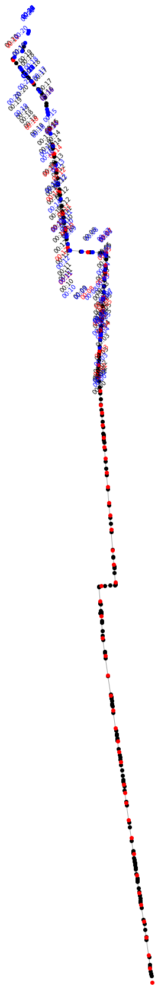

100%|██████████| 37/37 [05:41<00:00,  9.23s/it]


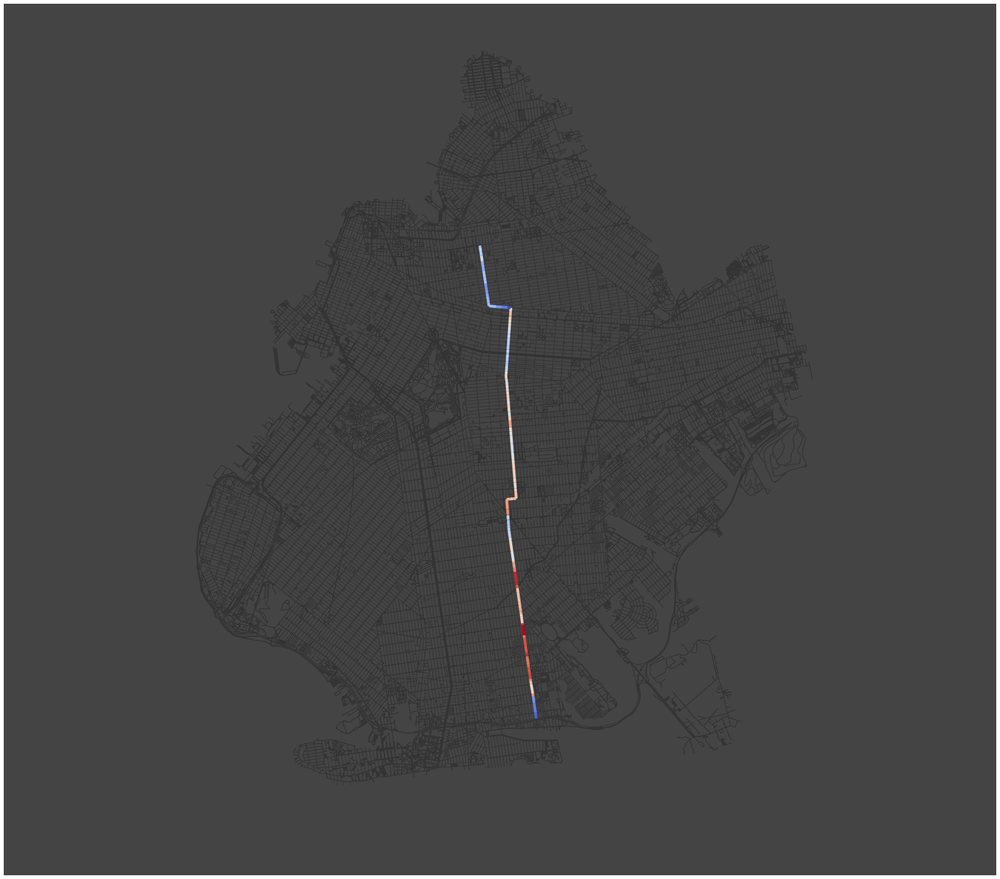

Completed b44 in 370.9142s

----------------------------------------
b48
----------------------------------------




,stop_id,GA_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,303791,01:02:00,WASHINGTON AV/EMPIRE BL,None,40.663103,-73.960971,None,None,0,None,POINT (-73.96097 40.66310)
1,303844,00:31:49,NASSAU AV/HAUSMAN ST,None,40.726183,-73.939109,None,None,0,None,POINT (-73.93911 40.72618)
2,303845,00:32:36,NASSAU AV/KINGSLAND AV,None,40.725927,-73.942029,None,None,0,None,POINT (-73.94203 40.72593)
3,303847,00:33:28,NASSAU AV/HUMBOLDT ST,None,40.725594,-73.945331,None,None,0,None,POINT (-73.94533 40.72559)
4,303848,00:34:08,NASSAU AV/NEWEL ST,None,40.724843,-73.947659,None,None,0,None,POINT (-73.94766 40.72484)


,stop_id,GA_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
41,307169,00:48:00,FRANKLIN AV/FLUSHING AV,None,40.698328,-73.958858,None,None,0,None,POINT (-73.95886 40.69833)
42,307553,00:51:55,FRANKLIN AV/GREENE AV,None,40.687399,-73.956963,None,None,0,None,POINT (-73.95696 40.68740)
43,307632,00:30:57,NASSAU AV/VARICK ST,None,40.726541,-73.936230,None,None,0,None,POINT (-73.93623 40.72654)
44,308073,00:54:00,FRANKLIN AV/FULTON ST,None,40.680595,-73.955606,None,None,0,None,POINT (-73.95561 40.68059)
45,801030,01:04:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,303791,303844,303845,303847,303848,303849,303850,303852,303853,...,303886,303887,303888,305175,306480,307169,307553,307632,308073,801030
0,GA_C1-Weekday-SDon-003000_B48_501,01:02:00,00:31:49,00:32:36,00:33:28,00:34:08,00:34:36,00:35:00,00:36:56,00:37:44,...,00:59:44,01:00:31,01:01:32,00:35:38,00:30:00,00:48:00,00:51:55,00:30:57,00:54:00,01:04:00
1,GA_C1-Weekday-007500_B48_502,01:47:00,01:16:49,01:17:36,01:18:28,01:19:08,01:19:36,01:20:00,01:21:56,01:22:44,...,01:44:44,01:45:31,01:46:32,01:20:38,01:15:00,01:33:00,01:36:55,01:15:57,01:39:00,01:49:00
2,GA_C1-Weekday-SDon-012000_B48_501,02:32:00,02:01:49,02:02:36,02:03:28,02:04:08,02:04:36,02:05:00,02:06:56,02:07:44,...,02:29:44,02:30:31,02:31:32,02:05:38,02:00:00,02:18:00,02:21:55,02:00:57,02:24:00,02:34:00
3,GA_C1-Weekday-SDon-016500_B48_502,03:17:00,02:46:49,02:47:36,02:48:28,02:49:08,02:49:36,02:50:00,02:51:56,02:52:44,...,03:14:44,03:15:31,03:16:32,02:50:38,02:45:00,03:03:00,03:06:55,02:45:57,03:09:00,03:19:00
4,GA_C1-Weekday-021000_B48_501,04:04:00,03:32:11,03:33:07,03:34:10,03:34:58,03:35:31,03:36:00,03:37:56,03:38:44,...,04:01:44,04:02:31,04:03:32,03:36:38,03:30:00,03:50:00,03:53:55,03:31:08,03:56:00,04:06:00


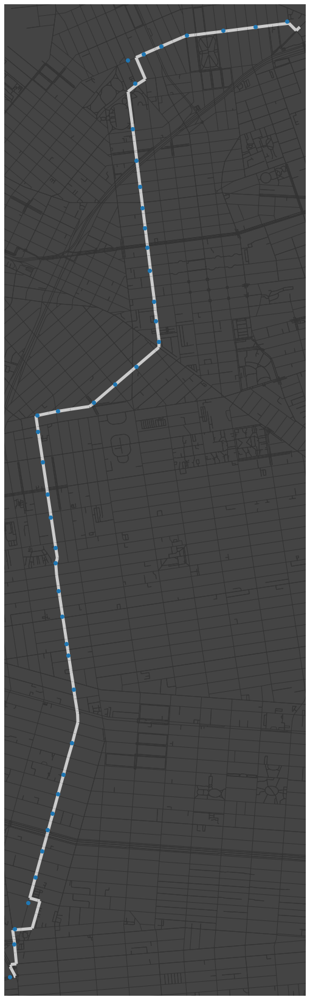

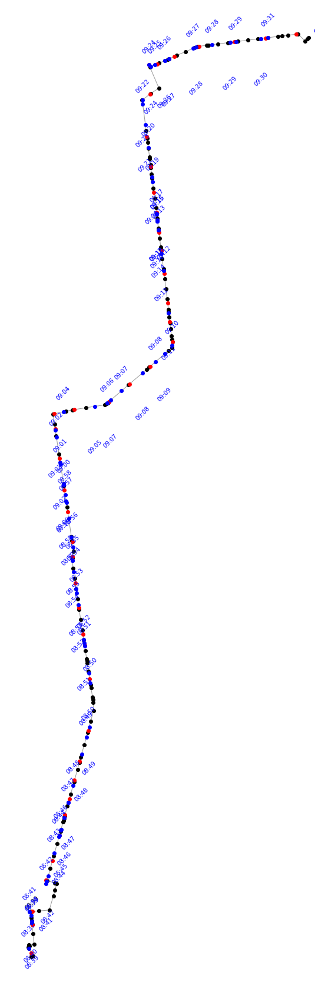

 37%|███▋      | 11/30 [00:50<01:26,  4.57s/it]

fail
Experienced error
Completed b48 in 67.4737s

----------------------------------------
b52
----------------------------------------




,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307175,03:13:00,CADMAN PZ W/TILLARY ST,None,40.695988,-73.991009,None,None,0,None,POINT (-73.99101 40.69599)
1,801145,03:13:52,Tillary St (not used),None,40.696080,-73.989453,None,None,0,None,POINT (-73.98945 40.69608)
2,307460,03:16:00,ADAMS ST/BKLYN SUPREME CRT,None,40.692560,-73.989131,None,None,0,None,POINT (-73.98913 40.69256)
3,302945,03:17:17,FULTON ST/SMITH ST,None,40.691480,-73.987534,None,None,0,None,POINT (-73.98753 40.69148)
4,307491,03:18:30,FULTON ST/HOYT ST,None,40.690690,-73.985547,None,None,0,None,POINT (-73.98555 40.69069)


,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
31,307689,03:42:36,GATES AV/CENTRAL AV,None,40.694104,-73.917491,None,None,0,None,POINT (-73.91749 40.69410)
32,307690,03:43:24,GATES AV/WILSON AV,None,40.695572,-73.916057,None,None,0,None,POINT (-73.91606 40.69557)
33,307691,03:44:13,GATES AV/KNICKERBOCKER AV,None,40.697040,-73.914567,None,None,0,None,POINT (-73.91457 40.69704)
34,304415,03:45:24,PALMETTO ST/IRVING AV,None,40.698200,-73.912261,None,None,0,None,POINT (-73.91226 40.69820)
35,801117,03:46:00,PALMETTO ST/WYCKOFF AV,None,40.699297,-73.911223,None,None,0,None,POINT (-73.91122 40.69930)


,trip_id,307175,801145,307460,302945,307491,302947,303017,302368,302369,...,307684,307901,307686,307687,307688,307689,307690,307691,304415,801117
0,FP_C1-Weekday-SDon-019300_B52_301,03:13:00,03:13:52,03:16:00,03:17:17,03:18:30,03:20:00,03:21:20,03:22:07,03:23:00,...,03:38:32,03:39:24,03:40:00,03:40:58,03:41:38,03:42:36,03:43:24,03:44:13,03:45:24,03:46:00
1,FP_C1-Weekday-025300_B52_302,04:13:00,04:13:52,04:16:00,04:17:17,04:18:30,04:20:00,04:21:20,04:22:07,04:23:00,...,04:38:32,04:39:24,04:40:00,04:40:58,04:41:38,04:42:36,04:43:24,04:44:13,04:45:24,04:46:00
2,FP_C1-Weekday-SDon-031000_B52_304,05:10:00,05:10:52,05:13:00,05:14:17,05:15:30,05:17:00,05:18:20,05:19:07,05:20:00,...,05:35:32,05:36:24,05:37:00,05:37:58,05:38:38,05:39:36,05:40:24,05:41:13,05:42:24,05:43:00
3,FP_C1-Weekday-SDon-035000_B52_302,05:50:00,05:50:52,05:53:00,05:54:17,05:55:30,05:57:00,05:58:20,05:59:07,06:00:00,...,06:21:03,06:22:12,06:23:00,06:23:58,06:24:38,06:25:36,06:26:24,06:27:13,06:28:24,06:29:00
4,FP_C1-Weekday-SDon-038200_B52_306,06:22:00,06:23:09,06:26:00,06:26:58,06:27:52,06:29:00,06:31:13,06:32:32,06:34:00,...,06:55:03,06:56:12,06:57:00,06:57:58,06:58:38,06:59:36,07:00:24,07:01:13,07:02:24,07:03:00


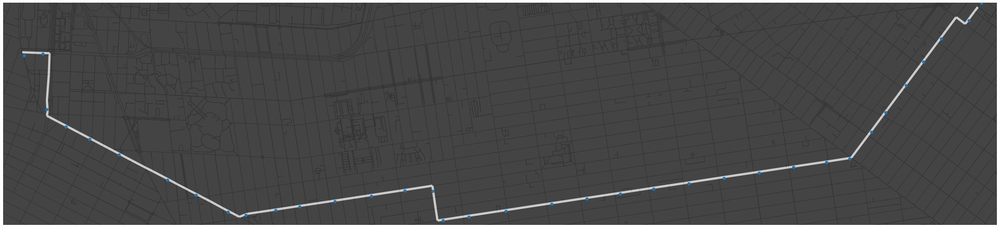

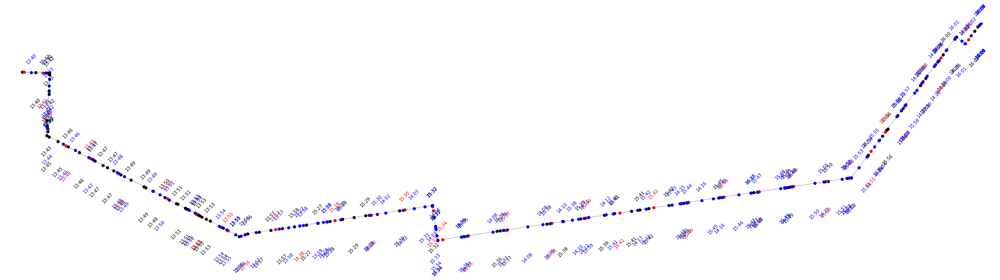

100%|██████████| 38/38 [06:55<00:00, 10.94s/it]


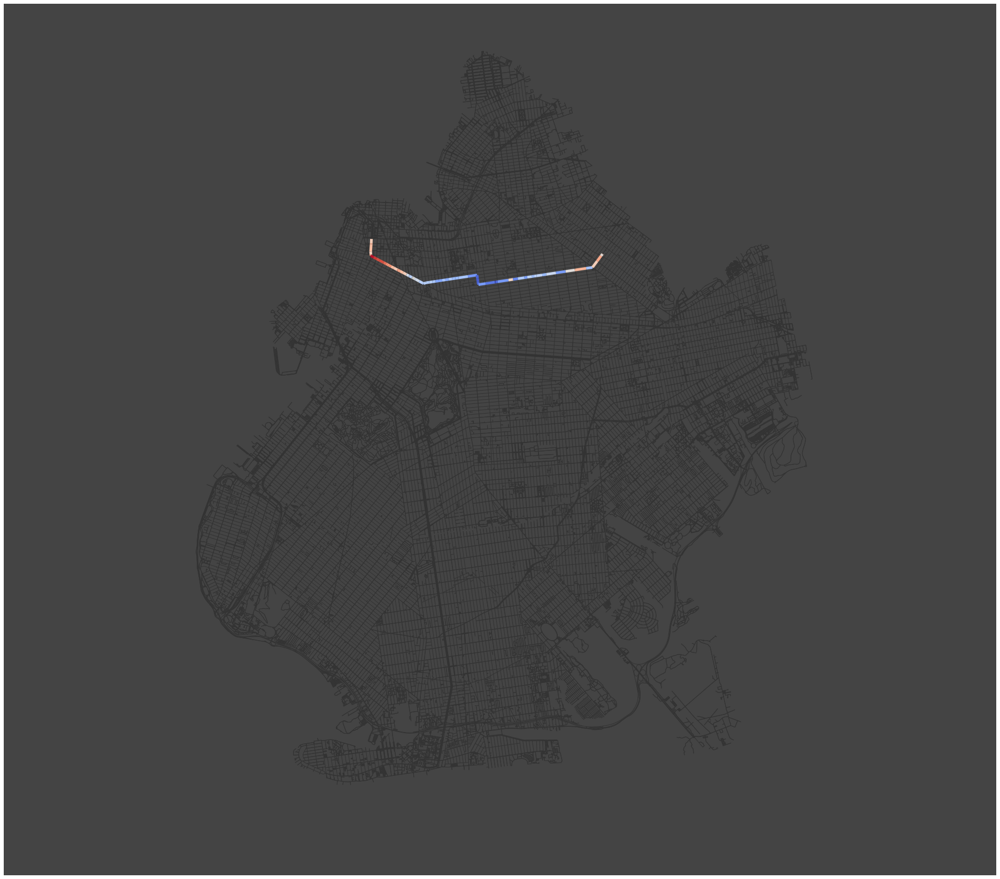

Completed b52 in 445.5587s

----------------------------------------
b61
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,306328,00:20:00,SMITH ST/FULTON ST,None,40.691209,-73.987376,None,None,0,None,POINT (-73.98738 40.69121)
1,307408,00:21:13,BOERUM PL/JORALEMON ST,None,40.692022,-73.989228,None,None,0,None,POINT (-73.98923 40.69202)
2,305396,00:23:28,ATLANTIC AV/BOERUM PL,None,40.689271,-73.991016,None,None,0,None,POINT (-73.99102 40.68927)
3,305397,00:24:18,ATLANTIC AV/COURT ST,None,40.689806,-73.992532,None,None,0,None,POINT (-73.99253 40.68981)
4,305216,00:25:28,ATLANTIC AV/CLINTON ST,None,40.690391,-73.994744,None,None,0,None,POINT (-73.99474 40.69039)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
36,306890,00:50:55,PROSPECT PK W/PROSPECT AV,None,40.658570,-73.982065,None,None,0,None,POINT (-73.98207 40.65857)
37,307227,00:51:17,PROSPECT PK W/18 ST,None,40.657486,-73.983208,None,None,0,None,POINT (-73.98321 40.65749)
38,305858,00:51:28,PROSPECT PK W/19 ST,None,40.656940,-73.983781,None,None,0,None,POINT (-73.98378 40.65694)
39,307521,00:52:23,19 ST/8 AV,None,40.658211,-73.985302,None,None,0,None,POINT (-73.98530 40.65821)
40,801136,00:53:00,PROSPECT PARK WEST/18 ST,None,40.657574,-73.982948,None,None,0,None,POINT (-73.98295 40.65757)


,trip_id,306328,307408,305396,305397,305216,305217,308647,308049,308564,...,306072,305852,305853,306075,305855,306890,307227,305858,307521,801136
0,JG_C1-Weekday-SDon-002000_B61_801,00:20:00,00:21:13,00:23:28,00:24:18,00:25:28,00:26:12,00:27:00,00:28:14,00:28:37,...,00:48:08,00:48:51,00:49:31,00:50:00,00:50:26,00:50:55,00:51:17,00:51:28,00:52:23,00:53:00
1,JG_C1-Weekday-SDon-006000_B61_802,01:00:00,01:01:13,01:03:28,01:04:18,01:05:28,01:06:12,01:07:00,01:08:14,01:08:37,...,01:28:08,01:28:51,01:29:31,01:30:00,01:30:26,01:30:55,01:31:17,01:31:28,01:32:23,01:33:00
2,JG_C1-Weekday-SDon-010000_B61_801,01:40:00,01:41:13,01:43:28,01:44:18,01:45:28,01:46:12,01:47:00,01:48:14,01:48:37,...,02:08:08,02:08:51,02:09:31,02:10:00,02:10:26,02:10:55,02:11:17,02:11:28,02:12:23,02:13:00
3,JG_C1-Weekday-SDon-014000_B61_802,02:20:00,02:21:13,02:23:28,02:24:18,02:25:28,02:26:12,02:27:00,02:28:14,02:28:37,...,02:48:08,02:48:51,02:49:31,02:50:00,02:50:26,02:50:55,02:51:17,02:51:28,02:52:23,02:53:00
4,JG_C1-Weekday-SDon-018000_B61_801,03:00:00,03:01:13,03:03:28,03:04:18,03:05:28,03:06:12,03:07:00,03:08:14,03:08:37,...,03:28:08,03:28:51,03:29:31,03:30:00,03:30:34,03:31:14,03:31:42,03:31:57,03:33:11,03:34:00


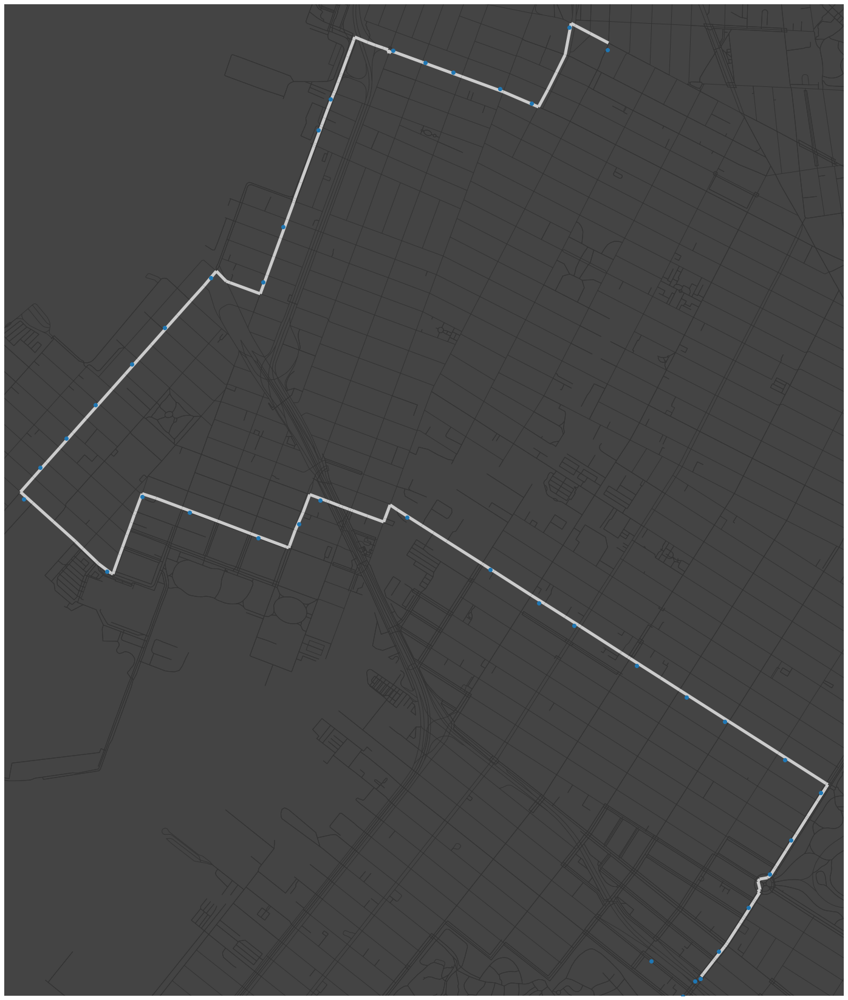

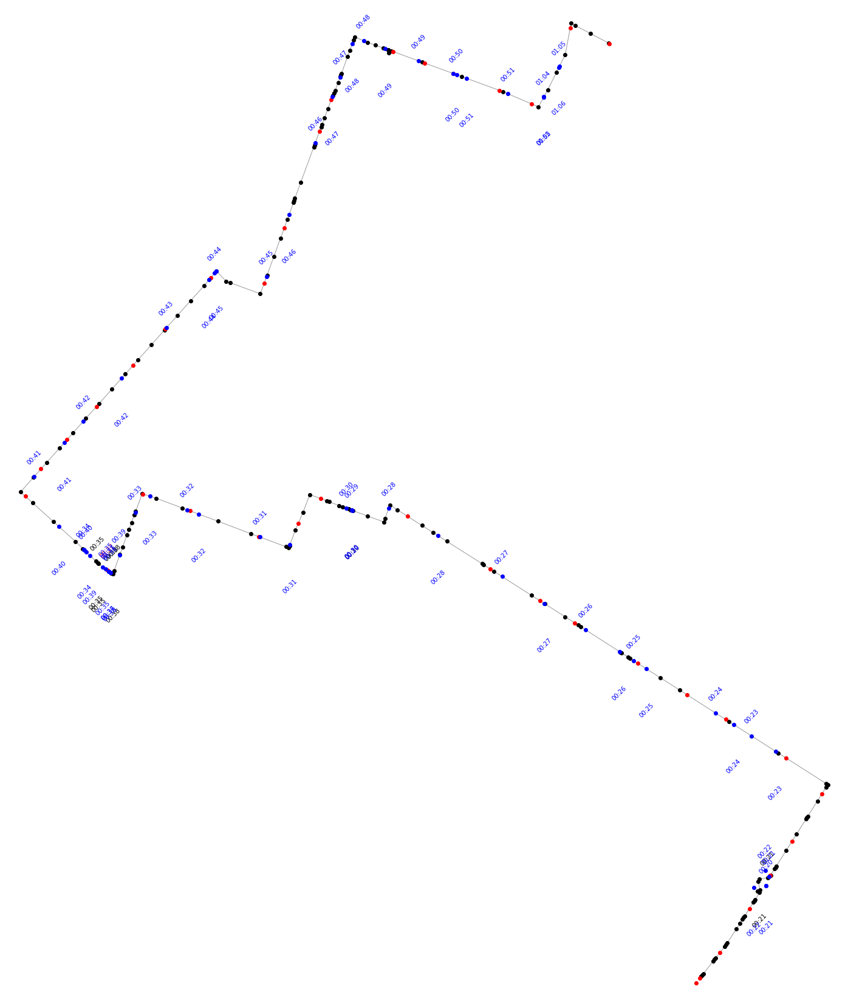

100%|██████████| 21/21 [02:51<00:00,  8.18s/it]


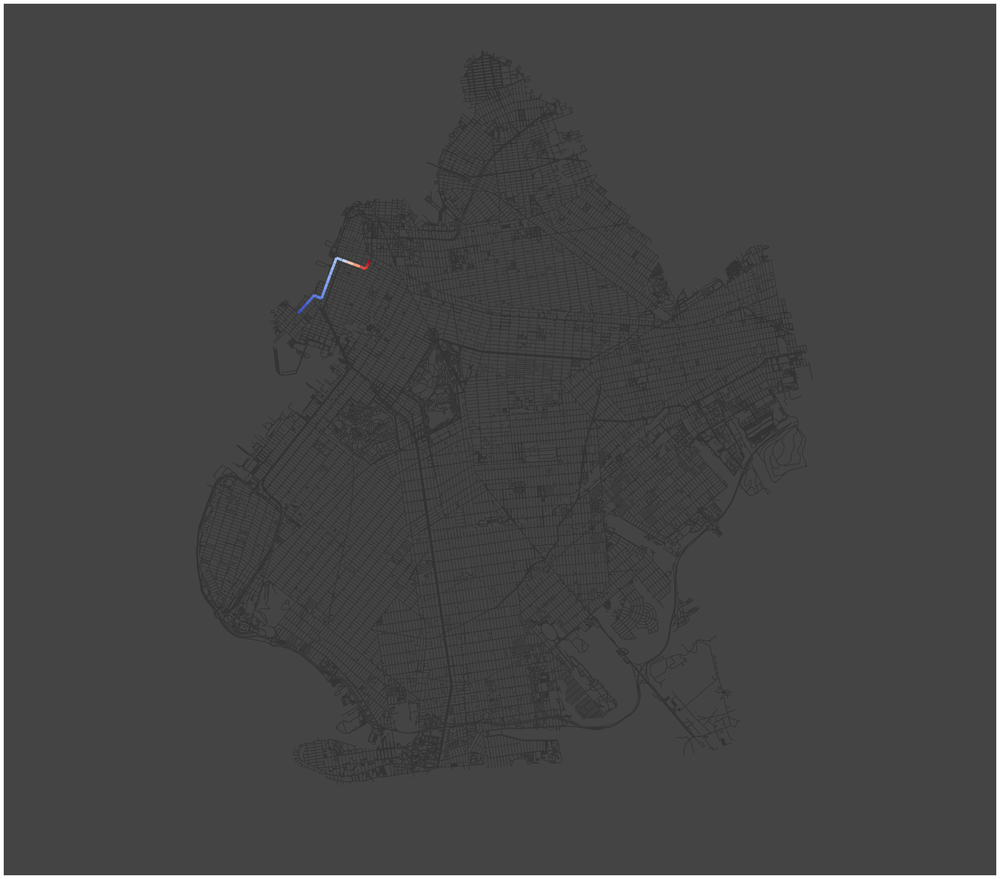

Completed b61 in 198.1391s

----------------------------------------
b63
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305216,01:19:34,ATLANTIC AV/CLINTON ST,None,40.690391,-73.994744,None,None,0,None,POINT (-73.99474 40.69039)
1,305217,01:20:01,ATLANTIC AV/HENRY ST,None,40.690747,-73.996107,None,None,0,None,POINT (-73.99611 40.69075)
2,305334,00:41:20,4 AV/100 ST,None,40.612914,-74.033455,None,None,0,None,POINT (-74.03346 40.61291)
3,305335,00:42:02,4 AV/MARINE AV,None,40.614236,-74.032305,None,None,0,None,POINT (-74.03230 40.61424)
4,305338,00:44:05,5 AV/92 ST,None,40.618115,-74.029021,None,None,0,None,POINT (-74.02902 40.61812)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
51,308418,00:45:04,5 AV/89 ST,None,40.619974,-74.027430,None,None,0,None,POINT (-74.02743 40.61997)
52,308419,00:46:44,5 AV/83 ST,None,40.623896,-74.024834,None,None,0,None,POINT (-74.02483 40.62390)
53,308420,00:48:11,5 AV/77 ST,None,40.628283,-74.023049,None,None,0,None,POINT (-74.02305 40.62828)
54,308647,01:20:31,ATLANTIC AV/HICKS ST,None,40.691173,-73.997626,None,None,0,None,POINT (-73.99763 40.69117)
55,801007,01:22:00,BROOKLYN BRIDGE PK RD/JORALEMON ST,None,40.693001,-74.000512,None,None,0,None,POINT (-74.00051 40.69300)


,trip_id,305216,305217,305334,305335,305338,305341,305344,305346,305348,...,308327,308328,308331,308332,308333,308418,308419,308420,308647,801007
0,JG_C1-Weekday-SDon-004000_B63_651,01:19:34,01:20:01,00:41:20,00:42:02,00:44:05,00:46:00,00:47:27,00:48:42,00:50:00,...,00:54:49,00:56:49,01:03:00,01:04:02,01:04:50,00:45:04,00:46:44,00:48:11,01:20:31,01:22:00
1,JG_C1-Weekday-009000_B63_652,02:09:34,02:10:01,01:31:20,01:32:02,01:34:05,01:36:00,01:37:27,01:38:42,01:40:00,...,01:44:49,01:46:49,01:53:00,01:54:02,01:54:50,01:35:04,01:36:44,01:38:11,02:10:31,02:12:00
2,JG_C1-Weekday-014000_B63_651,02:59:34,03:00:01,02:21:20,02:22:02,02:24:05,02:26:00,02:27:27,02:28:42,02:30:00,...,02:34:49,02:36:49,02:43:00,02:44:02,02:44:50,02:25:04,02:26:44,02:28:11,03:00:31,03:02:00
3,JG_C1-Weekday-SDon-019000_B63_652,03:50:34,03:51:01,03:11:20,03:12:02,03:14:05,03:16:00,03:17:27,03:18:42,03:20:00,...,03:24:49,03:26:49,03:33:00,03:34:02,03:34:50,03:15:04,03:16:44,03:18:11,03:51:31,03:53:00
4,JG_C1-Weekday-SDon-027000_B63_653,05:20:15,05:20:46,04:31:20,04:32:02,04:34:05,04:36:00,04:38:10,04:40:02,04:42:00,...,04:48:25,04:51:21,05:00:09,05:01:28,05:02:30,04:35:04,04:37:05,04:39:16,05:21:20,05:23:00


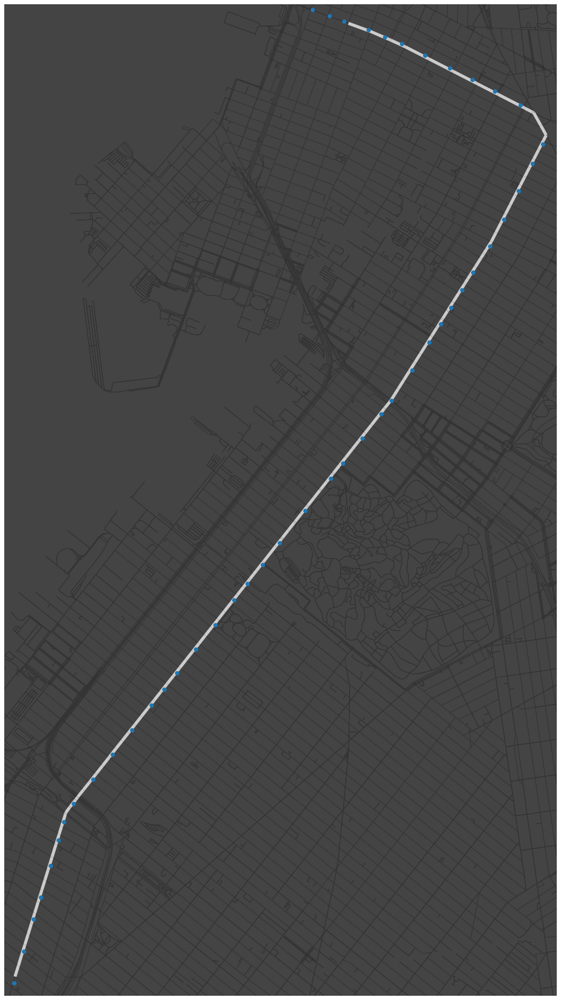

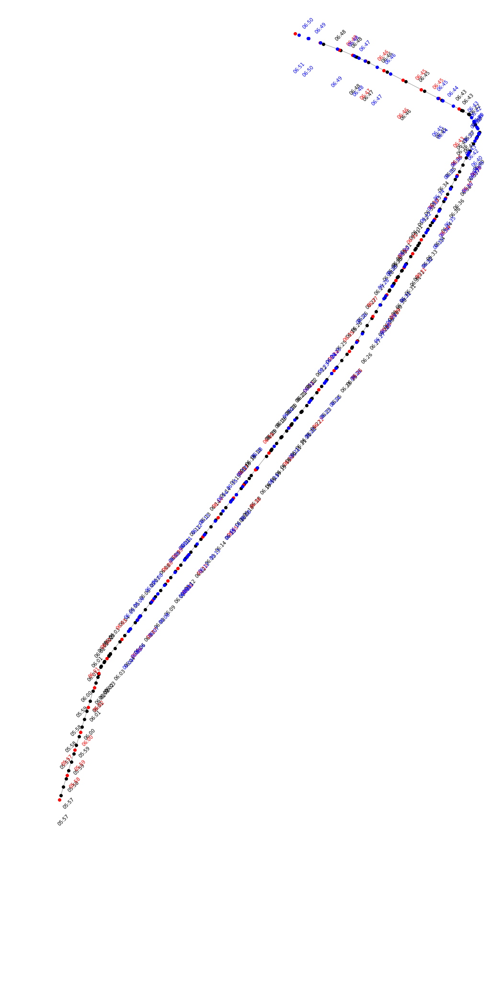

100%|██████████| 30/30 [06:43<00:00, 13.46s/it]


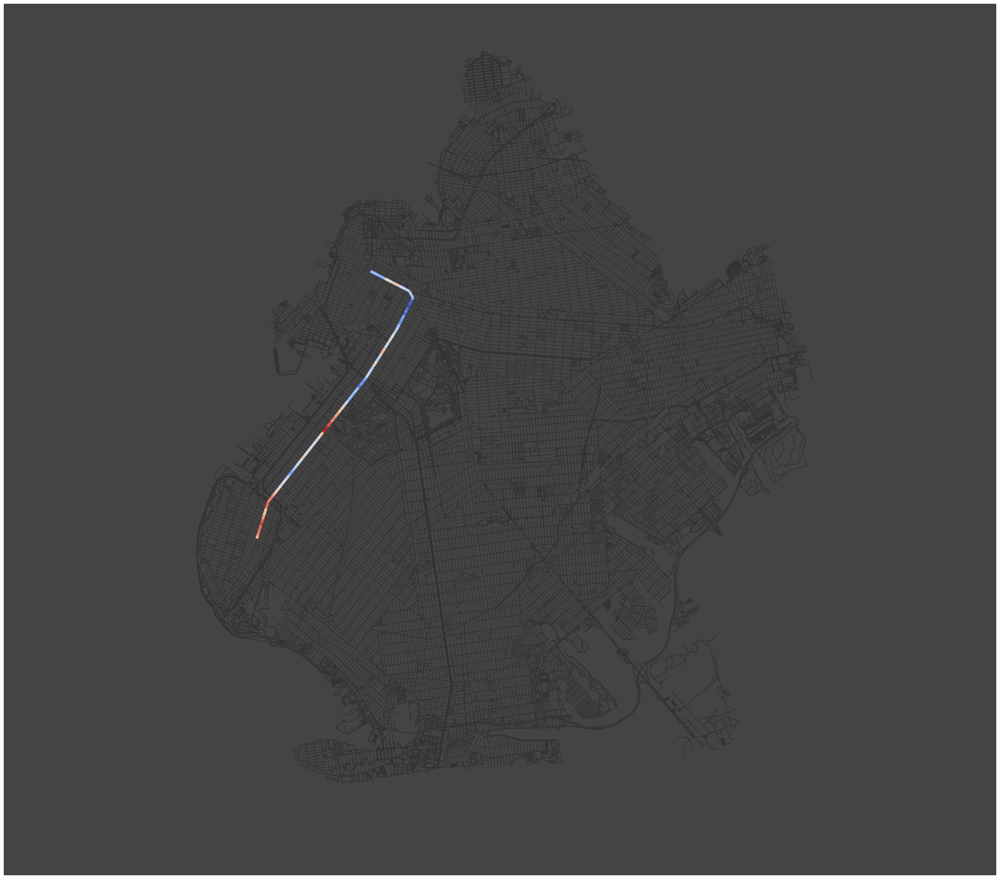

Completed b63 in 433.4882s

----------------------------------------
b65
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,306328,05:13:00,SMITH ST/FULTON ST,None,40.691209,-73.987376,None,None,0,None,POINT (-73.98738 40.69121)
1,307408,05:14:08,BOERUM PL/JORALEMON ST,None,40.692022,-73.989228,None,None,0,None,POINT (-73.98923 40.69202)
2,305407,05:17:00,ATLANTIC AV/SMITH ST,None,40.688371,-73.988811,None,None,0,None,POINT (-73.98881 40.68837)
3,305408,05:18:00,ATLANTIC AV/HOYT ST,None,40.687563,-73.986727,None,None,0,None,POINT (-73.98673 40.68756)
4,305409,05:19:02,ATLANTIC AV/BOND ST,None,40.686734,-73.984586,None,None,0,None,POINT (-73.98459 40.68673)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
28,301116,05:41:43,ST MARKS AV/ROCHESTER AV,None,40.673914,-73.927351,None,None,0,None,POINT (-73.92735 40.67391)
29,303552,05:42:39,ST MARKS AV/BUFFALO AV,None,40.673764,-73.924568,None,None,0,None,POINT (-73.92457 40.67376)
30,305582,05:43:25,ST MARKS AV/RALPH AV,None,40.673638,-73.922269,None,None,0,None,POINT (-73.92227 40.67364)
31,303198,05:44:36,RALPH AV/STERLING PL,None,40.671111,-73.922445,None,None,0,None,POINT (-73.92244 40.67111)
32,303556,05:45:00,RALPH AV/ST JOHNS PL,None,40.670198,-73.922535,None,None,0,None,POINT (-73.92253 40.67020)


,trip_id,306328,307408,305407,305408,305409,305410,305411,307595,305560,...,307811,307812,307813,307814,301115,301116,303552,305582,303198,303556
0,EN_C1-Weekday-SDon-031300_B65_851,05:13:00,05:14:08,05:17:00,05:18:00,05:19:02,05:20:02,05:20:47,05:21:52,05:22:44,...,05:38:00,05:39:07,05:40:03,05:40:46,05:41:18,05:41:43,05:42:39,05:43:25,05:44:36,05:45:00
1,EN_C1-Weekday-SDon-034300_B65_852,05:43:00,05:44:08,05:47:00,05:48:00,05:49:02,05:50:02,05:50:47,05:51:52,05:52:44,...,06:08:00,06:09:07,06:10:03,06:10:46,06:11:18,06:11:43,06:12:39,06:13:25,06:14:36,06:15:00
2,EN_C1-Weekday-SDon-039800_B65_851,06:38:00,06:39:08,06:42:00,06:43:00,06:44:02,06:45:02,06:45:47,06:46:52,06:47:44,...,07:03:00,07:04:16,07:05:20,07:06:09,07:06:46,07:07:15,07:08:19,07:09:12,07:10:33,07:11:00
3,EN_C1-Weekday-SDon-041800_B65_853,06:58:00,06:59:08,07:02:00,07:03:17,07:04:36,07:05:53,07:06:52,07:08:15,07:09:22,...,07:28:00,07:29:16,07:30:20,07:31:09,07:31:46,07:32:15,07:33:19,07:34:12,07:35:33,07:36:00
4,EN_C1-Weekday-SDon-043300_B65_852,07:13:00,07:14:08,07:17:00,07:18:17,07:19:36,07:20:53,07:21:52,07:23:15,07:24:22,...,07:43:00,07:44:16,07:45:20,07:46:09,07:46:46,07:47:15,07:48:19,07:49:12,07:50:33,07:51:00


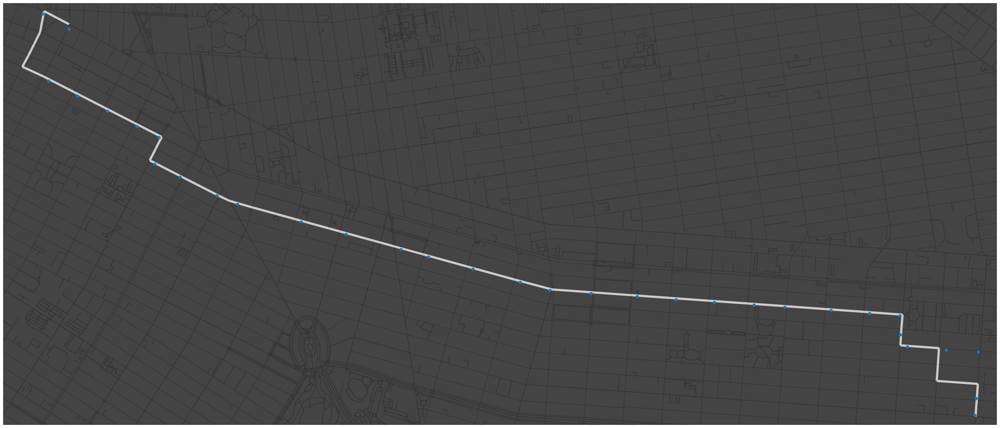

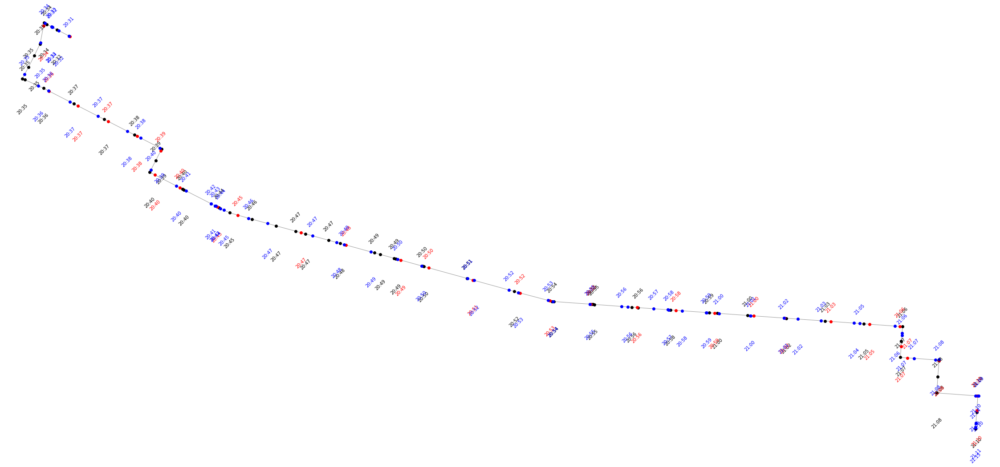

100%|██████████| 21/21 [02:57<00:00,  8.47s/it]


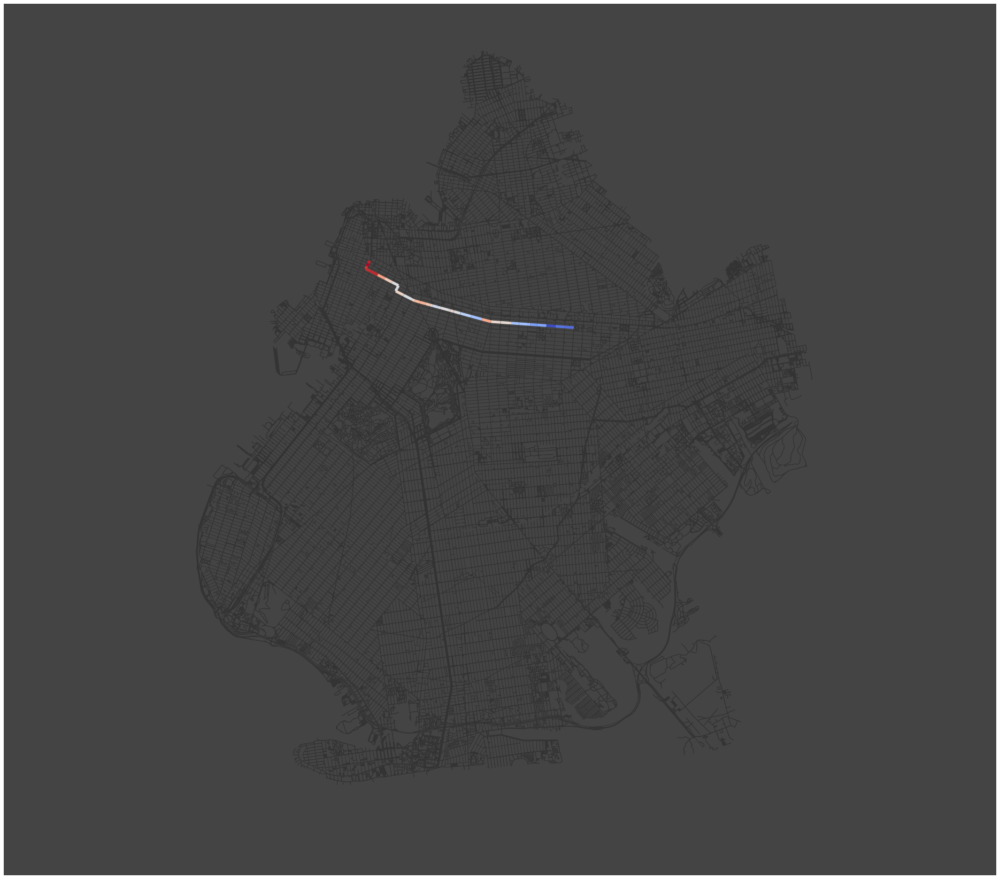

Completed b65 in 203.0075s

----------------------------------------
b68
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305733,00:30:00,PROSPECT PK SW/BARTEL PRITCHARD SQ,None,40.660699,-73.979409,None,None,0,None,POINT (-73.97941 40.66070)
1,305734,00:30:41,PROSPECT PK SW/10 AV,None,40.659626,-73.977217,None,None,0,None,POINT (-73.97722 40.65963)
2,305735,00:31:26,PROSPECT PK SW/11 AV,None,40.658472,-73.974832,None,None,0,None,POINT (-73.97483 40.65847)
3,305736,00:32:22,PROSPECT PK SW/TERRACE PL,None,40.656027,-73.973766,None,None,0,None,POINT (-73.97377 40.65603)
4,305738,00:33:13,PROSPECT PK SW/REEVE PL,None,40.653608,-73.973039,None,None,0,None,POINT (-73.97304 40.65361)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
45,308306,01:03:30,NEPTUNE AV/W 6 ST,None,40.580064,-73.974502,None,None,0,None,POINT (-73.97450 40.58006)
46,308307,01:03:58,NEPTUNE AV/SHELL RD,None,40.579819,-73.976528,None,None,0,None,POINT (-73.97653 40.57982)
47,308308,01:04:38,NEPTUNE AV/W 12 ST,None,40.579518,-73.979394,None,None,0,None,POINT (-73.97939 40.57952)
48,306419,01:05:15,STILLWELL AV/NEPTUNE AV,None,40.579067,-73.982011,None,None,0,None,POINT (-73.98201 40.57907)
49,801074,01:06:00,STILLWELL/TERMINAL,None,40.576864,-73.981026,None,None,0,None,POINT (-73.98103 40.57686)


,trip_id,305733,305734,305735,305736,305738,305739,305740,305741,305742,...,300122,300016,308304,306594,308305,308306,308307,308308,306419,801074
0,JG_C1-Weekday-SDon-003000_B68_951,00:30:00,00:30:41,00:31:26,00:32:22,00:33:13,00:33:41,00:34:40,00:35:18,00:36:00,...,01:00:26,01:00:42,01:01:24,01:02:03,01:02:57,01:03:30,01:03:58,01:04:38,01:05:15,01:06:00
1,JG_C1-Weekday-007200_B68_952,01:12:00,01:12:41,01:13:26,01:14:22,01:15:13,01:15:41,01:16:40,01:17:18,01:18:00,...,01:42:26,01:42:42,01:43:24,01:44:03,01:44:57,01:45:30,01:45:58,01:46:38,01:47:15,01:48:00
2,JG_C1-Weekday-SDon-011400_B68_951,01:54:00,01:54:28,01:54:57,01:55:35,01:56:09,01:56:27,01:57:07,01:57:32,01:58:00,...,02:20:26,02:20:42,02:21:24,02:22:03,02:22:57,02:23:30,02:23:58,02:24:38,02:25:15,02:26:00
3,JG_C1-Weekday-SDon-015400_B68_952,02:34:00,02:34:28,02:34:57,02:35:35,02:36:09,02:36:27,02:37:07,02:37:32,02:38:00,...,03:00:26,03:00:42,03:01:24,03:02:03,03:02:57,03:03:30,03:03:58,03:04:38,03:05:15,03:06:00
4,JG_C1-Weekday-SDon-019400_B68_951,03:14:00,03:14:28,03:14:57,03:15:35,03:16:09,03:16:27,03:17:07,03:17:32,03:18:00,...,03:40:26,03:40:42,03:41:24,03:42:03,03:42:57,03:43:30,03:43:58,03:44:38,03:45:15,03:46:00


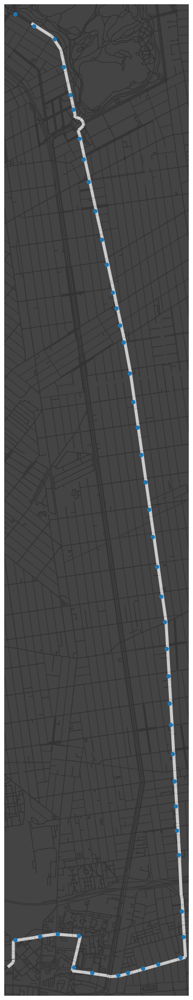

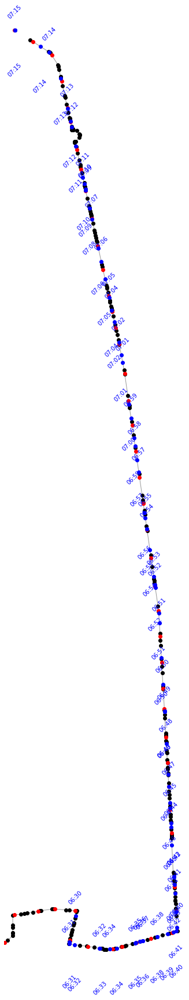

 29%|██▉       | 11/38 [01:39<04:04,  9.04s/it]

fail
Experienced error
Completed b68 in 117.8755s

----------------------------------------
b82
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308478,01:10:00,STILLWELL TERMINAL/ BUS LOOP,None,40.577079,-73.981296,None,None,0,None,POINT (-73.98130 40.57708)
1,308017,01:10:48,STILLWELL AV/NEPTUNE AV,None,40.578275,-73.981718,None,None,0,None,POINT (-73.98172 40.57827)
2,308410,01:12:56,CROPSEY AV/HART PL,None,40.581370,-73.985657,None,None,0,None,POINT (-73.98566 40.58137)
3,308411,01:13:39,CROPSEY AV/CANAL AV,None,40.583358,-73.986269,None,None,0,None,POINT (-73.98627 40.58336)
4,300418,01:14:44,CROPSEY AV/BAY 49 ST,None,40.586092,-73.987889,None,None,0,None,POINT (-73.98789 40.58609)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
67,304078,02:04:15,PENNSYLVANIA AV/VANDALIA AV,None,40.650381,-73.884737,None,None,0,None,POINT (-73.88474 40.65038)
68,307539,02:05:17,PENNSYLVANIA AV/SCHROEDERS AV,None,40.647608,-73.881733,None,None,0,None,POINT (-73.88173 40.64761)
69,307206,02:05:49,PENNSYLVANIA AV/GENEVA LOOP,None,40.646144,-73.880110,None,None,0,None,POINT (-73.88011 40.64614)
70,307107,02:06:31,PENNSYLVANIA AV/SEAVIEW AV,None,40.644380,-73.878008,None,None,0,None,POINT (-73.87801 40.64438)
71,901080,02:07:00,SEAVIEW AV/PENNSYLVANIA AV,None,40.642968,-73.878269,None,None,0,None,POINT (-73.87827 40.64297)


,trip_id,308478,308017,308410,308411,300418,300419,300420,300421,300422,...,304072,304073,307005,306949,304077,304078,307539,307206,307107,901080
0,EN_C1-Weekday-SDon-007000_B82_601,01:10:00,01:10:48,01:12:56,01:13:39,01:14:44,01:15:37,01:16:07,01:16:41,01:17:20,...,02:01:14,02:01:42,02:02:33,02:02:59,02:03:37,02:04:15,02:05:17,02:05:49,02:06:31,02:07:00
1,EN_C1-Weekday-SDon-014000_B82_602,02:20:00,02:20:48,02:22:56,02:23:39,02:24:44,02:25:37,02:26:07,02:26:41,02:27:20,...,03:11:14,03:11:42,03:12:33,03:12:59,03:13:37,03:14:15,03:15:17,03:15:49,03:16:31,03:17:00
2,EN_C1-Weekday-SDon-021000_B82_601,03:30:00,03:30:48,03:32:56,03:33:39,03:34:44,03:35:37,03:36:07,03:36:41,03:37:20,...,04:21:14,04:21:42,04:22:33,04:22:59,04:23:37,04:24:15,04:25:17,04:25:49,04:26:31,04:27:00
3,EN_C1-Weekday-SDon-028000_B82_602,04:40:00,04:40:48,04:42:56,04:43:39,04:44:44,04:45:37,04:46:07,04:46:41,04:47:20,...,05:36:48,05:37:23,05:38:26,05:38:59,05:39:47,05:40:33,05:41:51,05:42:32,05:43:23,05:44:00
4,EN_C1-Weekday-SDon-030000_B82_603,05:00:00,05:00:48,05:02:56,05:03:39,05:04:44,05:05:37,05:06:07,05:06:41,05:07:20,...,05:56:48,05:57:23,05:58:26,05:58:59,05:59:47,06:00:33,06:01:51,06:02:32,06:03:23,06:04:00


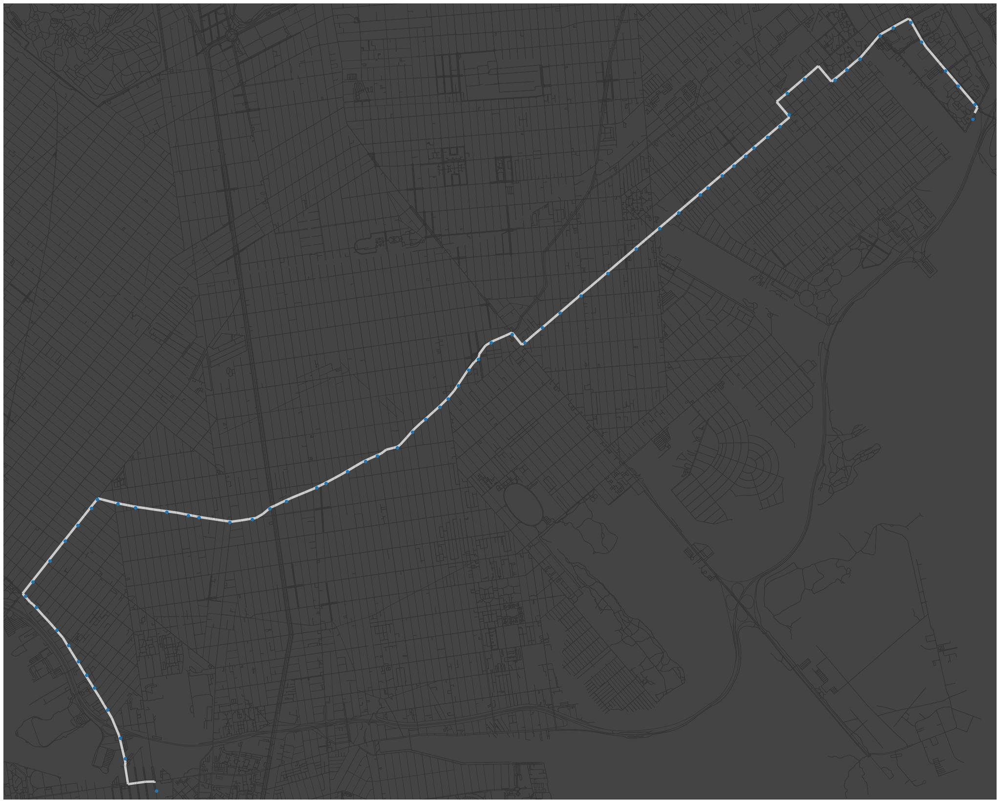

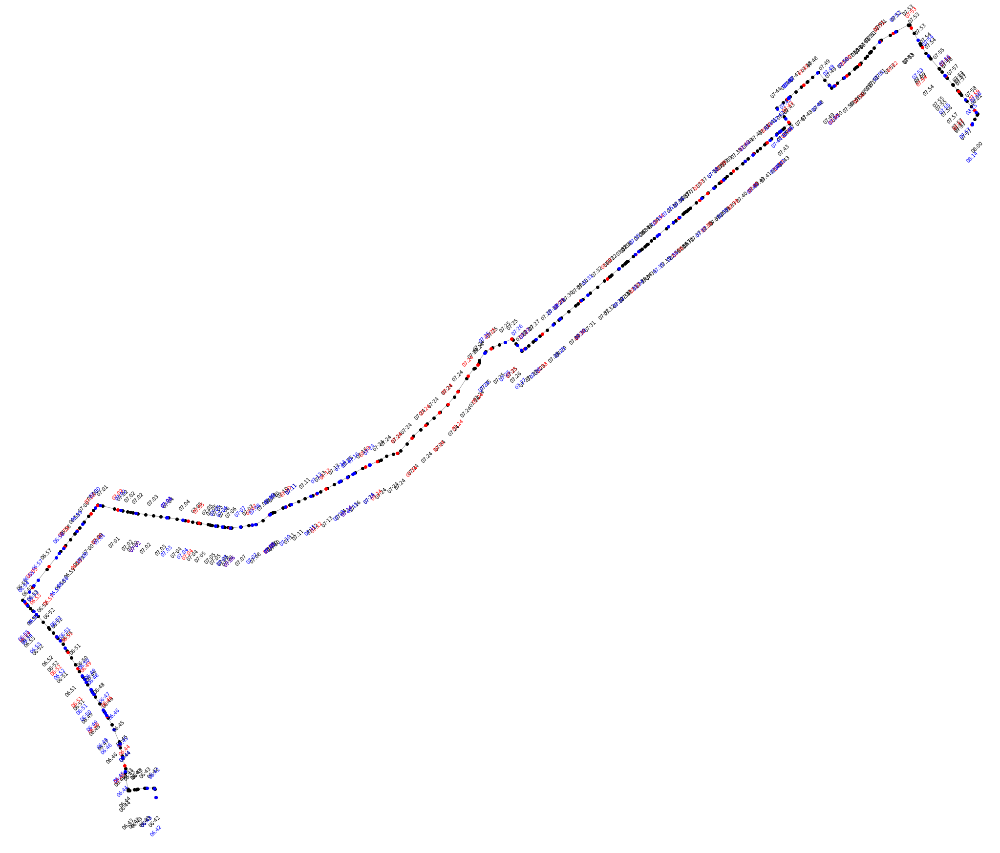

100%|██████████| 38/38 [10:38<00:00, 16.80s/it]


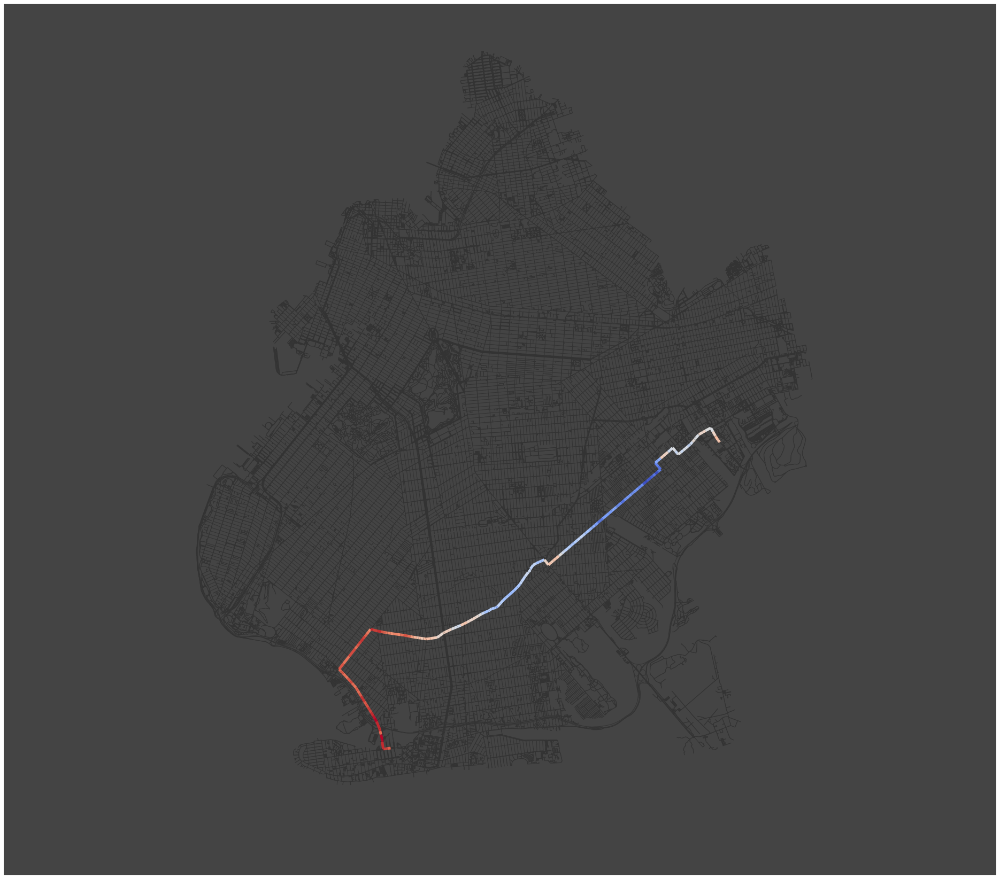

Completed b82 in 670.4348s


In [100]:
ROUTES = [
    'b3',
    'b6',
    'b8',
    'b9',
    'b11',
    'b12',
    'b16',
    'b25',
    'b26',
    'b35',
    'b37',
    'b43',
    'b44',
    'b48',
    'b52',
    'b61',
    'b63',
    'b65',
    'b68',
    'b82',
]

global analysis
analysis = Analysis(ROUTES)
analysis.run()

In [114]:
ROUTES_WITH_ERRORS = [
    'b9',
]


----------------------------------------
b9
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307941,04:45:00,SHORE RD/71 ST,None,40.636852,-74.036257,None,None,0,None,POINT (-74.03626 40.63685)
1,300071,04:45:56,BAY RIDGE AV/SHORE RD,None,40.638570,-74.035368,None,None,0,None,POINT (-74.03537 40.63857)
2,307200,04:46:30,BAY RIDGE AV/NARROWS AV,None,40.638000,-74.033530,None,None,0,None,POINT (-74.03353 40.63800)
3,300073,04:47:19,BAY RIDGE AV/COLONIAL RD,None,40.637191,-74.030921,None,None,0,None,POINT (-74.03092 40.63719)
4,300074,04:48:07,BAY RIDGE AV/RIDGE BL,None,40.636379,-74.028312,None,None,0,None,POINT (-74.02831 40.63638)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
51,303339,None,FLATBUSH AV/AV R,None,40.615975,-73.929712,None,None,0,None,POINT (-73.92971 40.61597)
52,303340,None,FLATBUSH AV/FILLMORE AV,None,40.614695,-73.928280,None,None,0,None,POINT (-73.92828 40.61469)
53,303341,None,FLATBUSH AV/AV S,None,40.613075,-73.926474,None,None,0,None,POINT (-73.92647 40.61308)
54,307636,None,FLATBUSH AV/AV T,None,40.611273,-73.924426,None,None,0,None,POINT (-73.92443 40.61127)
55,801039,None,Kings Plaza (B9 term),None,40.608306,-73.920622,None,None,0,None,POINT (-73.92062 40.60831)


,trip_id,307941,300071,307200,300073,300074,300075,308239,308240,308650,...,300966,307199,303323,303324,303338,303339,303340,303341,307636,801039
0,JG_C1-Weekday-SDon-028500_B9_201,04:45:00,04:45:56,04:46:30,04:47:19,04:48:07,04:49:00,04:49:47,04:50:29,04:51:27,...,05:18:24,05:19:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,JG_C1-Weekday-SDon-030000_B9_202,05:00:00,05:00:56,05:01:30,05:02:19,05:03:07,05:04:00,05:04:47,05:05:29,05:06:27,...,05:33:24,05:34:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,JG_C1-Weekday-SDon-031200_B9_203,05:12:00,05:12:56,05:13:30,05:14:19,05:15:07,05:16:00,05:16:47,05:17:29,05:18:27,...,05:48:12,05:49:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,JG_C1-Weekday-SDon-032400_B9_204,05:24:00,05:24:56,05:25:30,05:26:19,05:27:07,05:28:00,05:28:47,05:29:29,05:30:27,...,06:01:12,06:02:00,06:02:59,06:04:00,06:04:52,06:06:04,06:07:00,06:08:11,06:09:32,06:12:00
4,JG_C1-Weekday-SDon-033600_B9_205,05:36:00,05:37:10,05:37:53,05:38:54,05:39:54,05:41:00,05:41:56,05:42:46,05:43:56,...,06:19:00,06:20:00,06:20:59,06:22:00,06:22:52,06:24:04,06:25:00,06:26:11,06:27:32,06:30:00


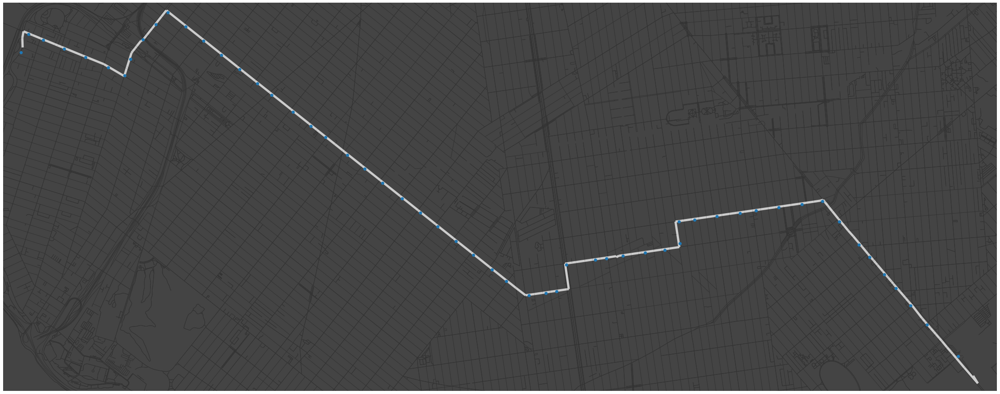

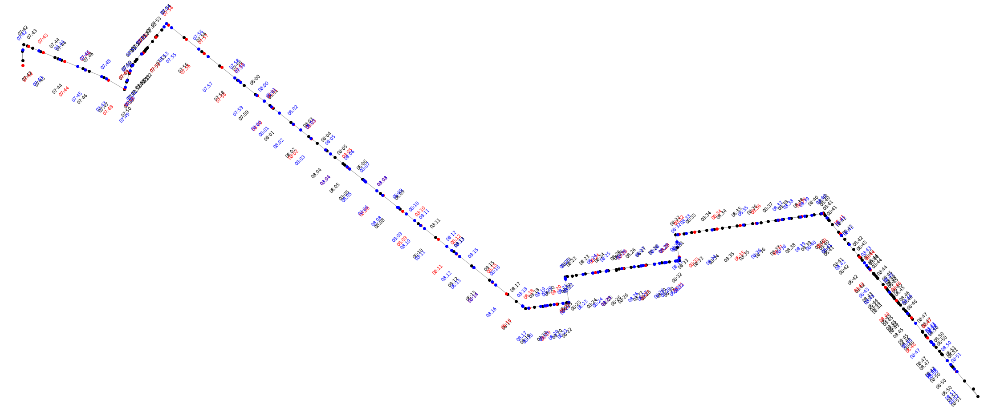

 12%|█▏        | 3/25 [01:08<07:12, 19.66s/it]

Error at MTA NYCT_248


100%|██████████| 25/25 [08:08<00:00, 19.53s/it]


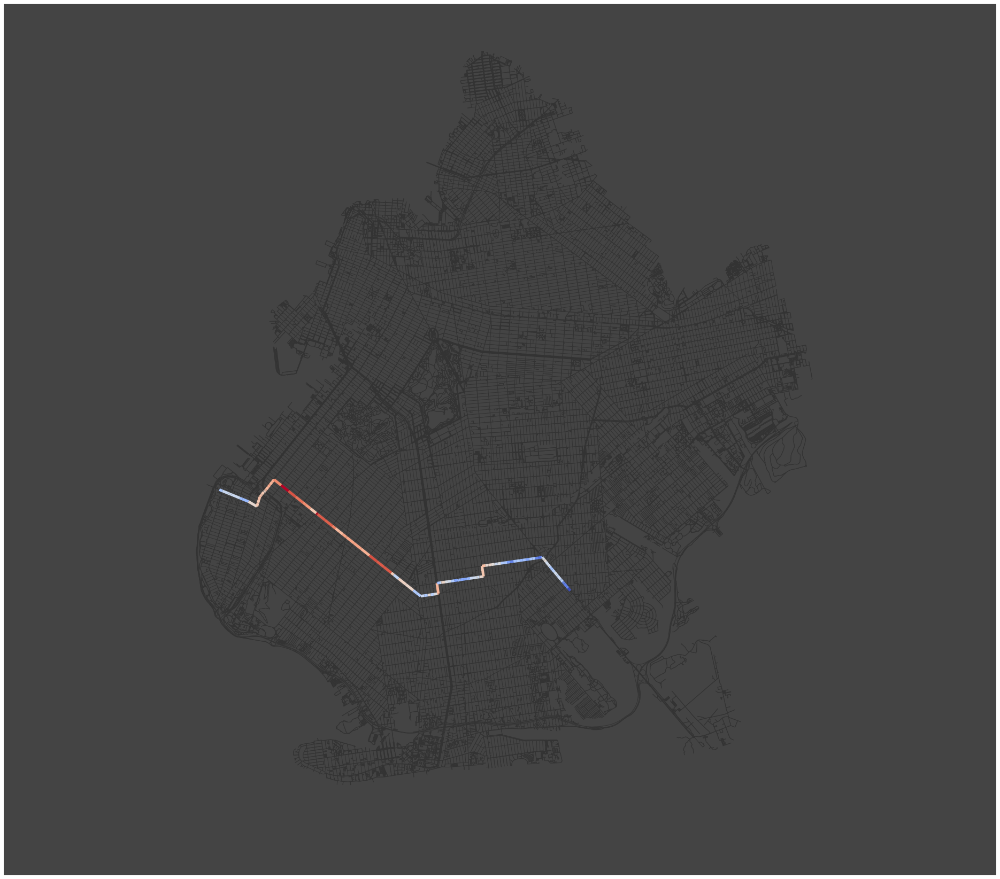

Completed b9 in 519.2248s

----------------------------------------
b12
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,301386,01:17:37,PACIFIC ST/EAST NEW YORK AV,None,40.675270,-73.905186,None,None,0,None,POINT (-73.90519 40.67527)
1,301387,01:18:08,SACKMAN ST/DEAN ST,None,40.674606,-73.906329,None,None,0,None,POINT (-73.90633 40.67461)
2,301388,01:19:01,EAST NEW YORK AV/MOTHER GASTON BL,None,40.673244,-73.908786,None,None,0,None,POINT (-73.90879 40.67324)
3,301389,01:19:19,EAST NEW YORK AV/ST MARKS AV,None,40.672850,-73.909703,None,None,0,None,POINT (-73.90970 40.67285)
4,301390,01:19:57,EAST NEW YORK AV/ROCKAWAY AV,None,40.671959,-73.911737,None,None,0,None,POINT (-73.91174 40.67196)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
26,307120,01:20:53,EAST NEW YORK AV/STERLING PL,None,40.670669,-73.914698,None,None,0,None,POINT (-73.91470 40.67067)
27,307309,01:24:49,EAST NEW YORK AV/PORTAL ST,None,40.666331,-73.924710,None,None,0,None,POINT (-73.92471 40.66633)
28,308274,01:22:26,NEW YORK AV/LINCOLN PL,None,40.668604,-73.919270,None,None,0,None,POINT (-73.91927 40.66860)
29,801177,01:16:00,ALABAMA AV / FULTON ST,None,40.676746,-73.899944,None,None,0,None,POINT (-73.89994 40.67675)
30,901089,01:41:00,PARKSIDE AV/OCEAN AV,None,40.654848,-73.961754,None,None,0,None,POINT (-73.96175 40.65485)


,trip_id,301386,301387,301388,301389,301390,301392,301395,301397,301398,...,301413,301414,306348,306349,306438,307120,307309,308274,801177,901089
0,EN_C1-Weekday-SDon-007600_B12_1,01:17:37,01:18:08,01:19:01,01:19:19,01:19:57,01:22:00,01:25:38,01:26:03,01:27:01,...,01:39:49,01:40:33,01:24:08,01:34:58,01:28:00,01:20:53,01:24:49,01:22:26,01:16:00,01:41:00
1,EN_C1-Weekday-011600_B12_2,01:57:21,01:57:47,01:58:31,01:58:46,01:59:17,02:01:00,02:04:02,02:04:22,02:05:11,...,02:17:49,02:18:33,02:02:47,02:12:58,02:06:00,02:00:04,02:03:21,02:01:22,01:56:00,02:19:00
2,EN_C1-Weekday-SDon-015600_B12_1,02:37:21,02:37:47,02:38:31,02:38:46,02:39:17,02:41:00,02:44:02,02:44:22,02:45:11,...,02:57:49,02:58:33,02:42:47,02:52:58,02:46:00,02:40:04,02:43:21,02:41:22,02:36:00,02:59:00
3,EN_C1-Weekday-SDon-019600_B12_2,03:17:21,03:17:47,03:18:31,03:18:46,03:19:17,03:21:00,03:24:02,03:24:22,03:25:11,...,03:37:49,03:38:33,03:22:47,03:32:58,03:26:00,03:20:04,03:23:21,03:21:22,03:16:00,03:39:00
4,EN_C1-Weekday-SDon-023100_B12_3,03:52:21,03:52:47,03:53:31,03:53:46,03:54:17,03:56:00,03:59:02,03:59:22,04:00:11,...,04:12:49,04:13:33,03:57:47,04:07:58,04:01:00,03:55:04,03:58:21,03:56:22,03:51:00,04:14:00


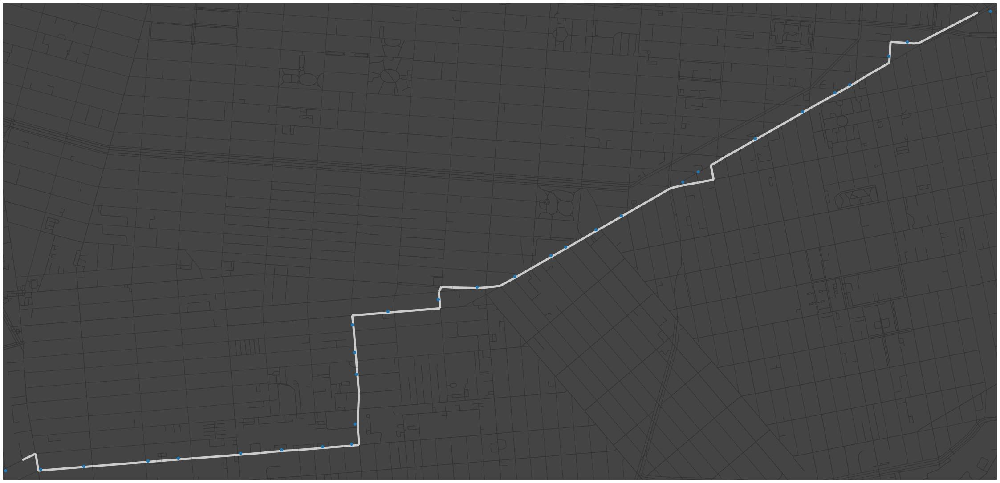

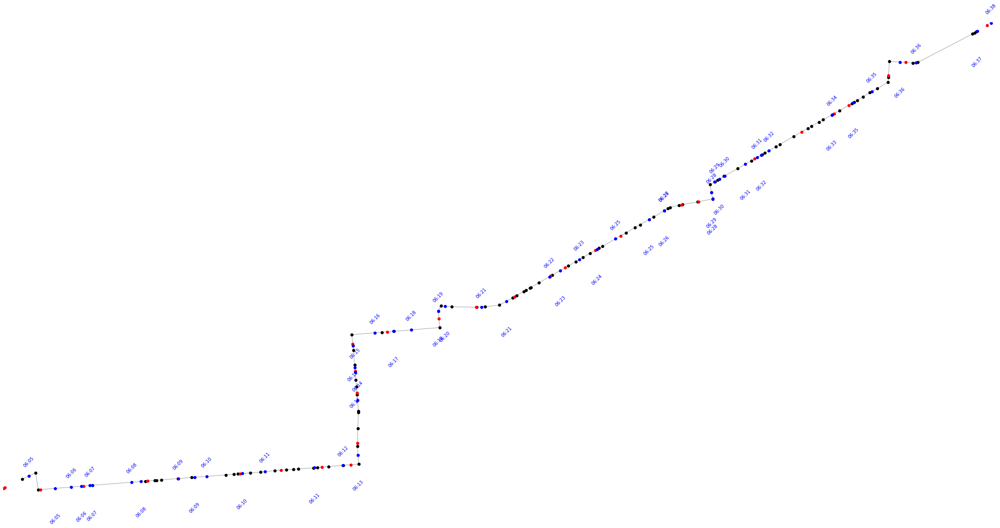

 22%|██▏       | 11/49 [00:53<03:05,  4.88s/it]

fail


TypeError: object of type 'NoneType' has no len()

In [115]:
analysis = Analysis(ROUTES_WITH_ERRORS)
analysis.run()


----------------------------------------
b12
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,301386,01:17:37,PACIFIC ST/EAST NEW YORK AV,None,40.675270,-73.905186,None,None,0,None,POINT (-73.90519 40.67527)
1,301387,01:18:08,SACKMAN ST/DEAN ST,None,40.674606,-73.906329,None,None,0,None,POINT (-73.90633 40.67461)
2,301388,01:19:01,EAST NEW YORK AV/MOTHER GASTON BL,None,40.673244,-73.908786,None,None,0,None,POINT (-73.90879 40.67324)
3,301389,01:19:19,EAST NEW YORK AV/ST MARKS AV,None,40.672850,-73.909703,None,None,0,None,POINT (-73.90970 40.67285)
4,301390,01:19:57,EAST NEW YORK AV/ROCKAWAY AV,None,40.671959,-73.911737,None,None,0,None,POINT (-73.91174 40.67196)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
26,307120,01:20:53,EAST NEW YORK AV/STERLING PL,None,40.670669,-73.914698,None,None,0,None,POINT (-73.91470 40.67067)
27,307309,01:24:49,EAST NEW YORK AV/PORTAL ST,None,40.666331,-73.924710,None,None,0,None,POINT (-73.92471 40.66633)
28,308274,01:22:26,NEW YORK AV/LINCOLN PL,None,40.668604,-73.919270,None,None,0,None,POINT (-73.91927 40.66860)
29,801177,01:16:00,ALABAMA AV / FULTON ST,None,40.676746,-73.899944,None,None,0,None,POINT (-73.89994 40.67675)
30,901089,01:41:00,PARKSIDE AV/OCEAN AV,None,40.654848,-73.961754,None,None,0,None,POINT (-73.96175 40.65485)


,trip_id,301386,301387,301388,301389,301390,301392,301395,301397,301398,...,301413,301414,306348,306349,306438,307120,307309,308274,801177,901089
0,EN_C1-Weekday-SDon-007600_B12_1,01:17:37,01:18:08,01:19:01,01:19:19,01:19:57,01:22:00,01:25:38,01:26:03,01:27:01,...,01:39:49,01:40:33,01:24:08,01:34:58,01:28:00,01:20:53,01:24:49,01:22:26,01:16:00,01:41:00
1,EN_C1-Weekday-011600_B12_2,01:57:21,01:57:47,01:58:31,01:58:46,01:59:17,02:01:00,02:04:02,02:04:22,02:05:11,...,02:17:49,02:18:33,02:02:47,02:12:58,02:06:00,02:00:04,02:03:21,02:01:22,01:56:00,02:19:00
2,EN_C1-Weekday-SDon-015600_B12_1,02:37:21,02:37:47,02:38:31,02:38:46,02:39:17,02:41:00,02:44:02,02:44:22,02:45:11,...,02:57:49,02:58:33,02:42:47,02:52:58,02:46:00,02:40:04,02:43:21,02:41:22,02:36:00,02:59:00
3,EN_C1-Weekday-SDon-019600_B12_2,03:17:21,03:17:47,03:18:31,03:18:46,03:19:17,03:21:00,03:24:02,03:24:22,03:25:11,...,03:37:49,03:38:33,03:22:47,03:32:58,03:26:00,03:20:04,03:23:21,03:21:22,03:16:00,03:39:00
4,EN_C1-Weekday-SDon-023100_B12_3,03:52:21,03:52:47,03:53:31,03:53:46,03:54:17,03:56:00,03:59:02,03:59:22,04:00:11,...,04:12:49,04:13:33,03:57:47,04:07:58,04:01:00,03:55:04,03:58:21,03:56:22,03:51:00,04:14:00


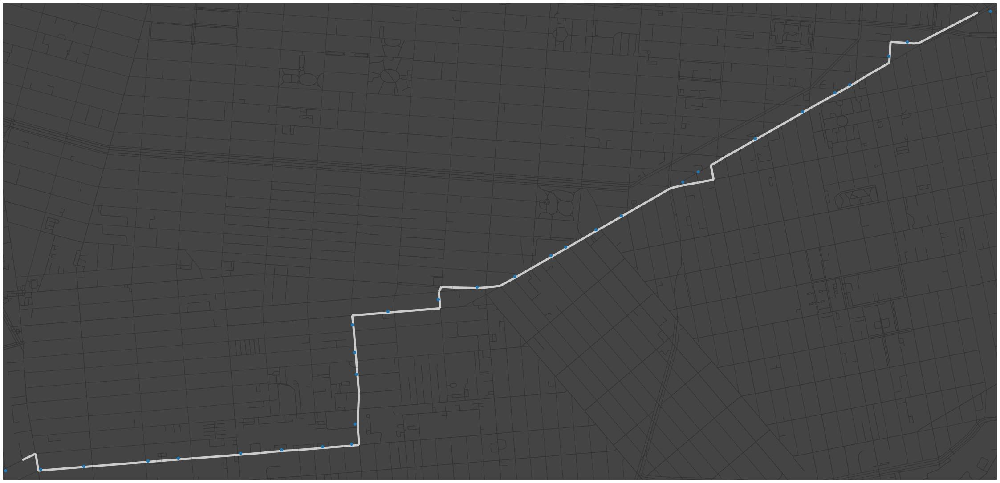

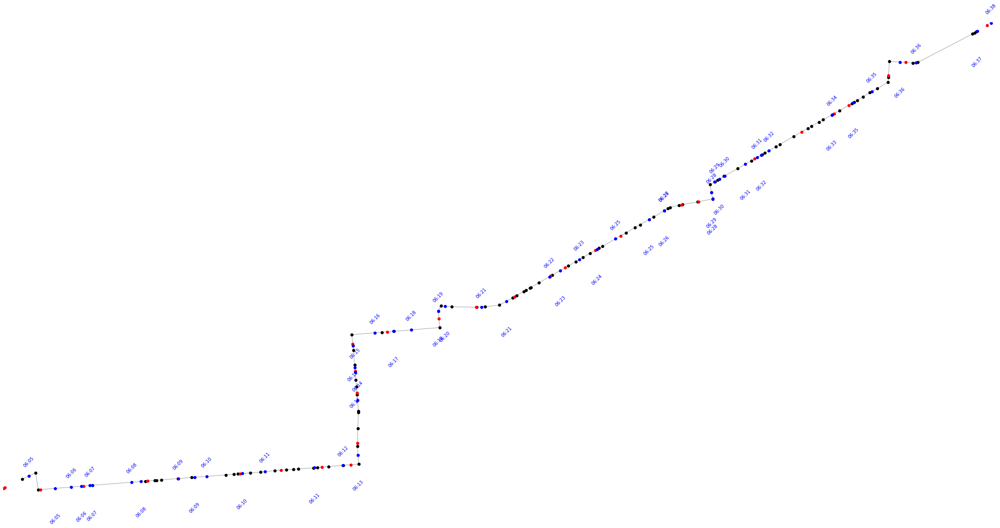

 22%|██▏       | 11/49 [00:52<03:02,  4.81s/it]


fail


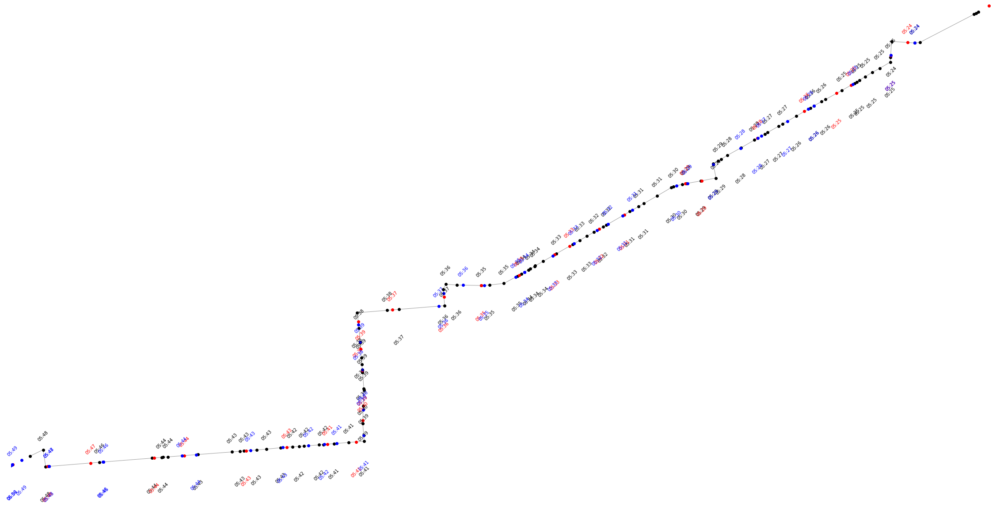

  0%|          | 0/48 [00:00<?, ?it/s]

No Match Error at MTA NYCT_3960
No Match Error at MTA NYCT_3960
No Match Error at MTA NYCT_3960
No Match Error at MTA NYCT_3960
No Match Error at MTA NYCT_3960


  2%|▏         | 1/48 [00:06<05:02,  6.45s/it]

No Match Error at MTA NYCT_3960
No Match Error at MTA NYCT_3960
No Match Error at MTA NYCT_3964
No Match Error at MTA NYCT_3964
No Match Error at MTA NYCT_3964


  4%|▍         | 2/48 [00:10<04:02,  5.27s/it]

No Match Error at MTA NYCT_3964
No Match Error at MTA NYCT_3966
No Match Error at MTA NYCT_3966
No Match Error at MTA NYCT_3966
No Match Error at MTA NYCT_3966


  8%|▊         | 4/48 [00:25<04:45,  6.48s/it]

No Match Error at MTA NYCT_3969
No Match Error at MTA NYCT_3969
No Match Error at MTA NYCT_3969
No Match Error at MTA NYCT_3969


 10%|█         | 5/48 [00:27<03:21,  4.68s/it]

No Match Error at MTA NYCT_3972
No Match Error at MTA NYCT_3972
No Match Error at MTA NYCT_3977
No Match Error at MTA NYCT_3977
No Match Error at MTA NYCT_3977
No Match Error at MTA NYCT_3977


 12%|█▎        | 6/48 [00:35<04:07,  5.90s/it]

No Match Error at MTA NYCT_3977
No Match Error at MTA NYCT_3977
No Match Error at MTA NYCT_3977
No Match Error at MTA NYCT_4105
No Match Error at MTA NYCT_4105
No Match Error at MTA NYCT_4105


 15%|█▍        | 7/48 [00:39<03:40,  5.39s/it]

No Match Error at MTA NYCT_4105
No Match Error at MTA NYCT_4105
No Match Error at MTA NYCT_4134
No Match Error at MTA NYCT_4134
No Match Error at MTA NYCT_4134
No Match Error at MTA NYCT_4134
No Match Error at MTA NYCT_4134
No Match Error at MTA NYCT_4134
No Match Error at MTA NYCT_4134


 17%|█▋        | 8/48 [00:47<04:03,  6.09s/it]

No Match Error at MTA NYCT_4134
No Match Error at MTA NYCT_4455
No Match Error at MTA NYCT_4455
No Match Error at MTA NYCT_4455
No Match Error at MTA NYCT_4455
No Match Error at MTA NYCT_4455
No Match Error at MTA NYCT_4455


 19%|█▉        | 9/48 [00:58<04:54,  7.54s/it]

No Match Error at MTA NYCT_4455
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4534


 21%|██        | 10/48 [01:06<04:52,  7.69s/it]

No Match Error at MTA NYCT_4534
No Match Error at MTA NYCT_4544
No Match Error at MTA NYCT_4544
No Match Error at MTA NYCT_4544
No Match Error at MTA NYCT_4544
No Match Error at MTA NYCT_4544
No Match Error at MTA NYCT_4544


 23%|██▎       | 11/48 [01:11<04:22,  7.09s/it]

No Match Error at MTA NYCT_4544
No Match Error at MTA NYCT_4544


 25%|██▌       | 12/48 [01:13<03:12,  5.34s/it]

No Match Error at MTA NYCT_4548
No Match Error at MTA NYCT_4548
No Match Error at MTA NYCT_4548
No Match Error at MTA NYCT_4548
No Match Error at MTA NYCT_4548
No Match Error at MTA NYCT_4548
No Match Error at MTA NYCT_4548


 27%|██▋       | 13/48 [01:24<04:03,  6.97s/it]

No Match Error at MTA NYCT_4548


 29%|██▉       | 14/48 [01:28<03:33,  6.27s/it]

No Match Error at MTA NYCT_4549
No Match Error at MTA NYCT_4552


 31%|███▏      | 15/48 [01:32<03:05,  5.63s/it]

No Match Error at MTA NYCT_4552
No Match Error at MTA NYCT_4552
No Match Error at MTA NYCT_4552
No Match Error at MTA NYCT_4589
No Match Error at MTA NYCT_4589
No Match Error at MTA NYCT_4589


 33%|███▎      | 16/48 [01:41<03:34,  6.69s/it]

No Match Error at MTA NYCT_4589


 35%|███▌      | 17/48 [01:44<02:46,  5.36s/it]

No Match Error at MTA NYCT_4825


 38%|███▊      | 18/48 [01:48<02:26,  4.88s/it]

No Match Error at MTA NYCT_4825
No Match Error at MTA NYCT_4828
No Match Error at MTA NYCT_4828


 40%|███▉      | 19/48 [01:55<02:47,  5.78s/it]

No Match Error at MTA NYCT_4828


 42%|████▏     | 20/48 [01:58<02:11,  4.70s/it]

No Match Error at MTA NYCT_4836
No Match Error at MTA NYCT_4836


 44%|████▍     | 21/48 [02:00<01:47,  3.97s/it]

No Match Error at MTA NYCT_4843


 46%|████▌     | 22/48 [02:03<01:35,  3.65s/it]

No Match Error at MTA NYCT_4843
No Match Error at MTA NYCT_4856
No Match Error at MTA NYCT_4856
No Match Error at MTA NYCT_4856
No Match Error at MTA NYCT_4856
No Match Error at MTA NYCT_4856


 48%|████▊     | 23/48 [02:09<01:53,  4.54s/it]

No Match Error at MTA NYCT_4856
No Match Error at MTA NYCT_4856
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093


 50%|█████     | 24/48 [02:24<03:04,  7.67s/it]

No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7093
No Match Error at MTA NYCT_7094


 52%|█████▏    | 25/48 [02:29<02:35,  6.77s/it]

No Match Error at MTA NYCT_7094
No Match Error at MTA NYCT_7094
No Match Error at MTA NYCT_7099
No Match Error at MTA NYCT_7099
No Match Error at MTA NYCT_7099
No Match Error at MTA NYCT_7099


 54%|█████▍    | 26/48 [02:35<02:25,  6.63s/it]

No Match Error at MTA NYCT_7099
No Match Error at MTA NYCT_7099
No Match Error at MTA NYCT_7099
No Match Error at MTA NYCT_7101
No Match Error at MTA NYCT_7101
No Match Error at MTA NYCT_7101
No Match Error at MTA NYCT_7101


 56%|█████▋    | 27/48 [02:43<02:28,  7.08s/it]

No Match Error at MTA NYCT_7118
No Match Error at MTA NYCT_7118
No Match Error at MTA NYCT_7118
No Match Error at MTA NYCT_7118
No Match Error at MTA NYCT_7118
No Match Error at MTA NYCT_7118
No Match Error at MTA NYCT_7118
No Match Error at MTA NYCT_7118


 58%|█████▊    | 28/48 [02:51<02:26,  7.31s/it]

No Match Error at MTA NYCT_7118


 60%|██████    | 29/48 [02:54<01:50,  5.82s/it]

No Match Error at MTA NYCT_7123
No Match Error at MTA NYCT_7123


 62%|██████▎   | 30/48 [02:57<01:28,  4.94s/it]

No Match Error at MTA NYCT_7127
No Match Error at MTA NYCT_7127
No Match Error at MTA NYCT_7127
No Match Error at MTA NYCT_7132
No Match Error at MTA NYCT_7132
No Match Error at MTA NYCT_7132
No Match Error at MTA NYCT_7132
No Match Error at MTA NYCT_7132


 65%|██████▍   | 31/48 [03:04<01:39,  5.84s/it]

No Match Error at MTA NYCT_7132
No Match Error at MTA NYCT_7138
No Match Error at MTA NYCT_7138
No Match Error at MTA NYCT_7138
No Match Error at MTA NYCT_7138
No Match Error at MTA NYCT_7138
No Match Error at MTA NYCT_7138
No Match Error at MTA NYCT_7138


 67%|██████▋   | 32/48 [03:14<01:52,  7.02s/it]

No Match Error at MTA NYCT_7138
No Match Error at MTA NYCT_7139
No Match Error at MTA NYCT_7139
No Match Error at MTA NYCT_7139
No Match Error at MTA NYCT_7139


 69%|██████▉   | 33/48 [03:22<01:49,  7.27s/it]

No Match Error at MTA NYCT_7143


 71%|███████   | 34/48 [03:25<01:24,  6.06s/it]

No Match Error at MTA NYCT_7143


 75%|███████▌  | 36/48 [03:30<00:48,  4.03s/it]

No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685


 77%|███████▋  | 37/48 [03:35<00:48,  4.42s/it]

No Match Error at MTA NYCT_7685
No Match Error at MTA NYCT_7685


 79%|███████▉  | 38/48 [03:37<00:35,  3.59s/it]

No Match Error at MTA NYCT_7689


 81%|████████▏ | 39/48 [03:38<00:27,  3.01s/it]

No Match Error at MTA NYCT_7691


 83%|████████▎ | 40/48 [03:44<00:29,  3.70s/it]

No Match Error at MTA NYCT_7691
No Match Error at MTA NYCT_7691
No Match Error at MTA NYCT_7691


 85%|████████▌ | 41/48 [03:46<00:22,  3.26s/it]

No Match Error at MTA NYCT_7698
No Match Error at MTA NYCT_7734
No Match Error at MTA NYCT_7734


 88%|████████▊ | 42/48 [03:50<00:21,  3.62s/it]

No Match Error at MTA NYCT_7734
No Match Error at MTA NYCT_7734
No Match Error at MTA NYCT_7734


 90%|████████▉ | 43/48 [03:52<00:15,  3.15s/it]

No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783


 92%|█████████▏| 44/48 [04:03<00:21,  5.32s/it]

No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7783
No Match Error at MTA NYCT_7784
No Match Error at MTA NYCT_7784
No Match Error at MTA NYCT_7784


 94%|█████████▍| 45/48 [04:08<00:15,  5.28s/it]

No Match Error at MTA NYCT_7784
No Match Error at MTA NYCT_7784
No Match Error at MTA NYCT_7784


 96%|█████████▌| 46/48 [04:10<00:08,  4.30s/it]

No Match Error at MTA NYCT_7785
No Match Error at MTA NYCT_7785
No Match Error at MTA NYCT_7785
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794
No Match Error at MTA NYCT_7794


 98%|█████████▊| 47/48 [04:29<00:08,  8.62s/it]

No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798
No Match Error at MTA NYCT_7798


100%|██████████| 48/48 [04:38<00:00,  5.79s/it]

No Match Error at MTA NYCT_7798


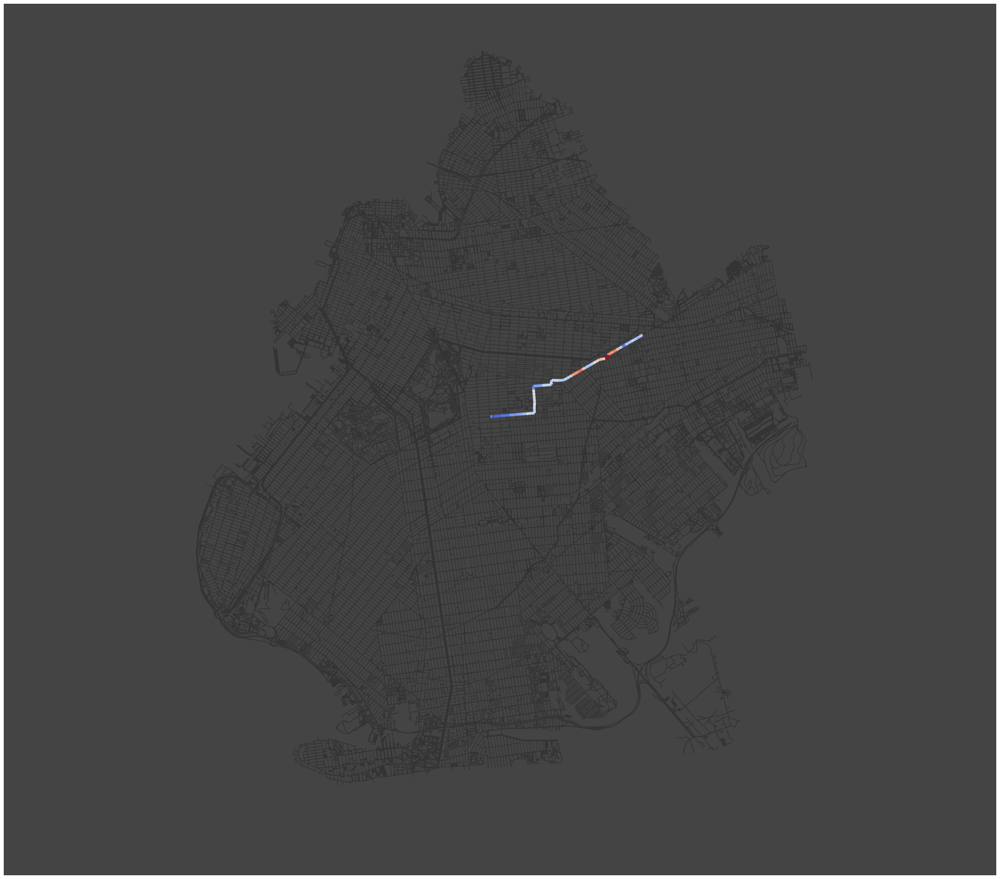

Completed b12 in 365.1284s

----------------------------------------
b37
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308570,05:00:00,4 AV/DEAN ST,None,40.683264,-73.979275,None,None,0,None,POINT (-73.97928 40.68326)
1,901485,05:01:48,3 AV/WARREN ST,None,40.681953,-73.983075,None,None,0,None,POINT (-73.98307 40.68195)
2,302955,05:02:25,3 AV/BUTLER ST,None,40.680635,-73.983974,None,None,0,None,POINT (-73.98397 40.68064)
3,302956,05:03:00,3 AV/DE GRAW ST,None,40.679356,-73.984843,None,None,0,None,POINT (-73.98484 40.67936)
4,302957,05:03:34,3 AV/UNION ST,None,40.678110,-73.985687,None,None,0,None,POINT (-73.98569 40.67811)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
35,308269,05:31:23,3 AV/95 ST,None,40.616997,-74.033765,None,None,0,None,POINT (-74.03377 40.61700)
36,901492,05:31:56,3 AV/97 ST,None,40.615509,-74.034401,None,None,0,None,POINT (-74.03440 40.61551)
37,301724,05:32:59,4 AV/99 ST,None,40.613509,-74.033120,None,None,0,None,POINT (-74.03312 40.61351)
38,301725,05:33:22,4 AV/100 ST,None,40.612591,-74.033902,None,None,0,None,POINT (-74.03390 40.61259)
39,901445,05:34:00,SHORE RD/4 AV,None,40.611716,-74.035076,None,None,0,None,POINT (-74.03508 40.61172)


,trip_id,308570,901485,302955,302956,302957,308263,302960,308746,302962,...,308267,302999,303000,308268,303003,308269,901492,301724,301725,901445
0,JG_C1-Weekday-SDon-030000_B37_602,05:00:00,05:01:48,05:02:25,05:03:00,05:03:34,05:04:57,05:05:50,05:07:00,05:07:40,...,05:27:05,05:27:57,05:29:00,05:29:50,05:30:35,05:31:23,05:31:56,05:32:59,05:33:22,05:34:00
1,JG_C1-Weekday-SDon-033000_B37_604,05:30:00,05:31:48,05:32:25,05:33:00,05:33:34,05:34:57,05:35:50,05:37:00,05:37:40,...,05:57:05,05:57:57,05:59:00,05:59:50,06:00:35,06:01:23,06:01:56,06:02:59,06:03:22,06:04:00
2,JG_C1-Weekday-SDon-036000_B37_601,06:00:00,06:01:48,06:02:25,06:03:00,06:03:34,06:04:57,06:05:50,06:07:00,06:07:45,...,06:31:18,06:32:31,06:34:00,06:34:50,06:35:35,06:36:23,06:36:56,06:37:59,06:38:22,06:39:00
3,JG_C1-Weekday-SDon-038500_B37_603,06:25:00,06:26:48,06:27:25,06:28:00,06:28:34,06:29:57,06:30:50,06:32:00,06:32:45,...,06:56:18,06:57:31,06:59:00,06:59:50,07:00:35,07:01:23,07:01:56,07:02:59,07:03:22,07:04:00
4,JG_C1-Weekday-040500_B37_602,06:45:00,06:46:48,06:47:25,06:48:00,06:48:34,06:49:57,06:50:50,06:52:00,06:52:45,...,07:19:55,07:21:19,07:23:00,07:24:00,07:24:54,07:25:51,07:26:31,07:27:46,07:28:14,07:29:00


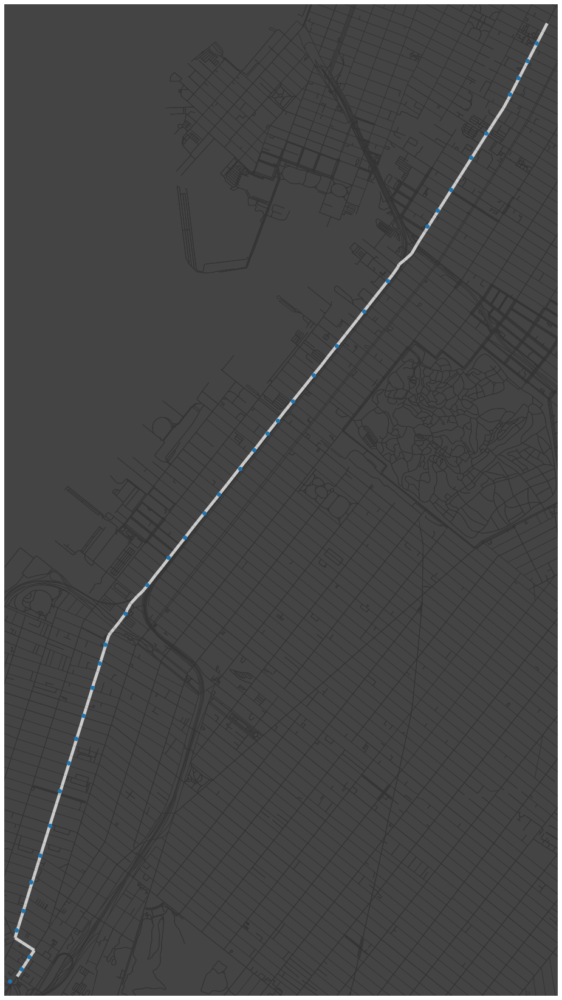

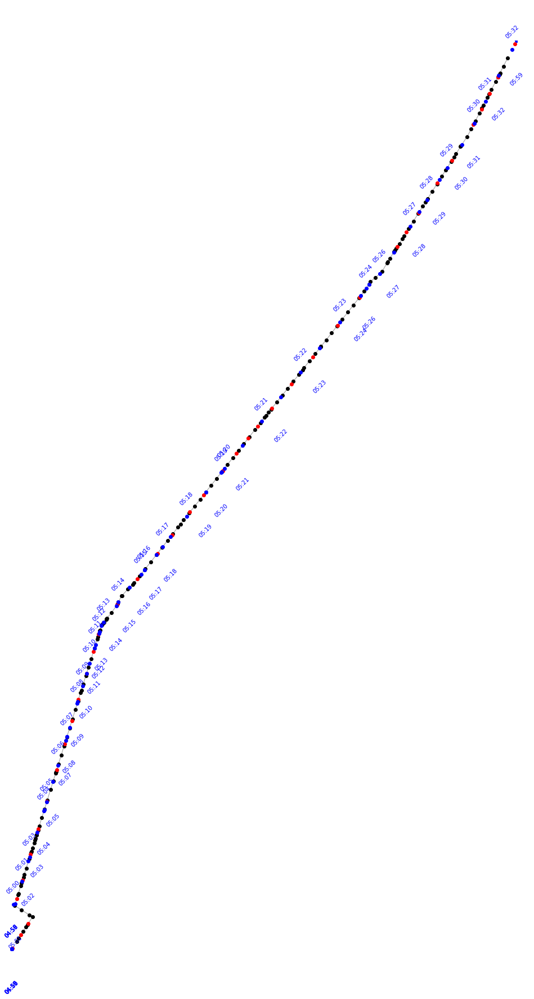

 69%|██████▉   | 11/16 [01:21<00:36,  7.38s/it]


fail


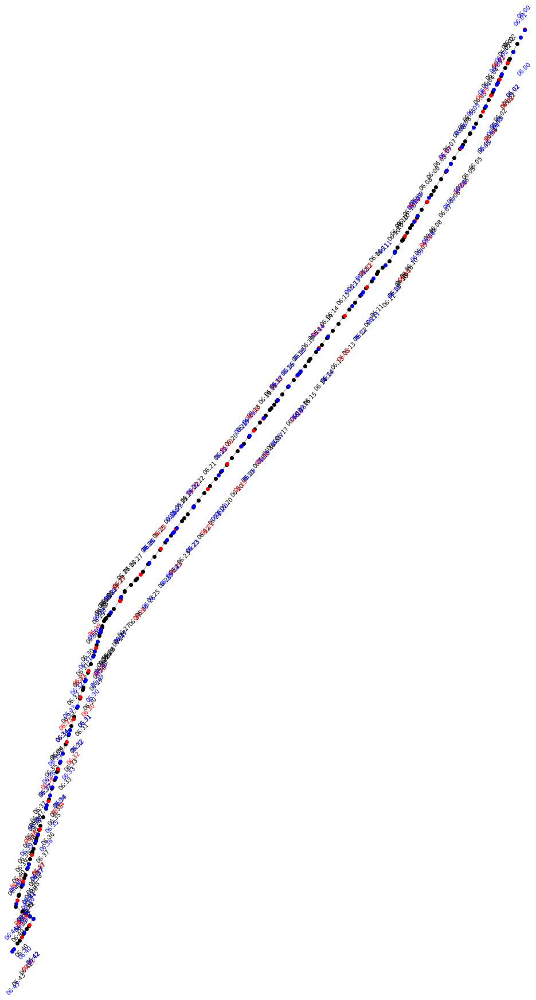

100%|██████████| 20/20 [01:53<00:00,  5.67s/it]


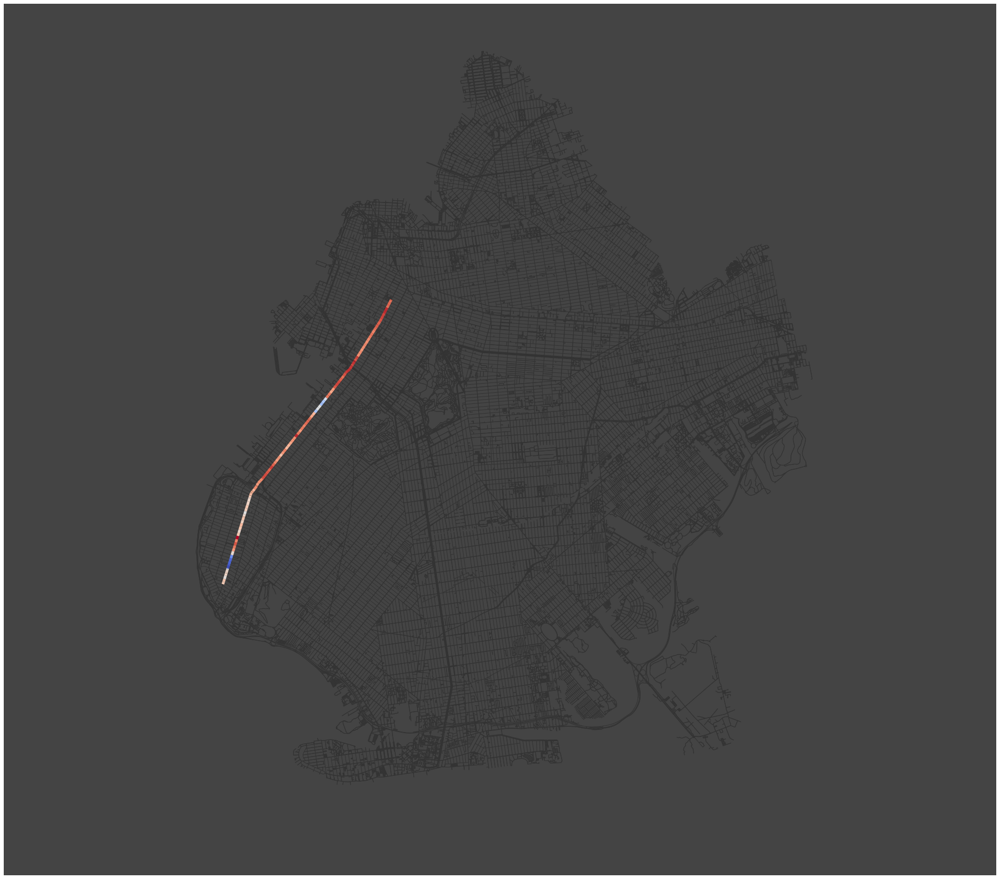

Completed b37 in 227.5382s

----------------------------------------
b43
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305287,01:45:00,BOX ST/MANHATTAN AV,None,40.737195,-73.955670,None,None,0,None,POINT (-73.95567 40.73719)
1,308189,01:45:30,MANHATTAN AV/CLAY ST,None,40.736239,-73.955350,None,None,0,None,POINT (-73.95535 40.73624)
2,305167,01:46:24,MANHATTAN AV/FREEMAN ST,None,40.734065,-73.954997,None,None,0,None,POINT (-73.95500 40.73407)
3,308188,01:47:06,MANHATTAN AV/INDIA ST,None,40.732402,-73.954724,None,None,0,None,POINT (-73.95472 40.73240)
4,305170,01:48:10,MANHATTAN AV/GREENPOINT AV,None,40.729832,-73.954159,None,None,0,None,POINT (-73.95416 40.72983)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
45,303788,02:18:03,EMPIRE BL/NOSTRAND AV,None,40.663963,-73.951411,None,None,0,None,POINT (-73.95141 40.66396)
46,303789,02:18:46,EMPIRE BL/ROGERS AV,None,40.663748,-73.953766,None,None,0,None,POINT (-73.95377 40.66375)
47,303790,02:19:56,EMPIRE BL/BEDFORD AV,None,40.663526,-73.957647,None,None,0,None,POINT (-73.95765 40.66353)
48,303791,02:21:00,WASHINGTON AV/EMPIRE BL,None,40.663103,-73.960971,None,None,0,None,POINT (-73.96097 40.66310)
49,801030,02:22:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,305287,308189,305167,308188,305170,305171,305172,305173,305174,...,303783,303784,303785,303786,303787,303788,303789,303790,303791,801030
0,JG_C1-Weekday-SDon-010500_B43_451,01:45:00,01:45:30,01:46:24,01:47:06,01:48:10,01:49:03,01:49:31,01:50:16,01:51:00,...,02:14:42,02:15:20,02:16:00,02:16:21,02:17:12,02:18:03,02:18:46,02:19:56,02:21:00,02:22:00
1,JG_C1-Weekday-015000_B43_452,02:30:00,02:30:25,02:31:10,02:31:45,02:32:38,02:33:22,02:33:46,02:34:23,02:35:00,...,02:56:42,02:57:20,02:58:00,02:58:21,02:59:12,03:00:03,03:00:46,03:01:56,03:03:00,03:04:00
2,JG_C1-Weekday-SDon-019500_B43_451,03:15:00,03:15:30,03:16:24,03:17:06,03:18:10,03:19:03,03:19:31,03:20:16,03:21:00,...,03:43:42,03:44:20,03:45:00,03:45:21,03:46:12,03:47:03,03:47:46,03:48:56,03:50:00,03:51:00
3,JG_C1-Weekday-SDon-024000_B43_452,04:00:00,04:00:30,04:01:24,04:02:06,04:03:10,04:04:03,04:04:31,04:05:16,04:06:00,...,04:28:42,04:29:20,04:30:00,04:30:21,04:31:12,04:32:03,04:32:46,04:33:56,04:35:00,04:37:00
4,JG_C1-Weekday-028500_B43_453,04:45:00,04:45:30,04:46:24,04:47:06,04:48:10,04:49:03,04:49:31,04:50:16,04:51:00,...,05:20:02,05:21:01,05:22:00,05:22:21,05:23:12,05:24:03,05:24:46,05:25:56,05:27:00,05:29:00


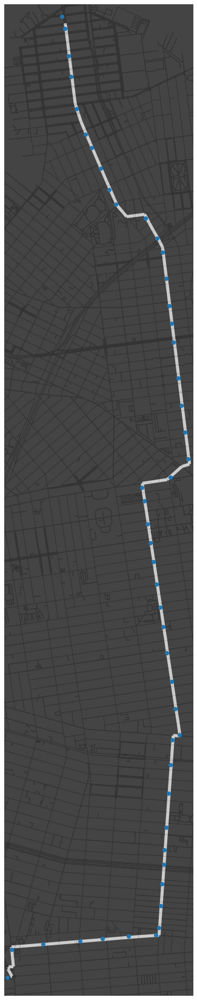

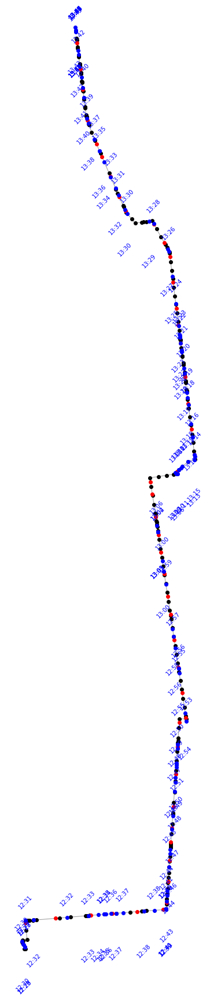

 35%|███▌      | 11/31 [01:19<02:24,  7.21s/it]


fail


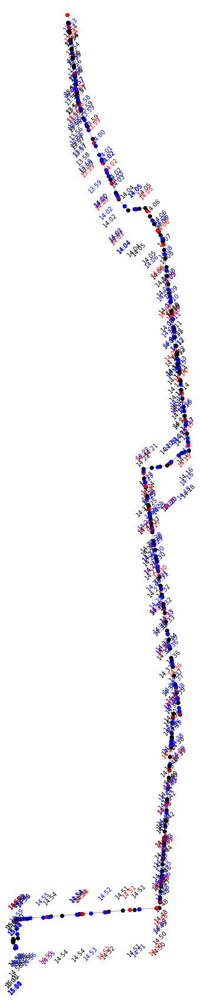

100%|██████████| 33/33 [05:41<00:00, 10.35s/it]


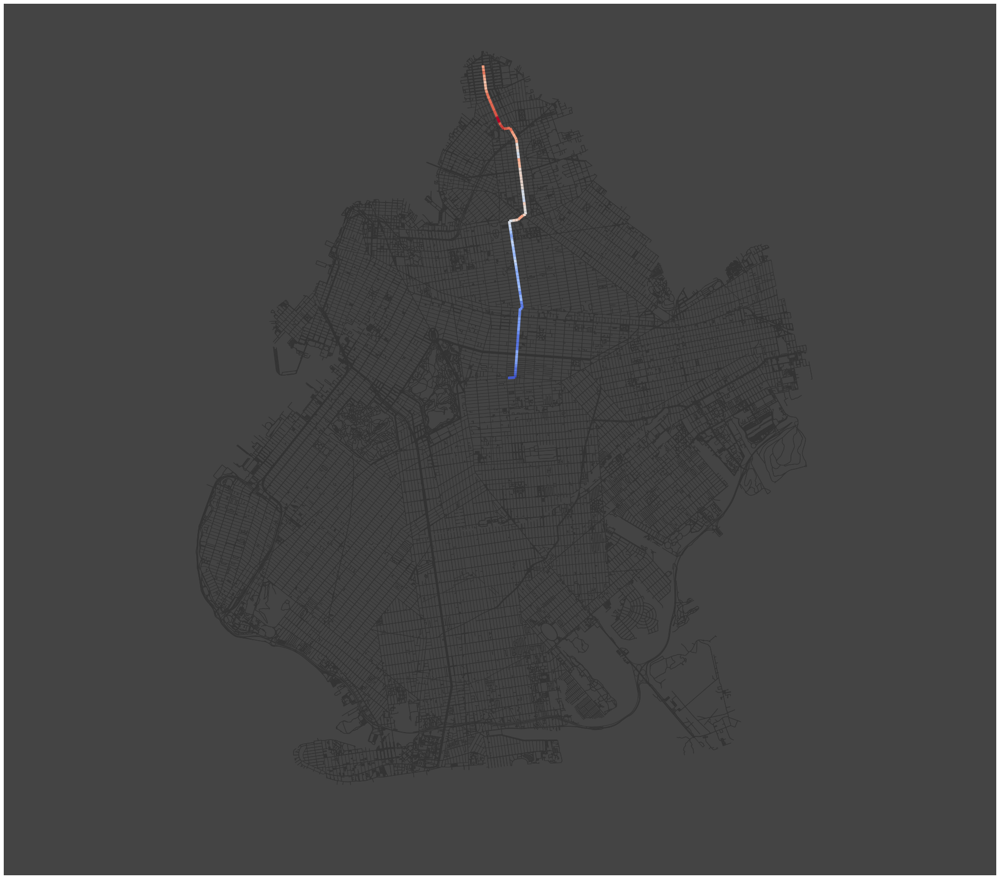

Completed b43 in 459.3196s

----------------------------------------
b48
----------------------------------------




,stop_id,GA_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,303791,01:02:00,WASHINGTON AV/EMPIRE BL,None,40.663103,-73.960971,None,None,0,None,POINT (-73.96097 40.66310)
1,303844,00:31:49,NASSAU AV/HAUSMAN ST,None,40.726183,-73.939109,None,None,0,None,POINT (-73.93911 40.72618)
2,303845,00:32:36,NASSAU AV/KINGSLAND AV,None,40.725927,-73.942029,None,None,0,None,POINT (-73.94203 40.72593)
3,303847,00:33:28,NASSAU AV/HUMBOLDT ST,None,40.725594,-73.945331,None,None,0,None,POINT (-73.94533 40.72559)
4,303848,00:34:08,NASSAU AV/NEWEL ST,None,40.724843,-73.947659,None,None,0,None,POINT (-73.94766 40.72484)


,stop_id,GA_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
41,307169,00:48:00,FRANKLIN AV/FLUSHING AV,None,40.698328,-73.958858,None,None,0,None,POINT (-73.95886 40.69833)
42,307553,00:51:55,FRANKLIN AV/GREENE AV,None,40.687399,-73.956963,None,None,0,None,POINT (-73.95696 40.68740)
43,307632,00:30:57,NASSAU AV/VARICK ST,None,40.726541,-73.936230,None,None,0,None,POINT (-73.93623 40.72654)
44,308073,00:54:00,FRANKLIN AV/FULTON ST,None,40.680595,-73.955606,None,None,0,None,POINT (-73.95561 40.68059)
45,801030,01:04:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,303791,303844,303845,303847,303848,303849,303850,303852,303853,...,303886,303887,303888,305175,306480,307169,307553,307632,308073,801030
0,GA_C1-Weekday-SDon-003000_B48_501,01:02:00,00:31:49,00:32:36,00:33:28,00:34:08,00:34:36,00:35:00,00:36:56,00:37:44,...,00:59:44,01:00:31,01:01:32,00:35:38,00:30:00,00:48:00,00:51:55,00:30:57,00:54:00,01:04:00
1,GA_C1-Weekday-007500_B48_502,01:47:00,01:16:49,01:17:36,01:18:28,01:19:08,01:19:36,01:20:00,01:21:56,01:22:44,...,01:44:44,01:45:31,01:46:32,01:20:38,01:15:00,01:33:00,01:36:55,01:15:57,01:39:00,01:49:00
2,GA_C1-Weekday-SDon-012000_B48_501,02:32:00,02:01:49,02:02:36,02:03:28,02:04:08,02:04:36,02:05:00,02:06:56,02:07:44,...,02:29:44,02:30:31,02:31:32,02:05:38,02:00:00,02:18:00,02:21:55,02:00:57,02:24:00,02:34:00
3,GA_C1-Weekday-SDon-016500_B48_502,03:17:00,02:46:49,02:47:36,02:48:28,02:49:08,02:49:36,02:50:00,02:51:56,02:52:44,...,03:14:44,03:15:31,03:16:32,02:50:38,02:45:00,03:03:00,03:06:55,02:45:57,03:09:00,03:19:00
4,GA_C1-Weekday-021000_B48_501,04:04:00,03:32:11,03:33:07,03:34:10,03:34:58,03:35:31,03:36:00,03:37:56,03:38:44,...,04:01:44,04:02:31,04:03:32,03:36:38,03:30:00,03:50:00,03:53:55,03:31:08,03:56:00,04:06:00


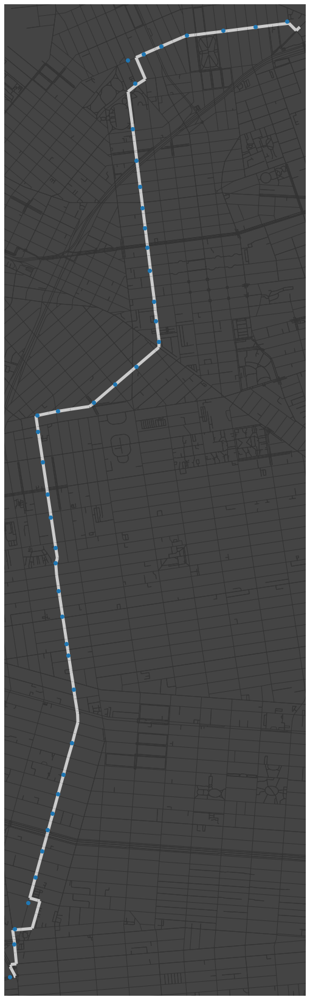

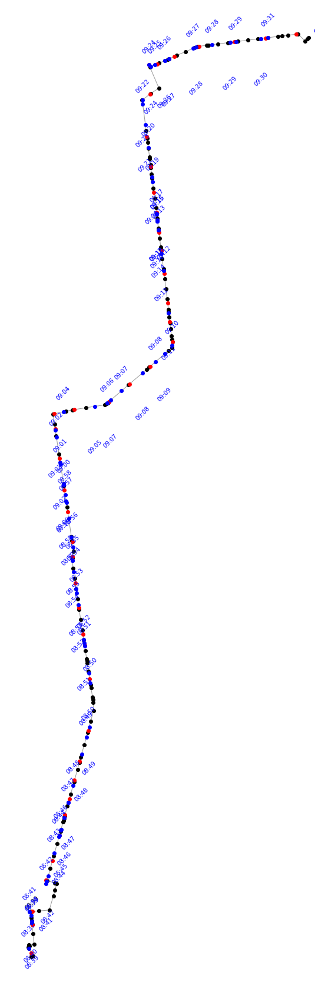

 37%|███▋      | 11/30 [00:49<01:25,  4.52s/it]


fail


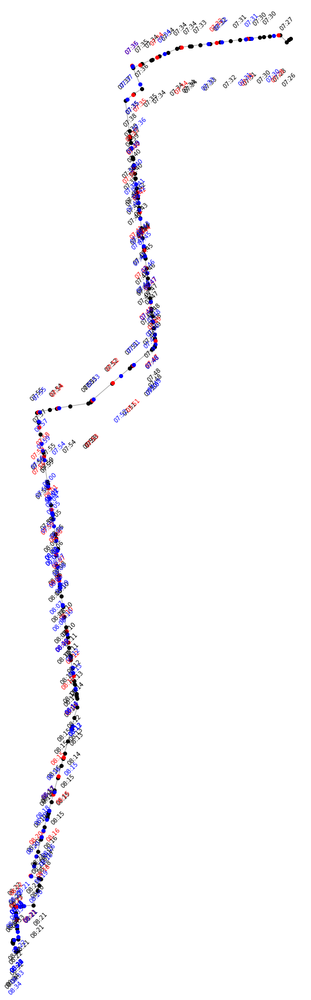

  0%|          | 0/31 [00:00<?, ?it/s]

No Match Error at MTA NYCT_4437


  3%|▎         | 1/31 [00:07<03:44,  7.48s/it]

No Match Error at MTA NYCT_4437
No Match Error at MTA NYCT_4437
No Match Error at MTA NYCT_4562


  6%|▋         | 2/31 [00:11<02:35,  5.35s/it]

No Match Error at MTA NYCT_4562


 10%|▉         | 3/31 [00:13<01:44,  3.72s/it]

No Match Error at MTA NYCT_4568
No Match Error at MTA NYCT_4568


 13%|█▎        | 4/31 [00:17<01:49,  4.05s/it]

No Match Error at MTA NYCT_4568


 16%|█▌        | 5/31 [00:19<01:26,  3.33s/it]

No Match Error at MTA NYCT_4702
No Match Error at MTA NYCT_7198


 19%|█▉        | 6/31 [00:23<01:27,  3.48s/it]

No Match Error at MTA NYCT_7202
No Match Error at MTA NYCT_7202
No Match Error at MTA NYCT_7202
No Match Error at MTA NYCT_7202


 23%|██▎       | 7/31 [00:31<01:56,  4.87s/it]

No Match Error at MTA NYCT_7205
No Match Error at MTA NYCT_7205


 26%|██▌       | 8/31 [00:37<01:59,  5.22s/it]

No Match Error at MTA NYCT_7205
No Match Error at MTA NYCT_7205


 32%|███▏      | 10/31 [00:41<01:17,  3.67s/it]

No Match Error at MTA NYCT_7218


 35%|███▌      | 11/31 [00:46<01:24,  4.22s/it]

No Match Error at MTA NYCT_7218
No Match Error at MTA NYCT_7218
fail
Could not match B48 to timetable
Completed b48 in 123.6528s

----------------------------------------
b68
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305733,00:30:00,PROSPECT PK SW/BARTEL PRITCHARD SQ,None,40.660699,-73.979409,None,None,0,None,POINT (-73.97941 40.66070)
1,305734,00:30:41,PROSPECT PK SW/10 AV,None,40.659626,-73.977217,None,None,0,None,POINT (-73.97722 40.65963)
2,305735,00:31:26,PROSPECT PK SW/11 AV,None,40.658472,-73.974832,None,None,0,None,POINT (-73.97483 40.65847)
3,305736,00:32:22,PROSPECT PK SW/TERRACE PL,None,40.656027,-73.973766,None,None,0,None,POINT (-73.97377 40.65603)
4,305738,00:33:13,PROSPECT PK SW/REEVE PL,None,40.653608,-73.973039,None,None,0,None,POINT (-73.97304 40.65361)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
45,308306,01:03:30,NEPTUNE AV/W 6 ST,None,40.580064,-73.974502,None,None,0,None,POINT (-73.97450 40.58006)
46,308307,01:03:58,NEPTUNE AV/SHELL RD,None,40.579819,-73.976528,None,None,0,None,POINT (-73.97653 40.57982)
47,308308,01:04:38,NEPTUNE AV/W 12 ST,None,40.579518,-73.979394,None,None,0,None,POINT (-73.97939 40.57952)
48,306419,01:05:15,STILLWELL AV/NEPTUNE AV,None,40.579067,-73.982011,None,None,0,None,POINT (-73.98201 40.57907)
49,801074,01:06:00,STILLWELL/TERMINAL,None,40.576864,-73.981026,None,None,0,None,POINT (-73.98103 40.57686)


,trip_id,305733,305734,305735,305736,305738,305739,305740,305741,305742,...,300122,300016,308304,306594,308305,308306,308307,308308,306419,801074
0,JG_C1-Weekday-SDon-003000_B68_951,00:30:00,00:30:41,00:31:26,00:32:22,00:33:13,00:33:41,00:34:40,00:35:18,00:36:00,...,01:00:26,01:00:42,01:01:24,01:02:03,01:02:57,01:03:30,01:03:58,01:04:38,01:05:15,01:06:00
1,JG_C1-Weekday-007200_B68_952,01:12:00,01:12:41,01:13:26,01:14:22,01:15:13,01:15:41,01:16:40,01:17:18,01:18:00,...,01:42:26,01:42:42,01:43:24,01:44:03,01:44:57,01:45:30,01:45:58,01:46:38,01:47:15,01:48:00
2,JG_C1-Weekday-SDon-011400_B68_951,01:54:00,01:54:28,01:54:57,01:55:35,01:56:09,01:56:27,01:57:07,01:57:32,01:58:00,...,02:20:26,02:20:42,02:21:24,02:22:03,02:22:57,02:23:30,02:23:58,02:24:38,02:25:15,02:26:00
3,JG_C1-Weekday-SDon-015400_B68_952,02:34:00,02:34:28,02:34:57,02:35:35,02:36:09,02:36:27,02:37:07,02:37:32,02:38:00,...,03:00:26,03:00:42,03:01:24,03:02:03,03:02:57,03:03:30,03:03:58,03:04:38,03:05:15,03:06:00
4,JG_C1-Weekday-SDon-019400_B68_951,03:14:00,03:14:28,03:14:57,03:15:35,03:16:09,03:16:27,03:17:07,03:17:32,03:18:00,...,03:40:26,03:40:42,03:41:24,03:42:03,03:42:57,03:43:30,03:43:58,03:44:38,03:45:15,03:46:00


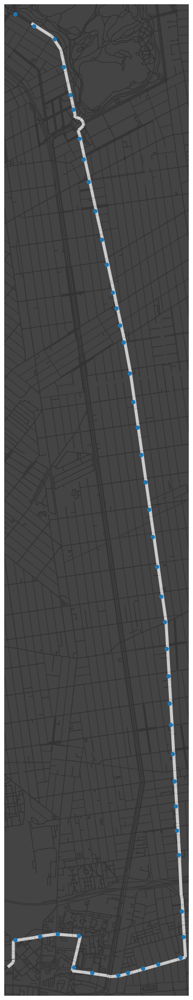

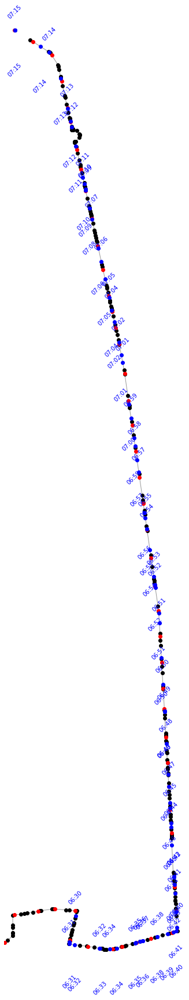

 29%|██▉       | 11/38 [01:42<04:12,  9.34s/it]


fail


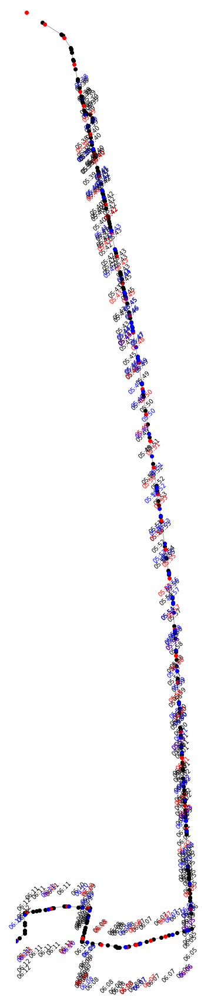

100%|██████████| 34/34 [08:04<00:00, 14.26s/it]


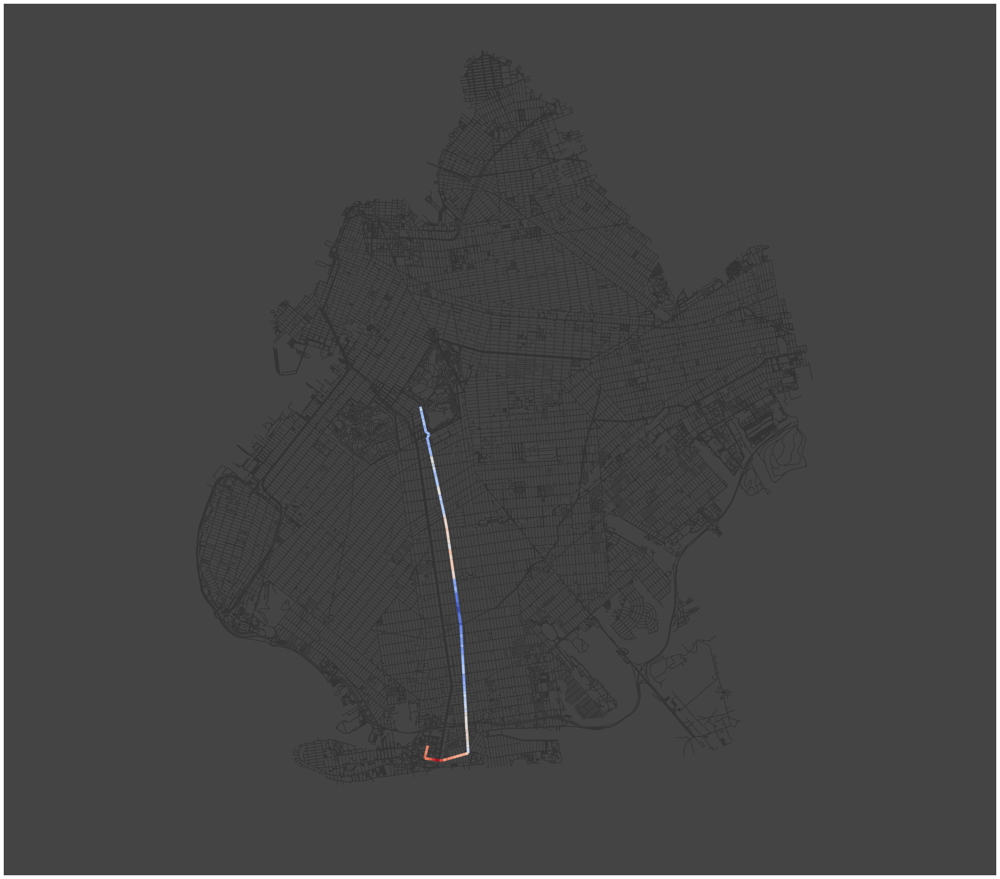

Completed b68 in 624.1666s


In [127]:
ROUTES_WITH_ERRORS = [
    'b12',
    'b37',
    'b43',
    'b48',
    'b68',
]
analysis = Analysis(ROUTES_WITH_ERRORS)
analysis.run()

In [227]:
ROUTES_STOPS = [
#    'b3',
#    'b6',
#    'b8',
    'b9',
    'b11',
    'b12',
    'b16',
    'b25',
    'b26',
    'b35',
    'b37',
    'b43',
    'b44',
    'b48',
    'b52',
#    'b61',
    'b63',
    'b65',
    'b68',
    'b82',
]
analysis = Analysis(ROUTES_STOPS, plot=False)
analysis.run()


----------------------------------------
b9
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307941,04:45:00,SHORE RD/71 ST,None,40.636852,-74.036257,None,None,0,None,POINT (-74.03626 40.63685)
1,300071,04:45:56,BAY RIDGE AV/SHORE RD,None,40.638570,-74.035368,None,None,0,None,POINT (-74.03537 40.63857)
2,307200,04:46:30,BAY RIDGE AV/NARROWS AV,None,40.638000,-74.033530,None,None,0,None,POINT (-74.03353 40.63800)
3,300073,04:47:19,BAY RIDGE AV/COLONIAL RD,None,40.637191,-74.030921,None,None,0,None,POINT (-74.03092 40.63719)
4,300074,04:48:07,BAY RIDGE AV/RIDGE BL,None,40.636379,-74.028312,None,None,0,None,POINT (-74.02831 40.63638)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
51,303339,None,FLATBUSH AV/AV R,None,40.615975,-73.929712,None,None,0,None,POINT (-73.92971 40.61597)
52,303340,None,FLATBUSH AV/FILLMORE AV,None,40.614695,-73.928280,None,None,0,None,POINT (-73.92828 40.61469)
53,303341,None,FLATBUSH AV/AV S,None,40.613075,-73.926474,None,None,0,None,POINT (-73.92647 40.61308)
54,307636,None,FLATBUSH AV/AV T,None,40.611273,-73.924426,None,None,0,None,POINT (-73.92443 40.61127)
55,801039,None,Kings Plaza (B9 term),None,40.608306,-73.920622,None,None,0,None,POINT (-73.92062 40.60831)


,trip_id,307941,300071,307200,300073,300074,300075,308239,308240,308650,...,300966,307199,303323,303324,303338,303339,303340,303341,307636,801039
0,JG_C1-Weekday-SDon-028500_B9_201,04:45:00,04:45:56,04:46:30,04:47:19,04:48:07,04:49:00,04:49:47,04:50:29,04:51:27,...,05:18:24,05:19:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,JG_C1-Weekday-SDon-030000_B9_202,05:00:00,05:00:56,05:01:30,05:02:19,05:03:07,05:04:00,05:04:47,05:05:29,05:06:27,...,05:33:24,05:34:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,JG_C1-Weekday-SDon-031200_B9_203,05:12:00,05:12:56,05:13:30,05:14:19,05:15:07,05:16:00,05:16:47,05:17:29,05:18:27,...,05:48:12,05:49:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,JG_C1-Weekday-SDon-032400_B9_204,05:24:00,05:24:56,05:25:30,05:26:19,05:27:07,05:28:00,05:28:47,05:29:29,05:30:27,...,06:01:12,06:02:00,06:02:59,06:04:00,06:04:52,06:06:04,06:07:00,06:08:11,06:09:32,06:12:00
4,JG_C1-Weekday-SDon-033600_B9_205,05:36:00,05:37:10,05:37:53,05:38:54,05:39:54,05:41:00,05:41:56,05:42:46,05:43:56,...,06:19:00,06:20:00,06:20:59,06:22:00,06:22:52,06:24:04,06:25:00,06:26:11,06:27:32,06:30:00


 12%|█▏        | 3/25 [01:10<07:31, 20.51s/it]

Error at MTA NYCT_248


100%|██████████| 25/25 [08:56<00:00, 21.47s/it]


,trip_id,300071,307200,300073,300074,300075,308239,308240,308650,308242,...,300962,300963,306782,300966,307199,303323,303324,303338,303339,303340
0,JG_C1-Weekday-SDon-046200_B9_219,-30.025871,-28.512846,-35.959583,-17.323338,8.694876,24.304336,28.923382,82.630406,43.188321,...,-169.558311,-168.579939,-171.400656,-156.099240,-138.552244,-154.143113,-182.087466,-176.828510,-201.586881,-225.393177
0,JG_C1-Weekday-SDon-063000_B9_219,25.403072,10.597615,-0.222096,-0.500469,4.950552,-10.938526,-20.545973,8.807531,-27.485658,...,45.953089,63.648334,40.705236,19.315892,4.791555,33.418926,18.852918,14.107090,4.862882,-6.296007
0,JG_C1-Weekday-080000_B9_214,-1.853356,-17.917940,-2.672718,-37.743703,-48.439218,-71.325039,-106.496712,-73.183668,-74.282790,...,-236.124568,-219.270601,-262.630255,-255.713273,-142.820444,-116.934593,-203.275092,-214.325219,-210.411397,-142.172595
0,JG_C1-Weekday-099100_B9_226,NaN,-274.800371,-277.290454,-268.362890,-226.398881,-177.288146,-171.580481,-98.639436,-87.689388,...,-229.922053,-197.735755,-221.713927,-266.135091,-281.538631,-301.998439,-309.993193,-325.642829,-350.160627,-303.976823
0,JG_C1-Weekday-123200_B9_231,12.402956,5.454658,31.800016,26.393656,41.438370,60.145024,69.355350,86.088222,65.234686,...,212.502173,215.386850,225.215272,186.801512,151.189279,139.557229,168.630567,155.879184,146.741465,135.762502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,JG_C1-Weekday-125300_B9_232,NaN,-63.386782,-46.734689,-35.113932,-33.922598,-6.577649,-7.379129,-20.399926,-10.392588,...,-50.048998,-55.166533,-86.848166,-99.226169,-135.375385,-110.641016,-124.274454,-133.815526,-152.687921,103.289684
0,JG_C1-Weekday-139000_B9_232,NaN,-203.447382,-221.465015,-219.551698,-167.341840,-158.466789,-134.495963,-174.128585,-203.657492,...,195.806095,212.465048,216.565992,217.350761,233.814526,240.031606,228.044243,210.611005,191.689793,190.978903
0,JG_C1-Weekday-045400_B9_218,8.077167,-10.843085,-42.582432,-11.446742,-6.586245,0.457465,-2.715058,-50.965915,-88.253648,...,-113.870474,-109.503275,-114.404436,-134.208685,-125.122773,-103.158067,-144.133727,-163.697947,-180.026990,-186.264586
0,JG_C1-Weekday-SDon-078000_B9_228,33.720552,33.452305,-9.092006,-2.910003,-9.052597,21.343411,32.373702,31.351049,78.190592,...,-165.602420,-168.455550,-177.812904,-226.592795,-195.045676,-224.731987,-186.586987,-202.364893,-140.817663,-91.566219


Completed b9 in 542.8598s

----------------------------------------
b11
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307484,04:08:00,58 ST/1 Av,None,40.645419,-74.023199,None,None,0,None,POINT (-74.02320 40.64542)
1,307485,04:09:24,2 AV/56 ST,None,40.645954,-74.020082,None,None,0,None,POINT (-74.02008 40.64595)
2,301162,04:10:37,52 ST/2 AV,None,40.647742,-74.017809,None,None,0,None,POINT (-74.01781 40.64774)
3,308052,04:11:40,52 ST/3 AV,None,40.646227,-74.015297,None,None,0,None,POINT (-74.01530 40.64623)
4,306579,04:12:13,52 ST/4 AV,None,40.645434,-74.013992,None,None,0,None,POINT (-74.01399 40.64543)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
35,300535,04:36:27,BEDFORD AV/AV I,None,40.628783,-73.951952,None,None,0,None,POINT (-73.95195 40.62878)
36,300536,04:38:07,BEDFORD AV/CAMPUS RD,None,40.632483,-73.952713,None,None,0,None,POINT (-73.95271 40.63248)
37,300538,04:38:35,GLENWOOD RD/BEDFORD AV,None,40.633378,-73.952817,None,None,0,None,POINT (-73.95282 40.63338)
38,300540,04:39:48,GLENWOOD RD/FLATBUSH AV,None,40.634365,-73.949541,None,None,0,None,POINT (-73.94954 40.63437)
39,306468,04:41:00,NOSTRAND AV/FLATBUSH AV,None,40.632419,-73.947699,None,None,0,None,POINT (-73.94770 40.63242)


,trip_id,307484,307485,301162,308052,306579,306580,306581,301168,307618,...,300529,300530,307706,300532,300534,300535,300536,300538,300540,306468
0,JG_C1-Weekday-SDon-024800_B11_301,04:08:00,04:09:24,04:10:37,04:11:40,04:12:13,04:13:05,04:14:00,04:15:00,04:16:01,...,04:32:15,04:33:05,04:33:45,04:34:29,04:35:27,04:36:27,04:38:07,04:38:35,04:39:48,04:41:00
1,JG_C1-Weekday-SDon-027000_B11_302,04:30:00,04:31:24,04:32:37,04:33:40,04:34:13,04:35:05,04:36:00,04:37:00,04:38:01,...,04:54:15,04:55:05,04:55:45,04:56:29,04:57:27,04:58:27,05:00:07,05:00:35,05:01:48,05:03:00
2,JG_C1-Weekday-SDon-029000_B11_303,04:50:00,04:51:24,04:52:37,04:53:40,04:54:13,04:55:05,04:56:00,04:57:00,04:58:01,...,05:14:15,05:15:05,05:15:45,05:16:29,05:17:27,05:18:27,05:20:07,05:20:35,05:21:48,05:23:00
3,JG_C1-Weekday-SDon-030500_B11_304,05:05:00,05:06:24,05:07:37,05:08:40,05:09:13,05:10:05,05:11:00,05:12:00,05:13:01,...,05:29:15,05:30:05,05:30:45,05:31:29,05:32:27,05:33:27,05:35:07,05:35:35,05:36:48,05:38:00
4,JG_C1-Weekday-SDon-032000_B11_305,05:20:00,05:21:24,05:22:37,05:23:40,05:24:13,05:25:05,05:26:00,05:27:00,05:28:01,...,05:48:15,05:49:05,05:49:45,05:50:29,05:51:27,05:52:27,05:54:07,05:54:35,05:55:48,05:57:00


100%|██████████| 29/29 [05:53<00:00, 12.17s/it]


,trip_id,301162,308052,306579,306580,306581,301168,307618,301170,301171,...,301189,308053,300529,300530,307706,300532,300534,300535,300536,307485
0,JG_C1-Weekday-SDon-034800_B11_306,223.688452,221.570516,245.983123,240.042103,262.604110,274.538154,278.910514,354.551617,345.905337,...,467.797773,465.960034,506.736823,524.323928,523.950803,533.032084,600.566557,605.406908,620.081384,NaN
0,JG_C1-Weekday-047200_B11_317,-256.027621,-270.045010,-228.106414,-202.765434,-186.791493,-183.958883,-211.020532,-245.137314,-264.868661,...,-577.950990,-619.601305,-673.425798,-695.038404,-650.569054,-682.426882,-699.218324,-735.113171,-850.252338,-239.513919
0,JG_C1-Weekday-060800_B11_304,26.032860,51.290527,44.575521,28.886979,55.653972,84.158114,64.303590,53.316383,58.789408,...,228.147218,239.352150,206.086274,204.384122,196.781735,193.800454,148.142195,119.307608,62.647255,-6.602084
0,JG_C1-Weekday-SDon-074500_B11_318,-221.034651,-183.893701,-135.320285,-146.870400,-162.327805,-144.805284,-164.909872,-164.676208,-198.032200,...,-85.623220,-47.411511,-43.423455,-76.818702,-21.654951,1.199423,5.859047,-37.924623,-111.326367,-209.431724
0,JG_C1-Weekday-SDon-089300_B11_318,-262.875713,-258.473722,-257.711348,-216.565038,-199.069325,-146.952363,-164.640743,-165.578782,-173.294479,...,-307.112105,-365.653494,-332.324368,-365.991629,-378.001394,-376.319457,-426.224701,-476.191842,-565.492217,-259.365485
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,JG_C1-Weekday-SDon-049600_B11_312,30.111824,30.754130,49.205150,50.363683,88.126887,86.672822,62.544705,60.684789,-6.726264,...,-380.012078,-384.801371,-377.915870,-362.046980,-364.964687,-365.744722,-402.853200,-433.761426,-553.028660,61.359031
0,JG_C1-Weekday-069200_B11_312,251.877152,316.316308,379.614963,389.799782,400.542842,425.154395,401.522206,383.703953,369.694756,...,240.081002,231.712407,184.680311,169.656474,189.230448,186.142962,133.219201,98.240832,36.504395,NaN
0,JG_C1-Weekday-SDon-084200_B11_316,-95.689605,-69.090368,-74.537620,-87.659618,-116.505708,-66.009747,-80.201992,-83.956918,-73.413687,...,-690.989151,-676.859707,-705.994554,-756.746328,-762.467994,-751.775414,-814.085608,-854.925095,-902.620113,-90.648169
0,JG_C1-Weekday-SDon-098300_B11_312,-227.962055,-267.204960,-227.339215,-223.990930,-98.049894,620.663985,628.974897,611.746457,569.220667,...,123.869184,55.688870,73.574970,86.948984,153.179143,132.899767,102.466089,120.311936,90.973116,-218.039491


Completed b11 in 357.4337s

----------------------------------------
b12
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,301386,01:17:37,PACIFIC ST/EAST NEW YORK AV,None,40.675270,-73.905186,None,None,0,None,POINT (-73.90519 40.67527)
1,301387,01:18:08,SACKMAN ST/DEAN ST,None,40.674606,-73.906329,None,None,0,None,POINT (-73.90633 40.67461)
2,301388,01:19:01,EAST NEW YORK AV/MOTHER GASTON BL,None,40.673244,-73.908786,None,None,0,None,POINT (-73.90879 40.67324)
3,301389,01:19:19,EAST NEW YORK AV/ST MARKS AV,None,40.672850,-73.909703,None,None,0,None,POINT (-73.90970 40.67285)
4,301390,01:19:57,EAST NEW YORK AV/ROCKAWAY AV,None,40.671959,-73.911737,None,None,0,None,POINT (-73.91174 40.67196)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
26,307120,01:20:53,EAST NEW YORK AV/STERLING PL,None,40.670669,-73.914698,None,None,0,None,POINT (-73.91470 40.67067)
27,307309,01:24:49,EAST NEW YORK AV/PORTAL ST,None,40.666331,-73.924710,None,None,0,None,POINT (-73.92471 40.66633)
28,308274,01:22:26,NEW YORK AV/LINCOLN PL,None,40.668604,-73.919270,None,None,0,None,POINT (-73.91927 40.66860)
29,801177,01:16:00,ALABAMA AV / FULTON ST,None,40.676746,-73.899944,None,None,0,None,POINT (-73.89994 40.67675)
30,901089,01:41:00,PARKSIDE AV/OCEAN AV,None,40.654848,-73.961754,None,None,0,None,POINT (-73.96175 40.65485)


,trip_id,301386,301387,301388,301389,301390,301392,301395,301397,301398,...,301413,301414,306348,306349,306438,307120,307309,308274,801177,901089
0,EN_C1-Weekday-SDon-007600_B12_1,01:17:37,01:18:08,01:19:01,01:19:19,01:19:57,01:22:00,01:25:38,01:26:03,01:27:01,...,01:39:49,01:40:33,01:24:08,01:34:58,01:28:00,01:20:53,01:24:49,01:22:26,01:16:00,01:41:00
1,EN_C1-Weekday-011600_B12_2,01:57:21,01:57:47,01:58:31,01:58:46,01:59:17,02:01:00,02:04:02,02:04:22,02:05:11,...,02:17:49,02:18:33,02:02:47,02:12:58,02:06:00,02:00:04,02:03:21,02:01:22,01:56:00,02:19:00
2,EN_C1-Weekday-SDon-015600_B12_1,02:37:21,02:37:47,02:38:31,02:38:46,02:39:17,02:41:00,02:44:02,02:44:22,02:45:11,...,02:57:49,02:58:33,02:42:47,02:52:58,02:46:00,02:40:04,02:43:21,02:41:22,02:36:00,02:59:00
3,EN_C1-Weekday-SDon-019600_B12_2,03:17:21,03:17:47,03:18:31,03:18:46,03:19:17,03:21:00,03:24:02,03:24:22,03:25:11,...,03:37:49,03:38:33,03:22:47,03:32:58,03:26:00,03:20:04,03:23:21,03:21:22,03:16:00,03:39:00
4,EN_C1-Weekday-SDon-023100_B12_3,03:52:21,03:52:47,03:53:31,03:53:46,03:54:17,03:56:00,03:59:02,03:59:22,04:00:11,...,04:12:49,04:13:33,03:57:47,04:07:58,04:01:00,03:55:04,03:58:21,03:56:22,03:51:00,04:14:00


 22%|██▏       | 11/49 [00:52<03:02,  4.80s/it]


fail


100%|██████████| 48/48 [07:05<00:00,  8.87s/it]


,trip_id,301386,301387,301388,301389,301390,301392,301395,301397,301398,...,301408,301409,301410,301411,301412,301413,306348,306349,306438,307120
0,EN_C1-Weekday-SDon-032200_B12_7,51.085880,41.750996,6.262139,1.454758,-2.433756,30.838982,12.171513,-0.459965,10.887757,...,-70.819419,-66.398873,-99.663941,-113.928425,-78.813473,-46.861077,8.564977,-57.154364,-0.764097,23.735423
0,EN_C1-Weekday-041000_B12_7,-50.439642,20.846507,-2.824719,-16.065553,-39.444263,-2.441367,-83.493661,-56.259478,-31.114679,...,-28.033819,-53.830484,-39.063111,-3.439654,5.337247,20.611525,-64.743880,-16.898539,-90.967299,-44.471750
0,EN_C1-Weekday-051900_B12_7,574.073659,543.170501,475.061313,451.718359,415.609199,304.506123,68.107464,38.155103,33.706622,...,70.254008,15.107489,-87.419167,-54.773380,-103.833478,-29.326592,178.155981,33.791824,35.468700,398.511485
0,EN_C1-Weekday-SDon-047100_B12_5,-53.000057,-48.327876,-116.413473,-130.525299,-124.039637,-187.873955,-289.402019,-308.826838,-330.021493,...,-556.447463,-554.660685,-570.730630,-536.725256,-514.886809,-423.712135,-286.274121,-535.404770,-296.893436,-136.443462
0,EN_C1-Weekday-SDon-100100_B12_28,-51.667253,-92.054105,-140.417669,-122.279062,-167.648292,-190.520467,-235.825934,-260.889851,-234.880457,...,-246.322559,-293.575649,-252.819249,-147.199799,-211.218640,-190.167462,-171.542604,-256.654243,-219.112108,-160.310891
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,EN_C1-Weekday-SDon-031000_B12_6,31.045115,116.351547,99.970836,88.173134,67.752020,128.121491,37.258674,21.617776,59.114950,...,79.949022,103.061376,119.054586,112.045038,149.866021,205.482882,93.890749,120.320436,108.785903,130.351911
0,EN_C1-Weekday-SDon-040400_B12_13,-271.374952,-196.662094,-233.349666,-248.846025,-278.045478,-247.071211,-256.854221,-269.829798,-255.561590,...,-176.768253,-159.376300,-189.760408,-183.914051,-161.947029,-182.412508,-288.822539,-170.814115,-206.985555,-282.072396
0,EN_C1-Weekday-SDon-051200_B12_13,-334.210220,-121.720270,-122.330448,-104.764025,-140.730429,-104.335578,-206.180417,-182.384285,-158.057547,...,-156.607650,-145.470172,-126.930024,-137.467712,-176.887356,-123.833872,-155.570775,-129.994548,-211.563640,-102.281045
0,EN_C1-Weekday-119200_B12_29,-270.757062,-274.209200,-317.221494,-326.702082,-325.128032,-282.843076,-393.304255,-403.727048,-422.695841,...,-409.578071,-503.416952,-560.976804,-546.379140,-566.952369,-551.764473,-333.876379,-456.334370,-391.431347,-338.737883


Completed b12 in 487.6412s

----------------------------------------
b16
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,301602,06:33:00,SHORE RD/4 AV,None,40.611761,-74.035120,None,None,0,None,POINT (-74.03512 40.61176)
1,301603,06:33:23,SHORE RD/3 AV,None,40.612824,-74.036255,None,None,0,None,POINT (-74.03625 40.61282)
2,301604,06:33:46,SHORE RD/99 ST,None,40.614081,-74.037102,None,None,0,None,POINT (-74.03710 40.61408)
3,301605,06:34:11,SHORE RD/97 ST,None,40.615508,-74.037701,None,None,0,None,POINT (-74.03770 40.61551)
4,301606,06:34:47,SHORE RD/RIDGE BL,None,40.617525,-74.038876,None,None,0,None,POINT (-74.03888 40.61753)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
56,308349,07:28:00,OCEAN AV/PARKSIDE AV,None,40.655139,-73.961837,None,None,0,None,POINT (-73.96184 40.65514)
57,307641,07:28:59,OCEAN AV/231 OCEAN AVENUE,None,40.657322,-73.962200,None,None,0,None,POINT (-73.96220 40.65732)
58,307642,07:30:36,OCEAN AV/LINCOLN RD,None,40.660874,-73.962778,None,None,0,None,POINT (-73.96278 40.66087)
59,307646,07:31:56,FLATBUSH AV/OCEAN AV,None,40.662643,-73.962143,None,None,0,None,POINT (-73.96214 40.66264)
60,801030,07:33:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,301602,301603,301604,301605,301606,301607,301608,301609,301610,...,301657,301658,301659,307638,307639,308349,307641,307642,307646,801030
0,JG_C1-Weekday-SDon-039300_B16_401,06:33:00,06:33:23,06:33:46,06:34:11,06:34:47,06:35:21,06:36:05,06:36:25,06:37:00,...,07:22:01,07:23:01,07:24:02,07:25:18,07:26:15,07:28:00,07:28:59,07:30:36,07:31:56,07:33:00
1,JG_C1-Weekday-043000_B16_403,07:10:00,07:10:23,07:10:46,07:11:11,07:11:47,07:12:21,07:13:05,07:13:25,07:14:00,...,08:02:01,08:03:01,08:04:02,08:05:18,08:06:15,08:08:00,08:08:36,08:09:33,08:10:22,08:11:00
2,JG_C1-Weekday-SDon-044500_B16_404,07:25:00,07:25:23,07:25:46,07:26:11,07:26:47,07:27:21,07:28:05,07:28:25,07:29:00,...,08:18:32,08:19:47,08:21:03,08:22:38,08:23:49,08:26:00,08:26:36,08:27:33,08:28:22,08:29:00
3,JG_C1-Weekday-SDon-045700_B16_414,07:37:00,07:37:23,07:37:46,07:38:11,07:38:47,07:39:21,07:40:05,07:40:25,07:41:00,...,08:32:32,08:33:47,08:35:03,08:36:38,08:37:49,08:40:00,08:40:36,08:41:33,08:42:22,08:43:00
4,JG_C1-Weekday-046900_B16_406,07:49:00,07:49:23,07:49:46,07:50:11,07:50:47,07:51:21,07:52:05,07:52:25,07:53:00,...,08:45:32,08:46:47,08:48:03,08:49:38,08:50:49,08:53:00,08:53:36,08:54:33,08:55:22,08:56:00


100%|██████████| 28/28 [03:26<00:00,  7.38s/it]


,trip_id,301603,301604,301605,301606,301607,301608,301609,301610,301611,...,301651,301652,301653,301654,301655,301657,301658,301659,307638,307639
0,JG_C1-Weekday-SDon-141500_B16_425,495.054920,517.169004,529.064925,531.973803,548.507535,557.365052,553.001881,592.367550,610.268251,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,JG_C1-Weekday-088000_B16_415,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,296.861232,216.281727,175.803517,99.870126,68.962593,-41.012520,-13.465060,174.230903,433.832137,561.964039
0,JG_C1-Weekday-080000_B16_419,141.970377,132.530966,126.323919,109.902507,111.067112,161.218808,171.919054,237.425297,212.953256,...,-231.049524,-236.772891,-263.218822,-310.209484,-300.636152,-383.551348,-419.234664,-432.203785,-434.527821,-456.074692
0,JG_C1-Weekday-113000_B16_420,394.246270,386.946963,383.684453,379.581941,391.151003,437.935105,451.152056,441.548901,390.719094,...,227.245675,190.613303,176.492144,168.702140,234.494015,253.714710,271.485881,275.352433,288.897327,351.316906
0,JG_C1-Weekday-SDon-045700_B16_414,NaN,-136.900798,-140.924099,-147.231107,-151.617939,-110.692241,-59.107573,22.308519,-18.262418,...,-55.295550,-102.301766,-115.868531,-127.553014,-148.751376,-114.213407,-130.230857,-115.054008,-126.322231,-37.354905
0,JG_C1-Weekday-066000_B16_404,NaN,NaN,NaN,-2.102270,-0.569726,42.024728,87.051337,80.838602,68.937201,...,-41.782797,-65.931490,-92.993756,-129.865748,-152.736362,-203.987166,-256.555249,-280.383814,-269.571018,-280.147706
0,JG_C1-Weekday-SDon-039300_B16_401,NaN,NaN,4.905019,-3.149921,-4.126555,7.390058,2.181781,-4.095546,-56.881122,...,-485.540885,-508.698558,-512.951178,-540.211890,-513.124638,-568.914009,-572.184173,-580.680153,-594.970633,-576.867652
0,JG_C1-Weekday-SDon-054000_B16_401,NaN,NaN,-109.677173,-118.002677,-126.223425,-114.786504,-100.006153,-33.306750,-61.569048,...,-236.837376,-288.281037,-300.899246,-368.740085,-399.640260,-391.249944,-405.331544,-439.764188,-440.191685,-424.078113
0,JG_C1-Weekday-046900_B16_406,64.040140,101.830875,110.025001,100.840886,103.800627,96.868999,95.934038,93.187238,55.087154,...,-128.008485,-185.227406,-195.382998,-232.115525,-192.004235,-179.635991,-163.260257,-160.594652,-133.202990,-110.777062
0,JG_C1-Weekday-122000_B16_424,-29.784038,-30.530495,-43.127930,-48.197956,-52.138697,-46.742544,-39.151021,-12.333579,-46.865339,...,-180.101456,-131.076719,-89.419852,-77.144897,-81.976144,-88.766315,-76.992625,-64.455905,-40.366948,0.512629


Completed b16 in 210.0867s

----------------------------------------
b25
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308626,00:58:00,FRONT ST / YORK ST,None,40.702514,-73.991915,None,None,0,None,POINT (-73.99192 40.70251)
1,308025,00:58:55,WATER ST/MAIN ST,None,40.703318,-73.991102,None,None,0,None,POINT (-73.99110 40.70332)
2,302355,01:00:19,OLD FULTON ST/ELIZABETH PL,None,40.702666,-73.993952,None,None,0,None,POINT (-73.99395 40.70267)
3,306437,01:00:49,OLD FULTON ST/HICKS ST,None,40.702029,-73.992747,None,None,0,None,POINT (-73.99275 40.70203)
4,302356,01:01:28,OLD FULTON ST/HENRY ST,None,40.701021,-73.991449,None,None,0,None,POINT (-73.99145 40.70102)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
37,307259,01:33:42,FULTON ST/THOMAS S BOYLAND ST,None,40.678336,-73.913138,None,None,0,None,POINT (-73.91314 40.67834)
38,307260,01:34:58,FULTON ST/ROCKAWAY AV,None,40.678189,-73.910359,None,None,0,None,POINT (-73.91036 40.67819)
39,307631,01:35:57,FULTON ST/EASTERN PY,None,40.678066,-73.908188,None,None,0,None,POINT (-73.90819 40.67807)
40,307263,01:38:04,FULTON ST/VAN SINDEREN AV,None,40.677816,-73.903542,None,None,0,None,POINT (-73.90354 40.67782)
41,901211,01:40:00,EAST NEW YORK AV/ALABAMA AV,None,40.676719,-73.900118,None,None,0,None,POINT (-73.90012 40.67672)


,trip_id,308626,308025,302355,306437,302356,302357,302359,302358,303011,...,307253,307254,307255,307256,307257,307259,307260,307631,307263,901211
0,EN_C1-Weekday-SDon-005800_B25_201,00:58:00,00:58:55,01:00:19,01:00:49,01:01:28,01:02:13,01:02:46,01:03:30,01:04:00,...,01:27:53,01:29:11,01:30:00,01:31:13,01:32:26,01:33:42,01:34:58,01:35:57,01:38:04,01:40:00
1,EN_C1-Weekday-SDon-014400_B25_201,02:24:00,02:24:46,02:25:56,02:26:21,02:26:53,02:27:31,02:27:58,02:28:35,02:29:00,...,02:49:53,02:51:11,02:52:00,02:52:59,02:53:57,02:54:57,02:55:58,02:56:45,02:58:27,03:00:00
2,EN_C1-Weekday-SDon-021800_B25_201,03:38:00,03:38:46,03:39:56,03:40:21,03:40:53,03:41:31,03:41:58,03:42:35,03:43:00,...,04:03:53,04:05:11,04:06:00,04:06:59,04:07:57,04:08:57,04:09:58,04:10:45,04:12:27,04:14:00
3,EN_C1-Weekday-SDon-029200_B25_201,04:52:00,04:52:46,04:53:56,04:54:21,04:54:53,04:55:31,04:55:58,04:56:35,04:57:00,...,05:17:53,05:19:11,05:20:00,05:20:59,05:21:57,05:22:57,05:23:58,05:24:45,05:26:27,05:28:00
4,EN_C1-Weekday-SDon-033200_Q56_453,05:32:00,05:33:04,05:34:42,05:35:17,05:36:02,05:36:55,05:37:34,05:38:25,05:39:00,...,06:03:37,06:05:05,06:06:00,06:07:13,06:08:26,06:09:42,06:10:58,06:11:57,06:14:04,06:16:00


100%|██████████| 42/42 [06:32<00:00,  9.35s/it]


,trip_id,307460,302945,307491,302947,303017,302368,302369,302370,302371,...,307254,307255,307256,307257,307259,307260,302357,302359,302358,303011
0,EN_C1-Weekday-SDon-078200_Q24_410,94.174635,57.944260,33.452461,0.882348,3.635701,8.838969,14.792827,-49.036076,-51.326357,...,-62.110585,-45.403705,-100.929986,-167.923021,-217.815484,-273.613784,NaN,NaN,NaN,NaN
0,EN_C1-Weekday-093500_B25_229,-51.419723,-65.237726,-99.185033,-160.599920,-209.849626,-159.493767,-214.684585,-231.636230,-253.338465,...,-415.943728,-384.032199,-367.647146,-416.804034,-476.232154,-466.841652,77.626055,43.233086,61.231158,39.796099
0,EN_C1-Weekday-SDon-109700_B25_229,196.167970,272.592637,261.867809,230.464595,168.085526,235.206707,170.690194,112.050648,48.076448,...,-359.984476,-330.898833,-314.510743,-342.914667,-381.901183,-415.829336,209.934122,204.824312,244.143723,251.226568
0,EN_C1-Weekday-044400_B25_209,-15.413679,-22.663786,-36.391907,5.530362,35.349459,33.880222,-20.718597,-63.607534,-87.044746,...,-146.998487,-167.725618,-220.732631,-257.058408,-301.681143,-293.432297,-18.260905,-45.632823,-9.718477,15.006707
0,EN_C1-Weekday-SDon-060000_B25_209,-66.751178,-52.554738,-76.224050,-106.388661,-56.443572,11.964699,-4.353486,-59.627707,-70.630455,...,-131.118703,-103.793111,-92.017261,-121.843349,-166.674614,-183.795245,2.334937,37.477123,8.895904,-25.527370
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,EN_C1-Weekday-050400_B25_203,23.608348,29.902563,-31.736361,-99.211515,-87.349787,-34.067112,-83.108757,-137.670441,-156.783842,...,-288.205143,-198.754518,-152.063166,-200.330574,-221.140049,-266.063382,117.652677,74.462527,31.046676,-0.156681
0,EN_C1-Weekday-SDon-066900_B12_20,58.577486,37.404703,-28.315821,-21.606638,29.156457,100.737228,109.987060,132.407722,128.563570,...,109.311105,124.369297,132.221085,89.077356,84.475458,59.552478,164.525263,140.042269,129.941207,105.849124
0,EN_C1-Weekday-089300_B25_225,29.799419,23.613983,-5.118757,-20.718163,16.413414,112.412290,58.018730,3.513672,33.039447,...,-115.576044,-141.549804,-153.294671,-222.053537,-256.453792,-273.810407,203.600672,166.811644,159.929370,143.247595
0,EN_C1-Weekday-105900_B25_225,-94.031378,-38.554543,-11.567485,-11.866546,-29.395291,-19.044258,-62.335003,-129.643940,-149.243735,...,-550.429072,-553.171518,-590.106216,-635.445746,-669.728722,-699.815921,-19.037065,-12.796155,-46.619659,-79.601224


Completed b25 in 396.8218s

----------------------------------------
b26
----------------------------------------




,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307175,03:25:00,CADMAN PZ W/TILLARY ST,None,40.695988,-73.991009,None,None,0,None,POINT (-73.99101 40.69599)
1,307699,03:26:07,TILLARY ST/ADAMS ST,None,40.696035,-73.988147,None,None,0,None,POINT (-73.98815 40.69604)
2,307426,03:26:35,JAY ST/TILLARY ST,None,40.695699,-73.987196,None,None,0,None,POINT (-73.98720 40.69570)
3,302445,03:28:03,JAY ST/WILLOUGHBY ST,None,40.692314,-73.987319,None,None,0,None,POINT (-73.98732 40.69231)
4,307491,03:29:05,FULTON ST/HOYT ST,None,40.690690,-73.985547,None,None,0,None,POINT (-73.98555 40.69069)


,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
38,302483,03:57:00,HALSEY ST/WYCKOFF AV,None,40.696006,-73.905023,None,None,0,None,POINT (-73.90502 40.69601)
39,302484,03:57:27,WYCKOFF AV/WEIRFIELD ST,None,40.696820,-73.906168,None,None,0,None,POINT (-73.90617 40.69682)
40,302485,03:57:58,WYCKOFF AV/JEFFERSON AV,None,40.697633,-73.907628,None,None,0,None,POINT (-73.90763 40.69763)
41,801052,03:58:58,ridgewood pl/madison st,None,40.697906,-73.910173,None,None,0,None,POINT (-73.91017 40.69791)
42,901502,04:00:00,WYCKOFF AV / PALMETTO ST,None,40.699291,-73.910755,None,None,0,None,POINT (-73.91075 40.69929)


,trip_id,307175,307699,307426,302445,307491,302947,303017,302368,302369,...,302478,302479,302480,302481,302482,302483,302484,302485,801052,901502
0,FP_C1-Weekday-SDon-020500_B26_201,03:25:00,03:26:07,03:26:35,03:28:03,03:29:05,03:30:00,03:31:18,03:32:05,03:32:57,...,03:53:37,03:54:18,03:55:01,03:55:40,03:56:25,03:57:00,03:57:27,03:57:58,03:58:58,04:00:00
1,FP_C1-Weekday-SDon-032000_B26_201,05:20:00,05:21:07,05:21:35,05:23:03,05:24:05,05:25:00,05:26:18,05:27:05,05:27:57,...,05:52:13,05:53:10,05:54:09,05:55:03,05:56:04,05:56:52,05:57:29,05:58:12,05:59:35,06:01:00
2,FP_C1-Weekday-SDon-039100_B26_205,06:31:00,06:32:20,06:32:55,06:34:40,06:35:55,06:37:00,06:38:38,06:39:36,06:40:41,...,07:09:13,07:10:10,07:11:09,07:12:03,07:13:04,07:13:52,07:14:29,07:15:12,07:16:35,07:18:00
3,FP_C1-Weekday-SDon-041100_B26_206,06:51:00,06:52:20,06:52:55,06:54:40,06:55:55,06:57:00,06:58:38,06:59:36,07:00:41,...,07:31:13,07:32:10,07:33:09,07:34:03,07:35:04,07:35:52,07:36:29,07:37:12,07:38:35,07:40:00
4,FP_C1-Weekday-SDon-043100_B26_207,07:11:00,07:12:20,07:12:55,07:14:40,07:15:55,07:17:00,07:18:38,07:19:36,07:20:41,...,07:51:25,07:52:27,07:53:32,07:54:31,07:55:37,07:56:29,07:57:10,07:57:57,07:59:27,08:01:00


100%|██████████| 33/33 [05:58<00:00, 10.85s/it]


,trip_id,307699,307426,302445,307491,302947,303017,302368,302369,302370,...,302475,302476,302477,302478,302479,302480,302481,302482,302483,302484
0,FP_C1-Weekday-111900_B26_233,-33.820936,5.959678,18.441251,12.360086,44.145999,123.233891,124.409724,124.806765,133.527158,...,142.506063,144.988888,142.166411,138.529911,135.912872,132.404554,129.735298,127.370611,125.047703,124.691346
0,FP_C1-Weekday-123000_B26_231,NaN,212.279812,124.463673,132.277268,87.905974,164.437315,200.115150,145.681968,89.266403,...,52.533618,83.234290,86.041873,70.814800,40.863574,26.852453,14.328968,15.740666,20.754295,25.398961
0,FP_C1-Weekday-SDon-134800_B26_231,304.160303,279.609454,208.023240,180.457984,153.741287,96.481995,100.261025,57.104794,-6.968730,...,-246.687202,-200.823806,-216.641720,-238.924286,-245.515187,-243.263933,-235.825409,-236.382246,-254.084599,-272.507681
0,FP_C1-Weekday-107700_B26_212,-22.815848,-44.588597,-142.584116,-169.832299,-174.880640,-194.308358,-237.994422,-286.511756,-349.695495,...,-166.912245,-90.998504,-92.340878,-115.399135,-142.520398,-158.582998,-186.684518,-188.486691,-163.678353,-176.495439
0,FP_C1-Weekday-SDon-055800_B26_204,NaN,118.943677,51.193985,26.230340,22.797402,-15.703429,-45.925499,-67.058529,-43.027673,...,-181.243076,-121.710737,-77.120943,-96.546158,-104.052562,-122.888912,-109.455224,-75.919182,-88.567092,-98.734328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,FP_C1-Weekday-SDon-047500_B26_213,33.794431,40.147648,52.347176,20.209661,-5.548117,19.556997,43.206290,60.092563,37.549427,...,-224.784328,-112.156515,-113.115173,-143.952685,-156.851544,-160.288965,-166.862613,-170.917797,-154.290356,-170.313979
0,FP_C1-Weekday-061700_B26_213,NaN,-54.648910,-80.697955,-79.375504,-71.437874,-70.921741,-70.778248,-70.420518,-69.671880,...,53.186455,87.992433,86.355935,70.896874,46.794405,49.132841,55.545295,64.420267,NaN,NaN
0,FP_C1-Weekday-074500_B26_207,NaN,24.712238,6.863835,73.353979,71.378135,69.857281,67.837264,66.554901,65.556048,...,-92.918816,-93.472355,-95.466888,-96.981147,-98.477216,-100.002311,-101.351220,-102.872710,-104.440639,-77.730453
0,FP_C1-Weekday-088200_B26_209,NaN,94.107531,40.518477,45.821235,21.459448,22.326083,102.430798,61.593129,20.946144,...,-315.841105,-270.549310,-160.146323,-155.938002,-171.944134,-181.376849,-188.573919,-214.827384,-206.768583,-224.601133


Completed b26 in 362.3087s

----------------------------------------
b35
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308194,00:30:00,39 ST/1 AV,None,40.656155,-74.012027,None,None,0,None,POINT (-74.01203 40.65615)
1,302678,00:30:43,39 ST/2 AV,None,40.654972,-74.010181,None,None,0,None,POINT (-74.01018 40.65497)
2,302679,00:31:21,39 ST/3 AV,None,40.653960,-74.008495,None,None,0,None,POINT (-74.00849 40.65396)
3,302680,00:32:21,39 ST/4 AV,None,40.652335,-74.005795,None,None,0,None,POINT (-74.00580 40.65234)
4,302681,00:33:00,39 ST/5 AV,None,40.651303,-74.004083,None,None,0,None,POINT (-74.00408 40.65130)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
42,308230,01:09:27,E 98 ST/HEGEMAN AV,None,40.655642,-73.912518,None,None,0,None,POINT (-73.91252 40.65564)
43,307115,01:10:34,HEGEMAN AV/THOMAS S BOYLAND ST,None,40.655881,-73.909480,None,None,0,None,POINT (-73.90948 40.65588)
44,301132,01:11:31,HEGEMAN AV/ROCKAWAY AV,None,40.656280,-73.906863,None,None,0,None,POINT (-73.90686 40.65628)
45,301133,01:12:10,HEGEMAN AV/OSBORN ST,None,40.656548,-73.905046,None,None,0,None,POINT (-73.90505 40.65655)
46,901518,01:13:00,HEGEMAN AV/WATKINS ST,None,40.656994,-73.904007,None,None,0,None,POINT (-73.90401 40.65699)


,trip_id,308194,302678,302679,302680,302681,302682,302683,302684,306636,...,302719,306838,302722,302723,302724,308230,307115,301132,301133,901518
0,JG_C1-Weekday-SDon-003000_B35_501,00:30:00,00:30:43,00:31:21,00:32:21,00:33:00,00:33:45,00:34:22,00:35:00,00:35:51,...,01:05:00,01:06:02,01:07:22,01:08:07,01:08:31,01:09:27,01:10:34,01:11:31,01:12:10,01:13:00
1,JG_C1-Weekday-SDon-008000_B35_502,01:20:00,01:20:43,01:21:21,01:22:21,01:23:00,01:23:45,01:24:22,01:25:00,01:25:51,...,01:55:00,01:56:02,01:57:22,01:58:07,01:58:31,01:59:27,02:00:34,02:01:31,02:02:10,02:03:00
2,JG_C1-Weekday-SDon-013000_B35_501,02:10:00,02:10:43,02:11:21,02:12:21,02:13:00,02:13:45,02:14:22,02:15:00,02:15:51,...,02:44:00,02:45:02,02:46:22,02:47:07,02:47:31,02:48:27,02:49:34,02:50:31,02:51:10,02:52:00
3,JG_C1-Weekday-SDon-018000_B35_502,03:00:00,03:00:43,03:01:21,03:02:21,03:03:00,03:03:45,03:04:22,03:05:00,03:05:51,...,03:33:00,03:34:02,03:35:22,03:36:07,03:36:31,03:37:27,03:38:34,03:39:31,03:40:10,03:41:00
4,JG_C1-Weekday-022500_B35_503,03:45:00,03:45:43,03:46:21,03:47:21,03:48:00,03:48:45,03:49:22,03:50:00,03:50:51,...,04:18:00,04:19:02,04:20:22,04:21:07,04:21:31,04:22:27,04:23:34,04:24:31,04:25:10,04:26:00


100%|██████████| 34/34 [08:17<00:00, 14.62s/it]


,trip_id,302680,302681,302682,302683,302684,306636,302686,302687,302688,...,302714,302715,302716,302718,302719,306838,302722,302723,302724,308230
0,JG_C1-Weekday-SDon-018000_B35_502,138.279223,126.435445,121.039796,110.265723,88.528329,73.715976,44.982070,24.062739,20.958990,...,-108.937295,-72.831928,-98.428578,-140.998603,-163.602757,-187.093199,-190.453467,-204.937275,-189.832141,-203.120086
0,JG_C1-Weekday-SDon-136700_B35_557,320.259149,323.652939,322.338981,309.320330,317.676082,336.249292,333.919801,328.408341,348.782347,...,337.061497,392.822134,403.189142,373.831994,364.968943,344.226342,404.719449,456.861099,513.608256,560.872102
0,JG_C1-Weekday-033900_B35_508,114.956340,105.851192,101.768097,99.491036,153.499507,149.103212,110.884554,123.408032,130.165752,...,189.668183,196.385798,219.665417,225.664913,231.145686,251.849421,225.234312,233.833772,273.887492,327.297680
0,JG_C1-Weekday-SDon-035500_B35_510,-2.130275,13.401613,1.947708,-25.937587,-46.201764,-51.738254,-77.887986,-107.565180,-102.543609,...,-367.316263,-258.478552,-265.142415,-289.191834,-302.650453,-287.674191,-326.251096,-320.453394,-281.104256,-259.418917
0,JG_C1-Weekday-029500_B35_506,78.004761,40.882247,41.805816,38.368597,60.394798,73.326173,58.622700,58.694370,76.927004,...,-0.408739,-13.699370,7.721517,-31.151164,46.290252,83.117524,78.611848,98.365572,113.135349,120.751983
0,JG_C1-Weekday-139200_B35_563,117.453771,132.565990,116.141358,122.312200,131.163021,118.920534,89.747796,84.958336,103.798487,...,-40.149201,-31.845617,-60.962271,-72.768882,-68.337478,-82.873845,NaN,NaN,NaN,NaN
0,JG_C1-Weekday-139200_B35_563,953.526502,953.128620,922.530374,906.460040,883.838552,854.722715,816.994979,824.904169,821.690052,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,JG_C1-Weekday-134300_B35_564,294.582590,289.014600,276.845192,241.853202,220.792442,185.635995,155.779623,143.460217,140.673983,...,164.755053,189.791158,180.563835,173.659567,150.066469,255.918774,300.812121,351.041388,406.262892,419.746487
0,JG_C1-Weekday-SDon-133100_B35_566,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-569.670084,-594.467849,-603.988132,-631.825078,-598.182943,-619.129755,-576.450852,-581.823685,-564.987863,-512.319559
0,JG_C1-Weekday-135500_B35_567,-78.265223,-63.497876,-68.122753,-95.450175,-115.081252,-103.238822,-129.591281,-115.175697,-116.784543,...,-376.515599,-278.068857,-250.394019,-255.092056,-240.593880,-259.541046,-218.987539,-160.856865,-143.105301,-167.874140


Completed b35 in 504.5484s

----------------------------------------
b37
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308570,05:00:00,4 AV/DEAN ST,None,40.683264,-73.979275,None,None,0,None,POINT (-73.97928 40.68326)
1,901485,05:01:48,3 AV/WARREN ST,None,40.681953,-73.983075,None,None,0,None,POINT (-73.98307 40.68195)
2,302955,05:02:25,3 AV/BUTLER ST,None,40.680635,-73.983974,None,None,0,None,POINT (-73.98397 40.68064)
3,302956,05:03:00,3 AV/DE GRAW ST,None,40.679356,-73.984843,None,None,0,None,POINT (-73.98484 40.67936)
4,302957,05:03:34,3 AV/UNION ST,None,40.678110,-73.985687,None,None,0,None,POINT (-73.98569 40.67811)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
35,308269,05:31:23,3 AV/95 ST,None,40.616997,-74.033765,None,None,0,None,POINT (-74.03377 40.61700)
36,901492,05:31:56,3 AV/97 ST,None,40.615509,-74.034401,None,None,0,None,POINT (-74.03440 40.61551)
37,301724,05:32:59,4 AV/99 ST,None,40.613509,-74.033120,None,None,0,None,POINT (-74.03312 40.61351)
38,301725,05:33:22,4 AV/100 ST,None,40.612591,-74.033902,None,None,0,None,POINT (-74.03390 40.61259)
39,901445,05:34:00,SHORE RD/4 AV,None,40.611716,-74.035076,None,None,0,None,POINT (-74.03508 40.61172)


,trip_id,308570,901485,302955,302956,302957,308263,302960,308746,302962,...,308267,302999,303000,308268,303003,308269,901492,301724,301725,901445
0,JG_C1-Weekday-SDon-030000_B37_602,05:00:00,05:01:48,05:02:25,05:03:00,05:03:34,05:04:57,05:05:50,05:07:00,05:07:40,...,05:27:05,05:27:57,05:29:00,05:29:50,05:30:35,05:31:23,05:31:56,05:32:59,05:33:22,05:34:00
1,JG_C1-Weekday-SDon-033000_B37_604,05:30:00,05:31:48,05:32:25,05:33:00,05:33:34,05:34:57,05:35:50,05:37:00,05:37:40,...,05:57:05,05:57:57,05:59:00,05:59:50,06:00:35,06:01:23,06:01:56,06:02:59,06:03:22,06:04:00
2,JG_C1-Weekday-SDon-036000_B37_601,06:00:00,06:01:48,06:02:25,06:03:00,06:03:34,06:04:57,06:05:50,06:07:00,06:07:45,...,06:31:18,06:32:31,06:34:00,06:34:50,06:35:35,06:36:23,06:36:56,06:37:59,06:38:22,06:39:00
3,JG_C1-Weekday-SDon-038500_B37_603,06:25:00,06:26:48,06:27:25,06:28:00,06:28:34,06:29:57,06:30:50,06:32:00,06:32:45,...,06:56:18,06:57:31,06:59:00,06:59:50,07:00:35,07:01:23,07:01:56,07:02:59,07:03:22,07:04:00
4,JG_C1-Weekday-040500_B37_602,06:45:00,06:46:48,06:47:25,06:48:00,06:48:34,06:49:57,06:50:50,06:52:00,06:52:45,...,07:19:55,07:21:19,07:23:00,07:24:00,07:24:54,07:25:51,07:26:31,07:27:46,07:28:14,07:29:00


 69%|██████▉   | 11/16 [01:23<00:38,  7.61s/it]


fail


100%|██████████| 20/20 [01:56<00:00,  5.82s/it]


,trip_id,901485,302955,302956,302957,308263,302960,308746,302962,302963,...,308266,302995,302996,308267,302999,303000,308268,303003,308269,901492
0,JG_C1-Weekday-SDon-036000_B37_601,33.254752,29.431187,80.116426,105.118523,101.771231,115.625687,111.593023,142.243536,133.953573,...,174.260892,164.125420,162.040587,157.466867,146.256792,155.323350,174.737880,180.440154,201.391069,198.230356
0,JG_C1-Weekday-047000_B37_601,105.829267,111.437797,129.750652,117.031951,136.685568,117.885018,116.637988,119.054036,115.693735,...,140.799270,168.803978,167.982405,164.740034,184.647116,180.972588,229.577570,222.245800,237.821527,237.619578
0,JG_C1-Weekday-052000_B37_607,NaN,102.123569,200.006751,198.241121,231.451554,297.521388,233.283982,179.529761,139.084847,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,JG_C1-Weekday-052000_B37_607,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-9.254486,-27.585186,-43.330950,-45.676671,-55.722758,-15.597608,-24.181919,-31.118682,NaN,NaN
0,JG_C1-Weekday-064500_B37_607,74.202149,77.777439,126.000293,122.577108,105.626934,92.391114,73.078709,48.682813,53.003602,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,JG_C1-Weekday-064500_B37_607,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21.754395,10.878081,-20.516245,-37.556166,5.545480,23.716466,136.505193,164.193393,183.358660,NaN
0,JG_C1-Weekday-040500_B37_602,-23.814846,-30.756122,-13.661156,-25.359017,-45.637424,-75.996913,-55.711580,-80.103695,-46.179772,...,-280.203442,-300.984889,-319.519783,-323.808276,-329.150472,-345.080180,-342.033780,-341.330409,NaN,NaN
0,JG_C1-Weekday-054500_B37_602,-164.226928,-111.069564,-59.511135,-33.222715,-24.332805,-9.585088,-12.643089,-18.529372,12.139643,...,26.724217,26.140237,17.359377,11.438190,-2.746329,15.537650,23.128647,5.211586,18.404226,23.499895
0,JG_C1-Weekday-067000_B37_609,21.598563,6.350715,9.558882,34.045836,61.007409,73.572400,65.672460,89.736254,183.776885,...,305.597515,328.951210,350.702967,433.075366,458.955278,437.666675,435.626038,NaN,NaN,NaN
0,JG_C1-Weekday-076400_B37_610,217.340426,202.550731,186.215852,174.165898,165.618353,230.986066,219.419520,213.940186,210.187953,...,345.719073,328.959206,318.119048,316.443184,335.715517,282.743649,302.359279,321.044945,324.285808,NaN


Completed b37 in 205.0202s

----------------------------------------
b43
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305287,01:45:00,BOX ST/MANHATTAN AV,None,40.737195,-73.955670,None,None,0,None,POINT (-73.95567 40.73719)
1,308189,01:45:30,MANHATTAN AV/CLAY ST,None,40.736239,-73.955350,None,None,0,None,POINT (-73.95535 40.73624)
2,305167,01:46:24,MANHATTAN AV/FREEMAN ST,None,40.734065,-73.954997,None,None,0,None,POINT (-73.95500 40.73407)
3,308188,01:47:06,MANHATTAN AV/INDIA ST,None,40.732402,-73.954724,None,None,0,None,POINT (-73.95472 40.73240)
4,305170,01:48:10,MANHATTAN AV/GREENPOINT AV,None,40.729832,-73.954159,None,None,0,None,POINT (-73.95416 40.72983)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
45,303788,02:18:03,EMPIRE BL/NOSTRAND AV,None,40.663963,-73.951411,None,None,0,None,POINT (-73.95141 40.66396)
46,303789,02:18:46,EMPIRE BL/ROGERS AV,None,40.663748,-73.953766,None,None,0,None,POINT (-73.95377 40.66375)
47,303790,02:19:56,EMPIRE BL/BEDFORD AV,None,40.663526,-73.957647,None,None,0,None,POINT (-73.95765 40.66353)
48,303791,02:21:00,WASHINGTON AV/EMPIRE BL,None,40.663103,-73.960971,None,None,0,None,POINT (-73.96097 40.66310)
49,801030,02:22:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,305287,308189,305167,308188,305170,305171,305172,305173,305174,...,303783,303784,303785,303786,303787,303788,303789,303790,303791,801030
0,JG_C1-Weekday-SDon-010500_B43_451,01:45:00,01:45:30,01:46:24,01:47:06,01:48:10,01:49:03,01:49:31,01:50:16,01:51:00,...,02:14:42,02:15:20,02:16:00,02:16:21,02:17:12,02:18:03,02:18:46,02:19:56,02:21:00,02:22:00
1,JG_C1-Weekday-015000_B43_452,02:30:00,02:30:25,02:31:10,02:31:45,02:32:38,02:33:22,02:33:46,02:34:23,02:35:00,...,02:56:42,02:57:20,02:58:00,02:58:21,02:59:12,03:00:03,03:00:46,03:01:56,03:03:00,03:04:00
2,JG_C1-Weekday-SDon-019500_B43_451,03:15:00,03:15:30,03:16:24,03:17:06,03:18:10,03:19:03,03:19:31,03:20:16,03:21:00,...,03:43:42,03:44:20,03:45:00,03:45:21,03:46:12,03:47:03,03:47:46,03:48:56,03:50:00,03:51:00
3,JG_C1-Weekday-SDon-024000_B43_452,04:00:00,04:00:30,04:01:24,04:02:06,04:03:10,04:04:03,04:04:31,04:05:16,04:06:00,...,04:28:42,04:29:20,04:30:00,04:30:21,04:31:12,04:32:03,04:32:46,04:33:56,04:35:00,04:37:00
4,JG_C1-Weekday-028500_B43_453,04:45:00,04:45:30,04:46:24,04:47:06,04:48:10,04:49:03,04:49:31,04:50:16,04:51:00,...,05:20:02,05:21:01,05:22:00,05:22:21,05:23:12,05:24:03,05:24:46,05:25:56,05:27:00,05:29:00


 35%|███▌      | 11/31 [01:19<02:25,  7.25s/it]


fail


100%|██████████| 33/33 [05:52<00:00, 10.67s/it]


,trip_id,305167,308188,305170,305171,305172,305173,305174,305175,305299,...,303781,303782,303783,303784,303785,303786,303787,303788,303789,308189
0,JG_C1-Weekday-083200_B43_458,-3.670308,-27.482717,26.153465,26.088958,15.363014,11.978939,40.760615,30.280021,14.765353,...,-105.391247,-56.664260,-60.177338,-106.034578,-101.196204,-123.591714,-171.095627,-222.263270,-214.230143,NaN
0,JG_C1-Weekday-117500_B43_476,7.099823,9.183302,3.867171,8.804850,11.223665,-1.930318,12.893091,34.843451,16.490707,...,21.240391,21.288507,51.276978,33.070456,2.910134,-15.716690,-47.277250,-64.938341,-64.256039,NaN
0,JG_C1-Weekday-SDon-130600_B43_476,-20.046741,-54.490305,-38.929237,-24.520871,-16.204397,-45.913049,-32.836545,-51.271268,-77.623272,...,-18.613772,16.822502,7.293450,-22.960004,-53.841071,-58.154825,-75.769975,-65.871952,-82.599171,NaN
0,JG_C1-Weekday-015000_B43_452,179.282252,167.897451,159.106508,149.506622,168.761037,161.443940,143.028778,170.082367,167.418381,...,50.485711,51.603972,39.739039,19.226856,-2.350859,-13.523566,-15.553325,-32.792535,NaN,NaN
0,JG_C1-Weekday-SDon-024000_B43_452,202.562138,194.022712,158.153873,181.941555,222.152880,205.794380,232.965752,224.370689,188.592811,...,-14.175903,20.948608,6.308321,-14.936240,-37.893883,-45.499644,-51.515600,-50.450746,NaN,NaN
0,JG_C1-Weekday-042600_B43_458,-69.878768,-90.508011,-50.036790,-36.983163,-44.972097,-64.941676,-47.867333,-15.913014,-73.197857,...,-218.523897,-167.290885,-189.679698,-174.910851,-190.800577,-210.664242,-241.696300,-303.467942,-356.564046,NaN
0,JG_C1-Weekday-SDon-058200_B43_458,-93.325080,-77.568432,-0.006889,81.847167,115.889035,106.111401,88.663236,100.980871,69.387190,...,-463.840200,-437.388654,-454.360422,-496.975065,-540.206382,-544.280310,-533.660401,-559.341209,-575.423478,NaN
0,JG_C1-Weekday-SDon-074200_B43_465,67.472874,53.017152,170.440931,181.533130,183.453345,185.727802,218.959253,225.615711,175.881501,...,-157.294297,-86.854072,-91.501129,-133.596737,-172.191029,-182.858774,-156.180758,-78.111745,-65.849527,83.741633
0,JG_C1-Weekday-SDon-091000_B43_462,NaN,NaN,103.596386,121.859941,115.955431,87.816632,89.718033,94.549702,33.030319,...,-580.875315,-449.992457,-468.199054,-518.486745,-533.261346,-548.456482,-616.045075,-671.937323,-663.806092,NaN
0,JG_C1-Weekday-045000_B43_459,22.520877,-1.592010,23.837427,27.528935,40.088516,91.788014,189.580812,165.072274,97.584774,...,84.790215,93.914489,103.427319,111.067403,123.525397,117.105010,137.960011,140.215772,121.827330,NaN


Completed b43 in 441.0610s

----------------------------------------
b44
----------------------------------------




,stop_id,FB_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307020,01:02:00,EMMONS AV/NOSTRAND AV,None,40.584026,-73.938440,None,None,0,None,POINT (-73.93844 40.58403)
1,300347,01:02:38,NOSTRAND AV/SHORE PY,None,40.585898,-73.939036,None,None,0,None,POINT (-73.93904 40.58590)
2,303434,01:03:07,NOSTRAND AV/VOORHIES AV,None,40.587608,-73.939283,None,None,0,None,POINT (-73.93928 40.58761)
3,302823,01:03:48,NOSTRAND AV/AV Z,None,40.589929,-73.939713,None,None,0,None,POINT (-73.93971 40.58993)
4,308122,01:04:24,NOSTRAND AV/AV Y,None,40.592022,-73.940115,None,None,0,None,POINT (-73.94012 40.59202)


,stop_id,FB_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
63,303421,01:42:22,BEDFORD AV/PARK AV,None,40.696680,-73.956472,None,None,0,None,POINT (-73.95647 40.69668)
64,303422,01:43:00,BEDFORD AV/FLUSHING AV,None,40.698884,-73.956915,None,None,0,None,POINT (-73.95691 40.69888)
65,303425,01:44:38,BEDFORD AV/HEWES ST,None,40.702845,-73.959584,None,None,0,None,POINT (-73.95958 40.70285)
66,303427,01:46:02,BEDFORD AV/TAYLOR ST,None,40.705825,-73.962904,None,None,0,None,POINT (-73.96290 40.70582)
67,901010,01:48:00,WILLIAMSBURG BR PLZ/LANE 4,None,40.709320,-73.959616,None,None,0,None,POINT (-73.95962 40.70932)


,trip_id,307020,300347,303434,302823,308122,302825,302826,302827,303440,...,303416,303417,303418,303419,303420,303421,303422,303425,303427,901010
0,FB_C1-Weekday-SDon-006200_B44_301,01:02:00,01:02:38,01:03:07,01:03:48,01:04:24,01:05:03,01:05:30,01:06:12,01:07:00,...,01:39:57,01:40:15,01:40:49,01:41:25,01:41:44,01:42:22,01:43:00,01:44:38,01:46:02,01:48:00
1,FB_C1-Weekday-SDon-012200_B44_302,02:02:00,02:02:38,02:03:07,02:03:48,02:04:24,02:05:03,02:05:30,02:06:12,02:07:00,...,02:39:57,02:40:15,02:40:49,02:41:25,02:41:44,02:42:22,02:43:00,02:44:38,02:46:02,02:48:00
2,FB_C1-Weekday-SDon-018200_B44_301,03:02:00,03:02:38,03:03:07,03:03:48,03:04:24,03:05:03,03:05:30,03:06:12,03:07:00,...,03:39:57,03:40:15,03:40:49,03:41:25,03:41:44,03:42:22,03:43:00,03:44:38,03:46:02,03:48:00
3,FB_C1-Weekday-SDon-024200_B44_302,04:02:00,04:02:38,04:03:07,04:03:48,04:04:24,04:05:03,04:05:30,04:06:12,04:07:00,...,04:41:26,04:41:48,04:42:27,04:43:09,04:43:31,04:44:16,04:45:00,04:46:38,04:48:02,04:50:00
4,FB_C1-Weekday-SDon-027000_B44_303,04:30:00,04:30:38,04:31:07,04:31:48,04:32:24,04:33:03,04:33:30,04:34:12,04:35:00,...,05:09:26,05:09:48,05:10:27,05:11:09,05:11:31,05:12:16,05:13:00,05:14:38,05:16:02,05:18:00


100%|██████████| 37/37 [06:04<00:00,  9.86s/it]


,trip_id,300347,303434,302823,308122,302825,302826,302827,303440,303366,...,303412,303413,801163,303416,303417,303418,303419,303420,303421,303422
0,FB_C1-Weekday-SDon-030000_B44_306,72.286354,53.018487,62.332603,60.475789,60.727619,121.312576,136.318275,122.747450,122.799112,...,54.674554,52.579474,73.792238,81.085019,74.087733,73.074145,85.978129,81.130536,64.036177,126.549079
0,FB_C1-Weekday-140300_B44_341,NaN,367.314659,379.777537,384.821519,390.498912,389.602877,387.558821,385.598084,387.928532,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,FB_C1-Weekday-SDon-018200_B44_301,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-206.844757,-188.265985,-139.208158,-129.385562,-103.537980,-108.287993,-116.192662,-125.254795,-150.059184,-136.734673
0,FB_C1-Weekday-SDon-138500_B44_340,NaN,315.970232,315.762881,317.869140,302.967062,300.589916,287.011782,329.069329,357.146896,...,81.258684,72.718589,85.577053,81.299070,80.708637,106.646704,96.529251,113.670681,NaN,NaN
0,FB_C1-Weekday-SDon-027000_B44_303,13.039010,32.224836,71.411594,90.478505,142.343956,177.866962,180.872037,158.452921,164.463396,...,86.314947,73.425111,55.814175,62.934397,81.182136,121.218685,109.193181,93.485630,71.657532,107.020630
0,FB_C1-Weekday-SDon-143300_B44_338,NaN,-58.754882,-64.057096,-70.541055,-69.652197,-63.550604,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,FB_C1-Weekday-SDon-028500_B44_305,NaN,NaN,-13.007582,-2.392779,3.545421,9.958369,2.937904,0.108988,-3.585124,...,183.338096,177.088331,154.860577,120.968739,160.954399,147.342221,121.239419,107.633125,91.836456,128.067321
0,FB_C1-Weekday-141800_B44_342,NaN,163.393539,198.901312,196.060328,204.122705,218.423809,202.233361,216.365626,200.403672,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,FB_C1-Weekday-SDon-006200_B44_301,NaN,282.790345,294.545628,314.319856,322.749189,333.766178,329.883083,306.597044,310.326692,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Completed b44 in 372.4656s

----------------------------------------
b48
----------------------------------------




,stop_id,GA_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,303791,01:02:00,WASHINGTON AV/EMPIRE BL,None,40.663103,-73.960971,None,None,0,None,POINT (-73.96097 40.66310)
1,303844,00:31:49,NASSAU AV/HAUSMAN ST,None,40.726183,-73.939109,None,None,0,None,POINT (-73.93911 40.72618)
2,303845,00:32:36,NASSAU AV/KINGSLAND AV,None,40.725927,-73.942029,None,None,0,None,POINT (-73.94203 40.72593)
3,303847,00:33:28,NASSAU AV/HUMBOLDT ST,None,40.725594,-73.945331,None,None,0,None,POINT (-73.94533 40.72559)
4,303848,00:34:08,NASSAU AV/NEWEL ST,None,40.724843,-73.947659,None,None,0,None,POINT (-73.94766 40.72484)


,stop_id,GA_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
41,307169,00:48:00,FRANKLIN AV/FLUSHING AV,None,40.698328,-73.958858,None,None,0,None,POINT (-73.95886 40.69833)
42,307553,00:51:55,FRANKLIN AV/GREENE AV,None,40.687399,-73.956963,None,None,0,None,POINT (-73.95696 40.68740)
43,307632,00:30:57,NASSAU AV/VARICK ST,None,40.726541,-73.936230,None,None,0,None,POINT (-73.93623 40.72654)
44,308073,00:54:00,FRANKLIN AV/FULTON ST,None,40.680595,-73.955606,None,None,0,None,POINT (-73.95561 40.68059)
45,801030,01:04:00,LINCOLN RD/FLATBUSH AV,None,40.660858,-73.961379,None,None,0,None,POINT (-73.96138 40.66086)


,trip_id,303791,303844,303845,303847,303848,303849,303850,303852,303853,...,303886,303887,303888,305175,306480,307169,307553,307632,308073,801030
0,GA_C1-Weekday-SDon-003000_B48_501,01:02:00,00:31:49,00:32:36,00:33:28,00:34:08,00:34:36,00:35:00,00:36:56,00:37:44,...,00:59:44,01:00:31,01:01:32,00:35:38,00:30:00,00:48:00,00:51:55,00:30:57,00:54:00,01:04:00
1,GA_C1-Weekday-007500_B48_502,01:47:00,01:16:49,01:17:36,01:18:28,01:19:08,01:19:36,01:20:00,01:21:56,01:22:44,...,01:44:44,01:45:31,01:46:32,01:20:38,01:15:00,01:33:00,01:36:55,01:15:57,01:39:00,01:49:00
2,GA_C1-Weekday-SDon-012000_B48_501,02:32:00,02:01:49,02:02:36,02:03:28,02:04:08,02:04:36,02:05:00,02:06:56,02:07:44,...,02:29:44,02:30:31,02:31:32,02:05:38,02:00:00,02:18:00,02:21:55,02:00:57,02:24:00,02:34:00
3,GA_C1-Weekday-SDon-016500_B48_502,03:17:00,02:46:49,02:47:36,02:48:28,02:49:08,02:49:36,02:50:00,02:51:56,02:52:44,...,03:14:44,03:15:31,03:16:32,02:50:38,02:45:00,03:03:00,03:06:55,02:45:57,03:09:00,03:19:00
4,GA_C1-Weekday-021000_B48_501,04:04:00,03:32:11,03:33:07,03:34:10,03:34:58,03:35:31,03:36:00,03:37:56,03:38:44,...,04:01:44,04:02:31,04:03:32,03:36:38,03:30:00,03:50:00,03:53:55,03:31:08,03:56:00,04:06:00


 37%|███▋      | 11/30 [00:51<01:29,  4.70s/it]


fail


100%|██████████| 31/31 [02:52<00:00,  5.57s/it]


,trip_id,303791,303844,303845,303847,303848,303849,303850,303852,303853,...,303882,303883,303884,303885,303886,303887,303888,305175,307169,307553
0,GA_C1-Weekday-SDon-044900_B48_506,116.766741,-32.724682,-15.115850,-21.061102,-44.389903,-67.553039,-89.162302,-94.116883,-76.659602,...,66.256699,33.058149,75.405180,92.725283,98.913780,82.996274,68.392739,-43.986805,-125.262987,108.293520
0,GA_C1-Weekday-058800_B48_506,-284.761496,-41.648080,-69.477073,27.240853,6.669347,20.654273,-1.806541,-61.965343,-110.665071,...,-360.307427,-380.538285,-336.343338,-316.578110,-309.544430,-300.497212,-316.554512,-5.302559,-225.552711,-223.184029
0,GA_C1-Weekday-040000_B48_503,341.686436,80.145159,90.710972,114.193887,134.548353,206.965470,189.742122,236.310355,215.624893,...,133.388295,182.321054,357.331589,346.475483,355.842734,342.058157,329.279122,247.375444,375.930113,203.588267
0,GA_C1-Weekday-108000_B48_520,-165.460743,-96.187585,-81.255862,-64.298413,-74.300333,-64.095758,-69.256961,-79.270044,-65.622728,...,-288.855278,-281.585164,-195.220236,-173.870950,-184.686121,-212.604574,-202.974390,-27.634432,-186.949638,-212.222565
0,GA_C1-Weekday-128000_B48_518,388.861426,-41.041808,-26.353329,-7.416248,2.266893,16.316942,13.848998,54.507730,95.161361,...,269.459286,359.481090,410.336932,437.818726,424.729989,388.596163,368.896320,81.662795,211.786847,232.396196
0,GA_C1-Weekday-SDon-140000_B48_518,-124.551918,-132.341814,-130.621680,-134.723846,-114.838322,-74.551156,-88.058614,-29.829640,-10.692052,...,-84.995270,-103.048807,-101.203450,-109.175311,-110.653876,-140.538394,-156.109178,-33.769408,-72.384308,-18.110013
0,GA_C1-Weekday-SDon-041300_B48_505,45.362893,-59.371535,-37.691204,-36.581384,-31.414563,-18.586314,-32.902516,-38.021677,-29.665543,...,56.384568,50.384527,90.549686,75.116104,64.202144,11.929107,23.082185,5.797110,12.982302,61.696916
0,GA_C1-Weekday-088200_B48_514,-381.740213,-28.617319,4.650371,30.997122,40.693232,58.702273,80.921713,113.165415,72.742518,...,-326.215639,-336.031015,-296.692489,-326.248281,-347.397263,-403.432815,-414.960803,160.297606,-221.110510,-282.246636
0,GA_C1-Weekday-104000_B48_514,-147.164818,-60.303039,-43.402046,-30.299341,-22.456626,35.460006,52.922894,72.350548,75.027601,...,-227.830792,-247.450305,-67.738163,-72.472287,-88.478454,-124.708688,-137.574447,136.075126,-251.651848,-233.122185
0,GA_C1-Weekday-SDon-090000_B48_515,482.440601,139.877918,136.828244,204.114247,196.023808,200.358577,180.934355,195.446053,193.583779,...,514.329918,502.656624,491.415876,477.842204,460.708932,433.758439,491.005780,250.035163,520.139806,510.304156


Completed b48 in 230.3157s

----------------------------------------
b52
----------------------------------------




,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,307175,03:13:00,CADMAN PZ W/TILLARY ST,None,40.695988,-73.991009,None,None,0,None,POINT (-73.99101 40.69599)
1,801145,03:13:52,Tillary St (not used),None,40.696080,-73.989453,None,None,0,None,POINT (-73.98945 40.69608)
2,307460,03:16:00,ADAMS ST/BKLYN SUPREME CRT,None,40.692560,-73.989131,None,None,0,None,POINT (-73.98913 40.69256)
3,302945,03:17:17,FULTON ST/SMITH ST,None,40.691480,-73.987534,None,None,0,None,POINT (-73.98753 40.69148)
4,307491,03:18:30,FULTON ST/HOYT ST,None,40.690690,-73.985547,None,None,0,None,POINT (-73.98555 40.69069)


,stop_id,FP_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
31,307689,03:42:36,GATES AV/CENTRAL AV,None,40.694104,-73.917491,None,None,0,None,POINT (-73.91749 40.69410)
32,307690,03:43:24,GATES AV/WILSON AV,None,40.695572,-73.916057,None,None,0,None,POINT (-73.91606 40.69557)
33,307691,03:44:13,GATES AV/KNICKERBOCKER AV,None,40.697040,-73.914567,None,None,0,None,POINT (-73.91457 40.69704)
34,304415,03:45:24,PALMETTO ST/IRVING AV,None,40.698200,-73.912261,None,None,0,None,POINT (-73.91226 40.69820)
35,801117,03:46:00,PALMETTO ST/WYCKOFF AV,None,40.699297,-73.911223,None,None,0,None,POINT (-73.91122 40.69930)


,trip_id,307175,801145,307460,302945,307491,302947,303017,302368,302369,...,307684,307901,307686,307687,307688,307689,307690,307691,304415,801117
0,FP_C1-Weekday-SDon-019300_B52_301,03:13:00,03:13:52,03:16:00,03:17:17,03:18:30,03:20:00,03:21:20,03:22:07,03:23:00,...,03:38:32,03:39:24,03:40:00,03:40:58,03:41:38,03:42:36,03:43:24,03:44:13,03:45:24,03:46:00
1,FP_C1-Weekday-025300_B52_302,04:13:00,04:13:52,04:16:00,04:17:17,04:18:30,04:20:00,04:21:20,04:22:07,04:23:00,...,04:38:32,04:39:24,04:40:00,04:40:58,04:41:38,04:42:36,04:43:24,04:44:13,04:45:24,04:46:00
2,FP_C1-Weekday-SDon-031000_B52_304,05:10:00,05:10:52,05:13:00,05:14:17,05:15:30,05:17:00,05:18:20,05:19:07,05:20:00,...,05:35:32,05:36:24,05:37:00,05:37:58,05:38:38,05:39:36,05:40:24,05:41:13,05:42:24,05:43:00
3,FP_C1-Weekday-SDon-035000_B52_302,05:50:00,05:50:52,05:53:00,05:54:17,05:55:30,05:57:00,05:58:20,05:59:07,06:00:00,...,06:21:03,06:22:12,06:23:00,06:23:58,06:24:38,06:25:36,06:26:24,06:27:13,06:28:24,06:29:00
4,FP_C1-Weekday-SDon-038200_B52_306,06:22:00,06:23:09,06:26:00,06:26:58,06:27:52,06:29:00,06:31:13,06:32:32,06:34:00,...,06:55:03,06:56:12,06:57:00,06:57:58,06:58:38,06:59:36,07:00:24,07:01:13,07:02:24,07:03:00


100%|██████████| 38/38 [07:05<00:00, 11.20s/it]


,trip_id,303017,302368,302369,307547,307548,307549,307550,307551,307552,...,307686,307687,307688,307689,307690,801145,307460,302945,307491,302947
0,FP_C1-Weekday-113600_B52_341,566.488117,646.873954,623.458613,618.579769,624.581738,611.668134,638.225369,603.290283,582.346416,...,752.090257,752.282825,752.195455,750.193717,749.665341,NaN,NaN,NaN,NaN,NaN
0,FP_C1-Weekday-SDon-042900_B52_310,33.805411,71.191074,30.513996,6.918670,11.601397,31.246427,4.749251,-20.975645,-2.130730,...,-79.548337,-91.298519,-41.374623,-77.448937,-59.564746,22.996421,-27.990698,69.071368,64.233551,52.472629
0,FP_C1-Weekday-SDon-056700_B52_310,-36.373114,-52.165697,-109.607504,-108.328814,-124.344462,-126.122244,-101.114844,-141.472142,-154.399932,...,-161.170837,-193.623029,-183.091797,-188.880737,-210.634435,NaN,-28.714922,58.273605,29.004751,-15.471763
0,FP_C1-Weekday-047700_B52_319,-298.332547,-321.986357,-329.554666,-267.723331,-289.988686,-277.460516,-283.323979,-314.328194,-364.000939,...,-280.763464,-224.919525,-194.213494,-227.563055,-225.330191,NaN,NaN,-177.869129,-223.653874,-233.151920
0,FP_C1-Weekday-060700_B52_319,-247.930648,-287.480339,-343.946490,-325.610932,-312.539185,-301.052935,-249.345781,-267.098941,-298.743591,...,-145.252220,-144.189180,-106.503397,-114.416116,-126.589716,NaN,-89.966807,-76.884381,-131.286263,-161.597010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,FP_C1-Weekday-025300_B52_302,-41.598153,-29.679232,-34.326803,-28.577916,-45.104723,-24.348962,17.873851,54.008024,106.311116,...,206.885454,248.677495,237.189521,198.894092,NaN,-125.526179,3.365034,21.771281,-24.630072,-28.663619
0,FP_C1-Weekday-SDon-035000_B52_302,3.439847,94.165463,94.532880,79.394881,44.204587,57.221710,85.515912,36.990927,4.983451,...,-8.310214,9.851744,13.665062,4.030452,NaN,-17.926145,-62.956797,-62.180729,-94.156869,-76.302250
0,FP_C1-Weekday-SDon-019300_B52_301,-186.046027,-172.715662,-200.907636,-211.460506,-222.194937,-215.868286,-245.019989,-254.126795,-249.423333,...,-239.694772,-198.421069,-207.965541,-223.320694,NaN,-86.535031,-100.930831,-102.202683,-129.721239,-193.881722
0,FP_C1-Weekday-SDon-050100_B52_323,295.680314,316.411649,314.220829,358.190406,358.574271,362.084808,405.448634,405.665798,436.161847,...,669.231050,628.480897,613.811585,586.318437,591.517690,NaN,223.213783,318.189751,336.269392,337.263476


Completed b52 in 429.9535s

----------------------------------------
b63
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305216,01:19:34,ATLANTIC AV/CLINTON ST,None,40.690391,-73.994744,None,None,0,None,POINT (-73.99474 40.69039)
1,305217,01:20:01,ATLANTIC AV/HENRY ST,None,40.690747,-73.996107,None,None,0,None,POINT (-73.99611 40.69075)
2,305334,00:41:20,4 AV/100 ST,None,40.612914,-74.033455,None,None,0,None,POINT (-74.03346 40.61291)
3,305335,00:42:02,4 AV/MARINE AV,None,40.614236,-74.032305,None,None,0,None,POINT (-74.03230 40.61424)
4,305338,00:44:05,5 AV/92 ST,None,40.618115,-74.029021,None,None,0,None,POINT (-74.02902 40.61812)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
51,308418,00:45:04,5 AV/89 ST,None,40.619974,-74.027430,None,None,0,None,POINT (-74.02743 40.61997)
52,308419,00:46:44,5 AV/83 ST,None,40.623896,-74.024834,None,None,0,None,POINT (-74.02483 40.62390)
53,308420,00:48:11,5 AV/77 ST,None,40.628283,-74.023049,None,None,0,None,POINT (-74.02305 40.62828)
54,308647,01:20:31,ATLANTIC AV/HICKS ST,None,40.691173,-73.997626,None,None,0,None,POINT (-73.99763 40.69117)
55,801007,01:22:00,BROOKLYN BRIDGE PK RD/JORALEMON ST,None,40.693001,-74.000512,None,None,0,None,POINT (-74.00051 40.69300)


,trip_id,305216,305217,305334,305335,305338,305341,305344,305346,305348,...,308327,308328,308331,308332,308333,308418,308419,308420,308647,801007
0,JG_C1-Weekday-SDon-004000_B63_651,01:19:34,01:20:01,00:41:20,00:42:02,00:44:05,00:46:00,00:47:27,00:48:42,00:50:00,...,00:54:49,00:56:49,01:03:00,01:04:02,01:04:50,00:45:04,00:46:44,00:48:11,01:20:31,01:22:00
1,JG_C1-Weekday-009000_B63_652,02:09:34,02:10:01,01:31:20,01:32:02,01:34:05,01:36:00,01:37:27,01:38:42,01:40:00,...,01:44:49,01:46:49,01:53:00,01:54:02,01:54:50,01:35:04,01:36:44,01:38:11,02:10:31,02:12:00
2,JG_C1-Weekday-014000_B63_651,02:59:34,03:00:01,02:21:20,02:22:02,02:24:05,02:26:00,02:27:27,02:28:42,02:30:00,...,02:34:49,02:36:49,02:43:00,02:44:02,02:44:50,02:25:04,02:26:44,02:28:11,03:00:31,03:02:00
3,JG_C1-Weekday-SDon-019000_B63_652,03:50:34,03:51:01,03:11:20,03:12:02,03:14:05,03:16:00,03:17:27,03:18:42,03:20:00,...,03:24:49,03:26:49,03:33:00,03:34:02,03:34:50,03:15:04,03:16:44,03:18:11,03:51:31,03:53:00
4,JG_C1-Weekday-SDon-027000_B63_653,05:20:15,05:20:46,04:31:20,04:32:02,04:34:05,04:36:00,04:38:10,04:40:02,04:42:00,...,04:48:25,04:51:21,05:00:09,05:01:28,05:02:30,04:35:04,04:37:05,04:39:16,05:21:20,05:23:00


100%|██████████| 30/30 [06:45<00:00, 13.52s/it]


,trip_id,305344,305346,305348,305349,305350,305353,305357,305358,305361,...,308211,308323,308324,308325,308326,308327,308328,308331,308332,308333
0,JG_C1-Weekday-SDon-035000_B63_657,-38.231939,-36.694333,-35.849545,-53.219146,-69.907754,-54.116003,-91.756832,-51.894320,-69.285830,...,10.253746,244.498107,-36.724930,-92.100266,-60.767046,-62.259014,-38.728229,20.876862,18.840317,2.580550
0,JG_C1-Weekday-051800_B63_657,16.478601,4.807777,-9.248015,-22.805590,-10.258859,-86.168085,-23.406527,-10.644349,-3.228646,...,40.717422,-5.957442,-23.624576,-72.099580,-63.934070,-37.679188,-5.381094,54.767557,153.660071,152.973479
0,JG_C1-Weekday-092900_B63_667,484.156539,467.652789,479.187366,434.803283,384.771557,307.000266,337.156177,344.833747,350.016478,...,187.431319,290.758514,473.126769,329.180276,325.110242,327.603492,326.664789,154.335367,126.776235,109.329934
0,JG_C1-Weekday-SDon-107200_B63_675,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,287.638819,...,-76.177581,-24.578324,NaN,NaN,NaN,NaN,NaN,42.419816,NaN,NaN
0,JG_C1-Weekday-042600_B63_663,261.685196,221.206060,211.457450,228.631763,204.926179,124.060593,88.725755,91.807861,56.022846,...,-231.012178,-304.248623,192.632424,164.982725,80.019042,75.289184,94.454055,-199.440859,-210.497241,-235.665479
0,JG_C1-Weekday-SDon-062300_B63_663,-50.673879,-20.347943,-27.844899,-47.022965,-75.051503,-164.909557,-217.100432,-254.880449,NaN,...,NaN,NaN,-24.970715,-105.612785,-196.798304,-221.743102,-258.738444,NaN,NaN,NaN
0,JG_C1-Weekday-070700_B63_661,43.388112,72.346495,154.906456,153.900794,106.964786,99.619876,153.372438,173.624162,159.759419,...,423.216136,624.800686,131.652584,105.949216,115.059882,141.134067,187.585778,163.637687,339.407559,296.269247
0,JG_C1-Weekday-090900_B63_661,146.789557,173.907130,167.722743,230.778238,206.210845,80.724439,144.778733,220.354050,245.504300,...,-5.247305,-7.849787,154.122453,147.790821,36.605777,113.356111,260.355854,223.774561,235.246474,214.789975
0,JG_C1-Weekday-037000_B63_659,379.978783,415.380059,413.262160,385.625648,345.023950,250.466779,148.419510,138.146617,114.319998,...,-101.269976,5.273937,397.329138,288.005188,215.906804,159.880531,122.192670,29.193898,28.699747,36.081472
0,JG_C1-Weekday-SDon-054800_B63_659,-52.541950,-70.528170,-27.186176,-30.779932,-54.767974,-161.278832,-231.674806,-217.940689,-206.616811,...,-327.980632,-327.710659,-45.062633,-104.544381,-204.813961,-211.459111,-175.170159,-257.330273,-275.806572,-302.218028


Completed b63 in 411.3481s

----------------------------------------
b65
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,306328,05:13:00,SMITH ST/FULTON ST,None,40.691209,-73.987376,None,None,0,None,POINT (-73.98738 40.69121)
1,307408,05:14:08,BOERUM PL/JORALEMON ST,None,40.692022,-73.989228,None,None,0,None,POINT (-73.98923 40.69202)
2,305407,05:17:00,ATLANTIC AV/SMITH ST,None,40.688371,-73.988811,None,None,0,None,POINT (-73.98881 40.68837)
3,305408,05:18:00,ATLANTIC AV/HOYT ST,None,40.687563,-73.986727,None,None,0,None,POINT (-73.98673 40.68756)
4,305409,05:19:02,ATLANTIC AV/BOND ST,None,40.686734,-73.984586,None,None,0,None,POINT (-73.98459 40.68673)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
28,301116,05:41:43,ST MARKS AV/ROCHESTER AV,None,40.673914,-73.927351,None,None,0,None,POINT (-73.92735 40.67391)
29,303552,05:42:39,ST MARKS AV/BUFFALO AV,None,40.673764,-73.924568,None,None,0,None,POINT (-73.92457 40.67376)
30,305582,05:43:25,ST MARKS AV/RALPH AV,None,40.673638,-73.922269,None,None,0,None,POINT (-73.92227 40.67364)
31,303198,05:44:36,RALPH AV/STERLING PL,None,40.671111,-73.922445,None,None,0,None,POINT (-73.92244 40.67111)
32,303556,05:45:00,RALPH AV/ST JOHNS PL,None,40.670198,-73.922535,None,None,0,None,POINT (-73.92253 40.67020)


,trip_id,306328,307408,305407,305408,305409,305410,305411,307595,305560,...,307811,307812,307813,307814,301115,301116,303552,305582,303198,303556
0,EN_C1-Weekday-SDon-031300_B65_851,05:13:00,05:14:08,05:17:00,05:18:00,05:19:02,05:20:02,05:20:47,05:21:52,05:22:44,...,05:38:00,05:39:07,05:40:03,05:40:46,05:41:18,05:41:43,05:42:39,05:43:25,05:44:36,05:45:00
1,EN_C1-Weekday-SDon-034300_B65_852,05:43:00,05:44:08,05:47:00,05:48:00,05:49:02,05:50:02,05:50:47,05:51:52,05:52:44,...,06:08:00,06:09:07,06:10:03,06:10:46,06:11:18,06:11:43,06:12:39,06:13:25,06:14:36,06:15:00
2,EN_C1-Weekday-SDon-039800_B65_851,06:38:00,06:39:08,06:42:00,06:43:00,06:44:02,06:45:02,06:45:47,06:46:52,06:47:44,...,07:03:00,07:04:16,07:05:20,07:06:09,07:06:46,07:07:15,07:08:19,07:09:12,07:10:33,07:11:00
3,EN_C1-Weekday-SDon-041800_B65_853,06:58:00,06:59:08,07:02:00,07:03:17,07:04:36,07:05:53,07:06:52,07:08:15,07:09:22,...,07:28:00,07:29:16,07:30:20,07:31:09,07:31:46,07:32:15,07:33:19,07:34:12,07:35:33,07:36:00
4,EN_C1-Weekday-SDon-043300_B65_852,07:13:00,07:14:08,07:17:00,07:18:17,07:19:36,07:20:53,07:21:52,07:23:15,07:24:22,...,07:43:00,07:44:16,07:45:20,07:46:09,07:46:46,07:47:15,07:48:19,07:49:12,07:50:33,07:51:00


100%|██████████| 21/21 [03:06<00:00,  8.90s/it]


,trip_id,307408,305407,305408,305409,305410,305411,307595,305560,305561,...,307822,307823,301110,307811,307812,307813,307814,301115,301116,303552
0,EN_C1-Weekday-123000_B65_865,221.299516,152.346256,144.695001,115.209927,89.460314,102.052030,98.247387,72.068331,175.634779,...,232.075223,246.472610,230.062993,263.527509,259.368205,277.651383,274.647752,293.018866,275.657425,254.566779
0,EN_C1-Weekday-132000_B65_865,99.087233,77.348102,45.477024,24.700856,-2.110651,4.284679,3.044461,-22.704328,-40.796714,...,-80.776897,-65.458664,-93.515172,-108.422440,-101.744834,-89.665487,-55.419285,-48.514234,-39.971877,-45.698693
0,EN_C1-Weekday-SDon-141000_B65_865,76.446144,76.845904,75.417225,69.318752,38.426291,17.222966,12.791614,51.509848,74.895610,...,182.616284,150.942800,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,EN_C1-Weekday-085600_B65_861,181.119005,12.369897,-9.249752,-41.159881,-59.309017,-62.879628,-72.910896,14.238345,38.208505,...,-33.585936,19.545941,-7.479386,11.135625,-22.397260,-46.238476,-45.202698,-53.580227,-58.740821,-83.545242
0,EN_C1-Weekday-097600_B65_861,101.458273,23.298541,-10.565502,-50.316913,-71.626350,-62.546636,-69.868366,-65.038056,83.426594,...,-18.489231,-26.154438,-83.304655,-84.456003,-121.855413,-116.780156,-93.696359,-100.916109,-97.455249,-113.497648
0,EN_C1-Weekday-108000_B65_860,257.278099,243.783069,219.714198,196.197121,148.222695,188.464996,157.296294,169.855188,236.652458,...,-23.782164,-36.598012,-89.318207,-68.127178,-86.128671,-101.342915,-108.835546,-118.083276,-139.758076,-178.242271
0,EN_C1-Weekday-120000_B65_862,-125.651595,-158.749790,-156.753973,-155.494642,-170.845232,-175.358585,-204.272391,-217.682133,-236.754921,...,-392.822413,-406.588848,-413.517177,-382.829378,-396.529670,-428.668464,-440.458535,-438.136182,-439.830534,-461.431619
0,EN_C1-Weekday-072100_B65_857,953.408025,737.289790,701.114004,670.687917,666.302261,666.829786,626.249000,638.389171,612.679032,...,940.770269,934.054548,910.542133,890.520699,918.753342,961.364894,959.086430,953.365552,954.337803,918.048577
0,EN_C1-Weekday-087100_B65_863,153.611230,42.722897,26.822849,-15.456805,-40.285357,-22.173510,-87.245977,-98.493582,-95.420596,...,-277.383658,-336.881608,-369.630786,-375.039294,-431.942675,-473.547383,-496.853618,-510.080502,-505.500120,-475.604496
0,EN_C1-Weekday-SDon-099100_B65_862,-25.494698,-92.434154,-59.536735,-90.076438,-93.494290,-69.259740,-87.190688,-96.205346,-66.698297,...,666.715150,638.852946,591.316605,579.796944,557.767135,532.748982,527.233218,524.956326,512.478177,515.319821


Completed b65 in 189.4885s

----------------------------------------
b68
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305733,00:30:00,PROSPECT PK SW/BARTEL PRITCHARD SQ,None,40.660699,-73.979409,None,None,0,None,POINT (-73.97941 40.66070)
1,305734,00:30:41,PROSPECT PK SW/10 AV,None,40.659626,-73.977217,None,None,0,None,POINT (-73.97722 40.65963)
2,305735,00:31:26,PROSPECT PK SW/11 AV,None,40.658472,-73.974832,None,None,0,None,POINT (-73.97483 40.65847)
3,305736,00:32:22,PROSPECT PK SW/TERRACE PL,None,40.656027,-73.973766,None,None,0,None,POINT (-73.97377 40.65603)
4,305738,00:33:13,PROSPECT PK SW/REEVE PL,None,40.653608,-73.973039,None,None,0,None,POINT (-73.97304 40.65361)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
45,308306,01:03:30,NEPTUNE AV/W 6 ST,None,40.580064,-73.974502,None,None,0,None,POINT (-73.97450 40.58006)
46,308307,01:03:58,NEPTUNE AV/SHELL RD,None,40.579819,-73.976528,None,None,0,None,POINT (-73.97653 40.57982)
47,308308,01:04:38,NEPTUNE AV/W 12 ST,None,40.579518,-73.979394,None,None,0,None,POINT (-73.97939 40.57952)
48,306419,01:05:15,STILLWELL AV/NEPTUNE AV,None,40.579067,-73.982011,None,None,0,None,POINT (-73.98201 40.57907)
49,801074,01:06:00,STILLWELL/TERMINAL,None,40.576864,-73.981026,None,None,0,None,POINT (-73.98103 40.57686)


,trip_id,305733,305734,305735,305736,305738,305739,305740,305741,305742,...,300122,300016,308304,306594,308305,308306,308307,308308,306419,801074
0,JG_C1-Weekday-SDon-003000_B68_951,00:30:00,00:30:41,00:31:26,00:32:22,00:33:13,00:33:41,00:34:40,00:35:18,00:36:00,...,01:00:26,01:00:42,01:01:24,01:02:03,01:02:57,01:03:30,01:03:58,01:04:38,01:05:15,01:06:00
1,JG_C1-Weekday-007200_B68_952,01:12:00,01:12:41,01:13:26,01:14:22,01:15:13,01:15:41,01:16:40,01:17:18,01:18:00,...,01:42:26,01:42:42,01:43:24,01:44:03,01:44:57,01:45:30,01:45:58,01:46:38,01:47:15,01:48:00
2,JG_C1-Weekday-SDon-011400_B68_951,01:54:00,01:54:28,01:54:57,01:55:35,01:56:09,01:56:27,01:57:07,01:57:32,01:58:00,...,02:20:26,02:20:42,02:21:24,02:22:03,02:22:57,02:23:30,02:23:58,02:24:38,02:25:15,02:26:00
3,JG_C1-Weekday-SDon-015400_B68_952,02:34:00,02:34:28,02:34:57,02:35:35,02:36:09,02:36:27,02:37:07,02:37:32,02:38:00,...,03:00:26,03:00:42,03:01:24,03:02:03,03:02:57,03:03:30,03:03:58,03:04:38,03:05:15,03:06:00
4,JG_C1-Weekday-SDon-019400_B68_951,03:14:00,03:14:28,03:14:57,03:15:35,03:16:09,03:16:27,03:17:07,03:17:32,03:18:00,...,03:40:26,03:40:42,03:41:24,03:42:03,03:42:57,03:43:30,03:43:58,03:44:38,03:45:15,03:46:00


 29%|██▉       | 11/38 [01:43<04:13,  9.40s/it]


fail


100%|██████████| 34/34 [08:20<00:00, 14.71s/it]


,trip_id,305739,305740,305741,305742,305743,305744,305745,305746,300821,...,300014,300122,300016,308304,306594,308305,308306,305735,305736,305738
0,JG_C1-Weekday-033400_B68_958,69.062717,50.528995,58.240110,43.075580,72.474552,35.239656,17.309471,-16.313740,19.353784,...,13.539371,-2.117417,-11.143634,-44.704744,-77.471399,-92.113830,-87.734912,NaN,NaN,NaN
0,JG_C1-Weekday-SDon-045000_B68_958,NaN,48.872961,24.755946,98.529019,68.991791,20.393891,14.279694,45.568676,69.482120,...,52.875309,46.867884,83.093777,127.130950,162.570006,149.559210,140.145518,NaN,NaN,NaN
0,JG_C1-Weekday-090200_B68_973,-73.188225,-30.652018,21.526742,37.808459,40.264231,69.654045,8.451267,-38.071900,-25.234802,...,74.349469,93.929554,89.999870,82.886670,102.386817,107.723857,87.891140,-40.733185,-71.529724,-77.032935
0,JG_C1-Weekday-104200_B68_973,44.963376,47.494843,44.755579,41.812168,68.697484,101.703429,135.446734,176.548763,215.276309,...,258.639657,273.389739,306.138600,317.866265,312.158501,335.326054,317.581782,83.389892,69.188147,44.358679
0,JG_C1-Weekday-SDon-041400_B68_965,48.649710,70.177554,82.593660,63.308979,45.935523,35.914528,30.727941,57.167862,87.775304,...,4.859790,9.933238,7.296093,11.419399,-15.556691,-60.928874,-80.691575,132.965935,109.872398,66.461077
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,JG_C1-Weekday-091000_B68_974,82.942597,88.586650,65.727517,117.190971,63.338913,-6.184909,-22.313805,-46.430881,-38.869370,...,213.336423,250.892541,238.528423,212.328623,225.372613,173.775698,181.311504,140.280741,119.283761,85.700231
0,JG_C1-Weekday-105100_B68_974,-42.950491,-76.347703,-61.852909,59.065078,12.240030,4.963857,36.242245,-13.773999,-42.162584,...,-144.624001,-137.865426,-146.946969,-115.378655,-136.403778,-108.478110,-113.531501,58.458245,17.667688,-22.361396
0,JG_C1-Weekday-034600_B68_959,-155.403824,-179.893593,-157.016469,-132.610640,-128.077781,-148.588255,-182.048605,-161.383178,-108.386122,...,-77.733187,-102.620424,-117.758664,-147.207784,-180.396878,-194.912160,-170.038293,-127.230917,-154.627572,-165.053638
0,JG_C1-Weekday-SDon-046600_B68_959,-245.945712,-266.267943,-213.514092,-190.720335,-197.241690,-224.225035,-232.476335,-224.907891,-250.362187,...,9.461400,2.978309,10.103039,14.794239,15.823481,-22.202724,-29.300026,-154.046845,-191.027902,-231.390266


Completed b68 in 614.3418s

----------------------------------------
b82
----------------------------------------




,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,308478,01:10:00,STILLWELL TERMINAL/ BUS LOOP,None,40.577079,-73.981296,None,None,0,None,POINT (-73.98130 40.57708)
1,308017,01:10:48,STILLWELL AV/NEPTUNE AV,None,40.578275,-73.981718,None,None,0,None,POINT (-73.98172 40.57827)
2,308410,01:12:56,CROPSEY AV/HART PL,None,40.581370,-73.985657,None,None,0,None,POINT (-73.98566 40.58137)
3,308411,01:13:39,CROPSEY AV/CANAL AV,None,40.583358,-73.986269,None,None,0,None,POINT (-73.98627 40.58336)
4,300418,01:14:44,CROPSEY AV/BAY 49 ST,None,40.586092,-73.987889,None,None,0,None,POINT (-73.98789 40.58609)


,stop_id,EN_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
67,304078,02:04:15,PENNSYLVANIA AV/VANDALIA AV,None,40.650381,-73.884737,None,None,0,None,POINT (-73.88474 40.65038)
68,307539,02:05:17,PENNSYLVANIA AV/SCHROEDERS AV,None,40.647608,-73.881733,None,None,0,None,POINT (-73.88173 40.64761)
69,307206,02:05:49,PENNSYLVANIA AV/GENEVA LOOP,None,40.646144,-73.880110,None,None,0,None,POINT (-73.88011 40.64614)
70,307107,02:06:31,PENNSYLVANIA AV/SEAVIEW AV,None,40.644380,-73.878008,None,None,0,None,POINT (-73.87801 40.64438)
71,901080,02:07:00,SEAVIEW AV/PENNSYLVANIA AV,None,40.642968,-73.878269,None,None,0,None,POINT (-73.87827 40.64297)


,trip_id,308478,308017,308410,308411,300418,300419,300420,300421,300422,...,304072,304073,307005,306949,304077,304078,307539,307206,307107,901080
0,EN_C1-Weekday-SDon-007000_B82_601,01:10:00,01:10:48,01:12:56,01:13:39,01:14:44,01:15:37,01:16:07,01:16:41,01:17:20,...,02:01:14,02:01:42,02:02:33,02:02:59,02:03:37,02:04:15,02:05:17,02:05:49,02:06:31,02:07:00
1,EN_C1-Weekday-SDon-014000_B82_602,02:20:00,02:20:48,02:22:56,02:23:39,02:24:44,02:25:37,02:26:07,02:26:41,02:27:20,...,03:11:14,03:11:42,03:12:33,03:12:59,03:13:37,03:14:15,03:15:17,03:15:49,03:16:31,03:17:00
2,EN_C1-Weekday-SDon-021000_B82_601,03:30:00,03:30:48,03:32:56,03:33:39,03:34:44,03:35:37,03:36:07,03:36:41,03:37:20,...,04:21:14,04:21:42,04:22:33,04:22:59,04:23:37,04:24:15,04:25:17,04:25:49,04:26:31,04:27:00
3,EN_C1-Weekday-SDon-028000_B82_602,04:40:00,04:40:48,04:42:56,04:43:39,04:44:44,04:45:37,04:46:07,04:46:41,04:47:20,...,05:36:48,05:37:23,05:38:26,05:38:59,05:39:47,05:40:33,05:41:51,05:42:32,05:43:23,05:44:00
4,EN_C1-Weekday-SDon-030000_B82_603,05:00:00,05:00:48,05:02:56,05:03:39,05:04:44,05:05:37,05:06:07,05:06:41,05:07:20,...,05:56:48,05:57:23,05:58:26,05:58:59,05:59:47,06:00:33,06:01:51,06:02:32,06:03:23,06:04:00


100%|██████████| 38/38 [10:55<00:00, 17.24s/it]


,trip_id,308410,308411,300418,300419,300420,300421,300422,801192,300424,...,308004,306382,304071,304072,304073,307005,306949,304077,304078,307539
0,EN_C1-Weekday-040000_B82_611,63.947971,76.366230,59.382633,96.370102,140.659183,168.431373,133.197211,139.813511,94.496479,...,-384.362541,-294.746222,-283.990264,-285.221106,-304.212969,-339.755886,-335.981903,-348.198980,-348.955259,-284.754818
0,EN_C1-Weekday-SDon-084400_B82_631,150.757182,152.123032,141.082249,159.056350,144.418897,173.980287,165.025882,181.908144,182.415882,...,-243.234709,-250.117573,-262.202382,-256.226938,-217.272656,-207.681135,-214.500599,-161.248580,-153.535722,-166.878948
0,EN_C1-Weekday-SDon-046600_B82_617,73.624594,77.736929,74.959274,90.927052,131.494162,150.186526,154.994438,186.540540,166.949517,...,-8.845399,4.115891,32.503217,37.497298,27.343863,34.844957,35.037414,14.867667,6.214709,48.024006
0,EN_C1-Weekday-067600_B82_620,-28.985735,15.397597,47.621818,8.658917,-10.976554,-6.986468,-27.955394,-16.202166,-31.555016,...,-176.339968,-13.516853,-29.294145,-26.399879,-54.024840,-60.739245,-80.325101,-107.641177,-126.594177,-65.428168
0,EN_C1-Weekday-136700_B82_646,208.136863,247.751870,228.082366,225.517340,233.420330,223.349001,209.364905,209.978405,198.211692,...,78.907771,82.114083,108.845941,112.852525,148.542030,164.713628,174.826441,187.220703,168.385162,205.565644
0,EN_C1-Weekday-050600_B82_621,26.905594,18.649972,17.724807,26.093519,21.924218,27.713253,20.679883,7.582125,24.448051,...,74.778700,88.151246,117.189603,109.289260,146.418192,198.517196,185.380092,163.947211,136.934532,NaN
0,EN_C1-Weekday-SDon-086400_B82_626,-36.249224,-35.709038,-50.108612,-10.492017,26.359824,53.238186,48.607537,48.661139,59.809828,...,-309.491432,-308.949451,-304.945741,-300.554435,-282.434601,-270.225945,-269.451488,-234.033481,-209.195731,-156.329391
0,EN_C1-Weekday-SDon-109000_B82_649,73.448859,68.511018,48.499157,25.898071,30.565380,11.702450,8.782381,15.836725,16.452138,...,-157.529448,-112.848679,-72.434209,-77.291346,-31.505632,-13.890719,-7.504114,74.703212,58.164224,67.542690
0,EN_C1-Weekday-128200_B82_645,70.643004,55.075644,75.005863,44.600534,35.579432,35.402646,36.829287,22.114243,-7.691360,...,-241.323696,-245.203802,-233.600809,-213.252588,-190.730595,-154.260456,-157.851198,-160.020077,-170.554184,-80.972779
0,EN_C1-Weekday-119200_B82_633,NaN,79.827735,85.463279,68.005307,69.189204,63.103346,54.290054,33.227602,17.998033,...,-80.616761,-31.196073,-47.506882,-38.583855,-31.523791,-5.137941,-2.783560,-7.233043,NaN,NaN


Completed b82 in 662.1881s


In [231]:
#analysis = Analysis(ROUTES_STOPS, plot=False)
analysis.reset()
analysis.d0 = 0
analysis.d1 = 1
analysis.run_for_route('b61')


----------------------------------------
b61
----------------------------------------




,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
0,305216,00:25:28,ATLANTIC AV/CLINTON ST,None,40.690391,-73.994744,None,None,0,None,POINT (-73.99474 40.69039)
1,305217,00:26:12,ATLANTIC AV/HENRY ST,None,40.690747,-73.996107,None,None,0,None,POINT (-73.99611 40.69075)
2,305224,00:29:48,COLUMBIA ST/SACKETT ST,None,40.684797,-74.002888,None,None,0,None,POINT (-74.00289 40.68480)
3,305226,00:30:30,COLUMBIA ST/CARROLL ST,None,40.682794,-74.003854,None,None,0,None,POINT (-74.00385 40.68279)
4,305228,00:31:20,VAN BRUNT ST/SUMMIT ST,None,40.682959,-74.006333,None,None,0,None,POINT (-74.00633 40.68296)


,stop_id,JG_C1-Week,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_t,parent_sta,geometry
36,308647,00:27:00,ATLANTIC AV/HICKS ST,None,40.691173,-73.997626,None,None,0,None,POINT (-73.99763 40.69117)
37,801136,00:53:00,PROSPECT PARK WEST/18 ST,None,40.657574,-73.982948,None,None,0,None,POINT (-73.98295 40.65757)
38,801155,00:40:15,CLINTON ST/LORRAINE ST,None,40.674045,-74.002126,None,None,0,None,POINT (-74.00213 40.67404)
39,801156,00:40:55,MILL ST/CLINTON ST,None,40.674894,-74.001108,None,None,0,None,POINT (-74.00111 40.67489)
40,901462,00:36:00,BEARD ST/OTSEGO ST,None,40.672313,-74.011308,None,None,0,None,POINT (-74.01131 40.67231)


,trip_id,305216,305217,305224,305226,305228,305229,305230,305232,305233,...,308049,308081,308121,308564,308620,308647,801136,801155,801156,901462
0,JG_C1-Weekday-002000_B61_801,00:25:28,00:26:12,00:29:48,00:30:30,00:31:20,00:32:07,00:32:41,00:33:50,00:34:18,...,00:28:14,00:43:00,00:44:44,00:28:37,00:33:20,00:27:00,00:53:00,00:40:15,00:40:55,00:36:00
1,JG_C1-Weekday-006000_B61_802,01:05:28,01:06:12,01:09:48,01:10:30,01:11:20,01:12:07,01:12:41,01:13:50,01:14:18,...,01:08:14,01:23:00,01:24:44,01:08:37,01:13:20,01:07:00,01:33:00,01:20:15,01:20:55,01:16:00
2,JG_C1-Weekday-010000_B61_801,01:45:28,01:46:12,01:49:48,01:50:30,01:51:20,01:52:07,01:52:41,01:53:50,01:54:18,...,01:48:14,02:03:00,02:04:44,01:48:37,01:53:20,01:47:00,02:13:00,02:00:15,02:00:55,01:56:00
3,JG_C1-Weekday-014000_B61_802,02:25:28,02:26:12,02:29:48,02:30:30,02:31:20,02:32:07,02:32:41,02:33:50,02:34:18,...,02:28:14,02:43:00,02:44:44,02:28:37,02:33:20,02:27:00,02:53:00,02:40:15,02:40:55,02:36:00
4,JG_C1-Weekday-018000_B61_801,03:05:28,03:06:12,03:09:48,03:10:30,03:11:20,03:12:07,03:12:41,03:13:50,03:14:18,...,03:08:14,03:23:00,03:24:44,03:08:37,03:13:20,03:07:00,03:34:00,03:20:15,03:20:55,03:16:00


100%|██████████| 21/21 [04:54<00:00, 14.01s/it]


,trip_id,305224,305226,305228,305229,305230,305232,305233,305234,305852,...,306633,306634,307695,308049,308081,308121,308564,308620,305855,306890
0,JG_C1-Weekday-045800_B61_812,98.264201,-35.013842,-197.064309,-350.050560,-469.493396,-692.469389,-771.101615,-828.943261,-3488.420192,...,-2831.074320,-3286.387806,-2616.749811,401.234881,-2419.681570,-2745.617848,325.889061,-574.109787,NaN,NaN
0,JG_C1-Weekday-063300_B61_818,665.608633,519.548621,285.483499,147.036378,59.290621,-110.901285,-172.283264,-218.146824,-2824.732678,...,-2206.189627,-2641.937669,-1929.882763,924.172902,-1687.086104,-2093.981689,866.554465,-33.582406,NaN,NaN
0,JG_C1-Weekday-075300_B61_811,319.859897,178.944379,25.032494,-111.246745,-193.078906,-409.905263,-489.682876,-534.049357,-3005.348891,...,-2435.447943,-2816.999342,-2240.989140,643.982774,-2053.220435,-2348.637081,588.880610,-308.147846,NaN,NaN
0,JG_C1-Weekday-137200_B61_823,252.029371,154.929494,27.710109,-69.092180,-140.914214,-286.335847,-336.870924,-373.453033,-2446.922366,...,-1921.518932,-2310.658681,-1735.237898,469.637715,-1590.119505,-1843.793925,409.251086,-215.559818,NaN,NaN
0,JG_C1-Weekday-081300_B61_813,886.174224,762.663210,645.104383,525.626838,455.359714,252.527283,190.460518,146.000549,NaN,...,-2009.650475,NaN,-1819.460119,1130.992466,-1618.384093,-1933.948754,1065.946977,342.061342,NaN,NaN
0,JG_C1-Weekday-108100_B61_819,0.708883,-156.139484,-319.527633,-472.156676,-582.697308,-836.326648,-928.786216,-984.404300,NaN,...,-2942.979974,NaN,-2725.269674,291.093602,-2529.107505,-2857.262413,232.187980,-707.146814,NaN,NaN
0,JG_C1-Weekday-120200_B61_824,154.898714,1.662373,-134.142754,-248.580141,-334.169642,-580.797025,-667.724140,-716.297682,-2987.356433,...,-2451.196763,-2840.417809,-2278.286103,377.235335,-2125.185707,-2387.859511,327.124755,-427.509434,NaN,NaN
0,JG_C1-Weekday-075300_B61_811,-211.251137,-332.970303,-488.041359,-611.791952,-679.628746,-874.247900,-965.383950,-1011.303398,-3603.734601,...,-2793.180210,-3375.337433,-2645.613599,32.761115,-2470.853378,-2738.033382,-21.950428,-756.285094,NaN,NaN
0,JG_C1-Weekday-089700_B61_822,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-7.011510,...,746.925875,254.216072,1046.630032,NaN,1270.599073,866.408380,NaN,NaN,-486.888502,-639.364851
0,JG_C1-Weekday-096100_B61_816,223.950463,89.187627,-64.125862,-261.831837,-361.420550,-645.529641,-718.791747,NaN,NaN,...,NaN,NaN,NaN,532.377715,NaN,NaN,NaN,NaN,NaN,NaN
